In [1]:
import sys
sys.path.append("../")

In [2]:
import scipy
import scipy.spatial
from post_processing.src import hdf5_tools
from post_processing.src import plotting
from post_processing.src import filter_joints
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 
import numpy as np
import multiprocessing
from platform import python_version
import h5py
import pathlib
import pandas as pd

from post_processing.src import hdf5_tools
from post_processing.src import arm_length

#Options
params = {'text.usetex' : True,
          'font.size' : 8,
          'font.family' : 'Computer Modern Roman',
          }
plt.rcParams.update(params) 

%matplotlib inline 

In [3]:
target_dir=pathlib.Path("/media/mjsobrep/43CDA61E672B9161/pose/")
hdf5_file = h5py.File(target_dir/"smoothed_data.hdf5",'r')
train=pd.read_csv(target_dir/"train.csv")

In [4]:
train

,Unnamed: 0,Unnamed: 0.1,record_id,age,bbt.z_left,bbt.z_right,min_bbt
0,9,10,23,4,-1.034091,-2.561644,-2.561644
1,25,26,44,7,-3.071429,-10.169811,-10.169811
2,3,4,15,5,0.396552,0.507463,0.396552
3,27,28,46,18,-3.764706,-3.712766,-3.764706
4,28,29,48,15,-9.443038,-5.241379,-9.443038
5,35,36,61,14,-4.355263,-2.400000,-4.355263
6,36,37,63,14,-5.139241,-4.781609,-5.139241
7,23,24,42,19,-1.647059,-2.436170,-2.436170
8,24,25,43,14,-3.367089,-2.942529,-3.367089
9,37,38,64,13,-2.365854,-2.481928,-2.481928


In [5]:
hdf5_tools.print_members(hdf5_file)    

003
003/simon_says
003/simon_says/0
003/simon_says/0/time
004
004/simon_says
004/simon_says/0
004/simon_says/0/covariance
004/simon_says/0/covariance/LElbow
004/simon_says/0/covariance/LShoulder
004/simon_says/0/covariance/LWrist
004/simon_says/0/covariance/RElbow
004/simon_says/0/covariance/RShoulder
004/simon_says/0/covariance/RWrist
004/simon_says/0/filtered
004/simon_says/0/filtered/LElbow
004/simon_says/0/filtered/LShoulder
004/simon_says/0/filtered/LWrist
004/simon_says/0/filtered/RElbow
004/simon_says/0/filtered/RShoulder
004/simon_says/0/filtered/RWrist
004/simon_says/0/raw
004/simon_says/0/raw/LElbow
004/simon_says/0/raw/LShoulder
004/simon_says/0/raw/LWrist
004/simon_says/0/raw/RElbow
004/simon_says/0/raw/RShoulder
004/simon_says/0/raw/RWrist
004/simon_says/0/smooth
004/simon_says/0/smooth/LElbow
004/simon_says/0/smooth/LShoulder
004/simon_says/0/smooth/LWrist
004/simon_says/0/smooth/RElbow
004/simon_says/0/smooth/RShoulder
004/simon_says/0/smooth/RWrist
004/simon_says/0/time

034/simon_says/0/covariance/RShoulder
034/simon_says/0/covariance/RWrist
034/simon_says/0/filtered
034/simon_says/0/filtered/LElbow
034/simon_says/0/filtered/LShoulder
034/simon_says/0/filtered/LWrist
034/simon_says/0/filtered/RElbow
034/simon_says/0/filtered/RShoulder
034/simon_says/0/filtered/RWrist
034/simon_says/0/raw
034/simon_says/0/raw/LElbow
034/simon_says/0/raw/LShoulder
034/simon_says/0/raw/LWrist
034/simon_says/0/raw/RElbow
034/simon_says/0/raw/RShoulder
034/simon_says/0/raw/RWrist
034/simon_says/0/smooth
034/simon_says/0/smooth/LElbow
034/simon_says/0/smooth/LShoulder
034/simon_says/0/smooth/LWrist
034/simon_says/0/smooth/RElbow
034/simon_says/0/smooth/RShoulder
034/simon_says/0/smooth/RWrist
034/simon_says/0/time
034/simon_says/1
034/simon_says/1/covariance
034/simon_says/1/covariance/LElbow
034/simon_says/1/covariance/LShoulder
034/simon_says/1/covariance/LWrist
034/simon_says/1/covariance/RElbow
034/simon_says/1/covariance/RShoulder
034/simon_says/1/covariance/RWrist
034

049/simon_says/1/filtered/RWrist
049/simon_says/1/raw
049/simon_says/1/raw/LElbow
049/simon_says/1/raw/LShoulder
049/simon_says/1/raw/LWrist
049/simon_says/1/raw/RElbow
049/simon_says/1/raw/RShoulder
049/simon_says/1/raw/RWrist
049/simon_says/1/smooth
049/simon_says/1/smooth/LElbow
049/simon_says/1/smooth/LShoulder
049/simon_says/1/smooth/LWrist
049/simon_says/1/smooth/RElbow
049/simon_says/1/smooth/RShoulder
049/simon_says/1/smooth/RWrist
049/simon_says/1/time
049/target_touch
049/target_touch/0
049/target_touch/0/covariance
049/target_touch/0/covariance/left
049/target_touch/0/covariance/right
049/target_touch/0/filtered
049/target_touch/0/filtered/left
049/target_touch/0/filtered/right
049/target_touch/0/raw
049/target_touch/0/raw/left
049/target_touch/0/raw/right
049/target_touch/0/smooth
049/target_touch/0/smooth/left
049/target_touch/0/smooth/right
049/target_touch/0/time
049/target_touch/4
049/target_touch/4/covariance
049/target_touch/4/covariance/left
049/target_touch/4/covari

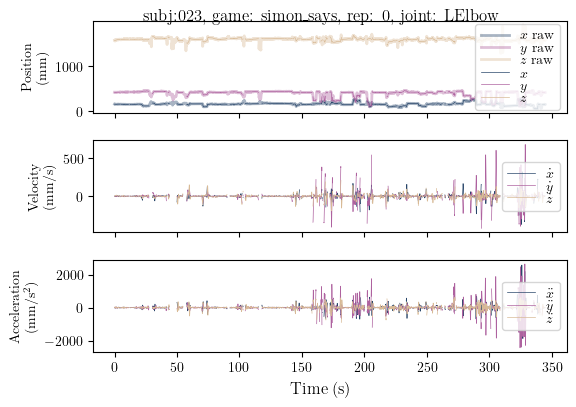

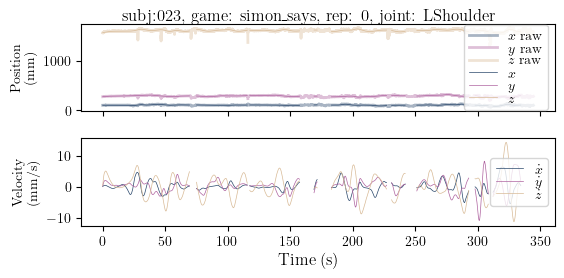

For Subj: 023:
L Arm bbt: -2.56164383561644; age: 4; norm convex hull: 0.32462523686943107; arm length: 273.39179309247305


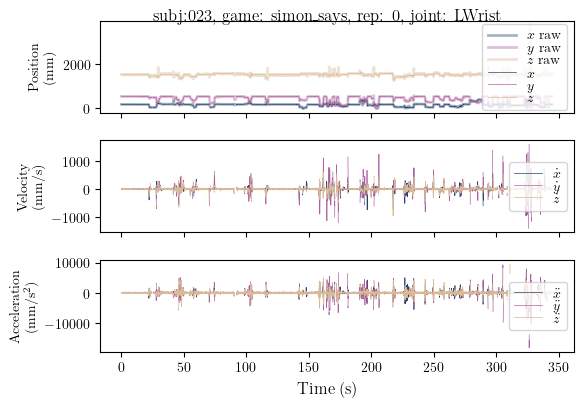

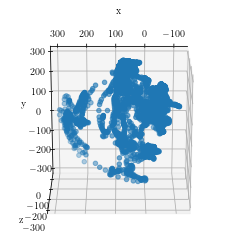

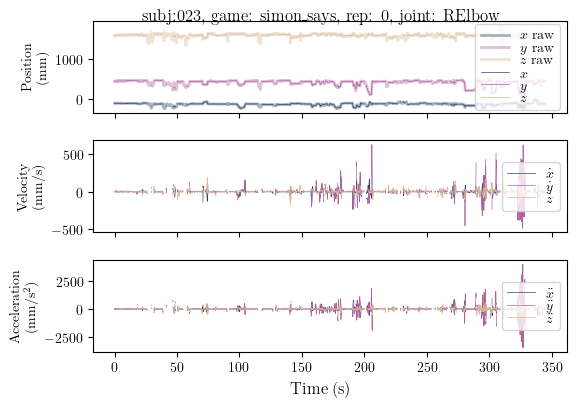

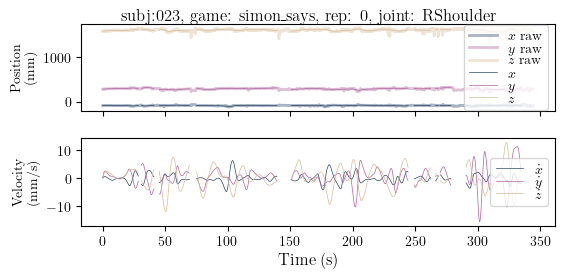

For Subj: 023:
R Arm bbt: -2.56164383561644; age: 4; norm convex hull: 0.3556031598387604; arm length: 276.3057891954995


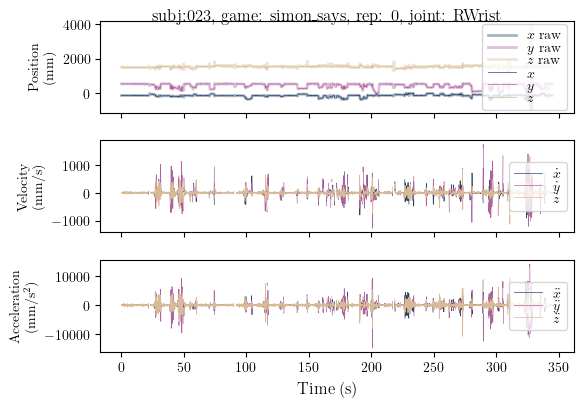

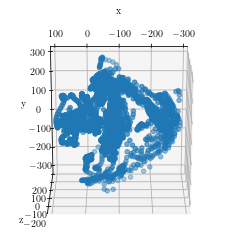

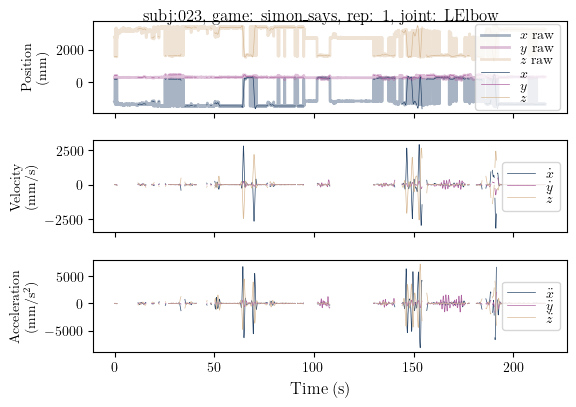

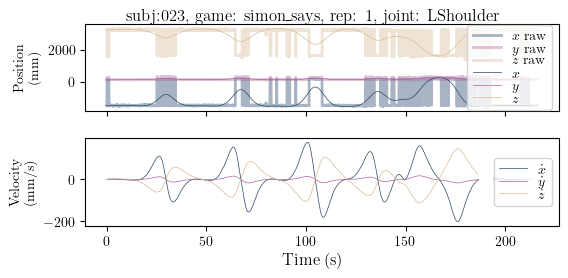

For Subj: 023:
L Arm bbt: -2.56164383561644; age: 4; norm convex hull: 0.10480959315604098; arm length: 940.8328396527189


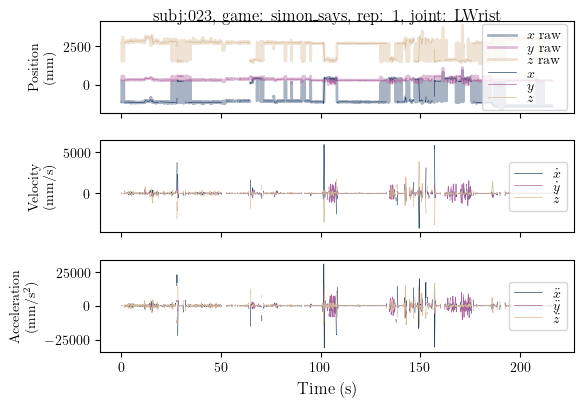

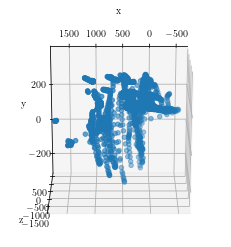

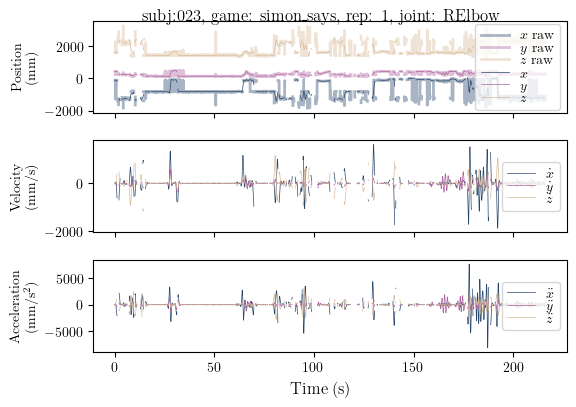

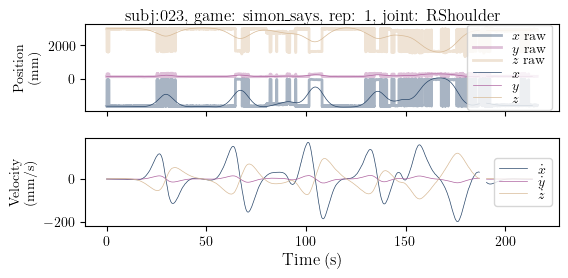

For Subj: 023:
R Arm bbt: -2.56164383561644; age: 4; norm convex hull: 0.03421539276321007; arm length: 1400.6787722975319


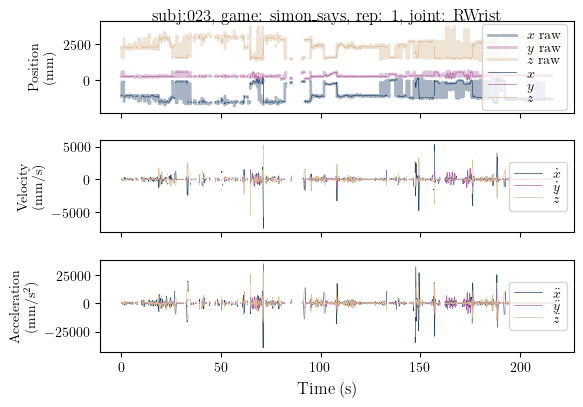

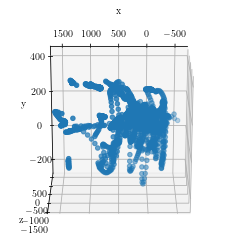

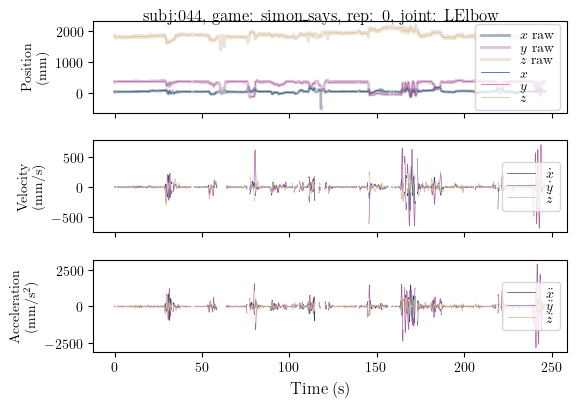

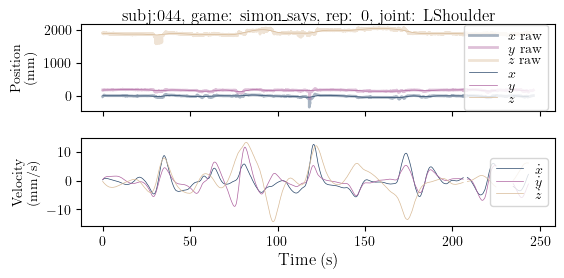

For Subj: 044:
L Arm bbt: -10.1698113207547; age: 7; norm convex hull: 0.4282476201929476; arm length: 411.6009659705479


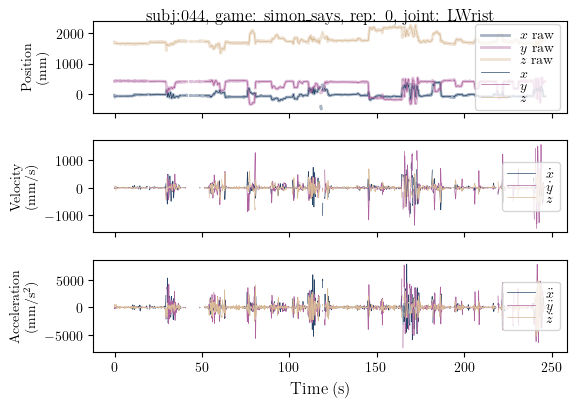

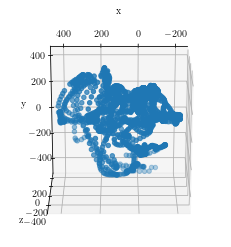

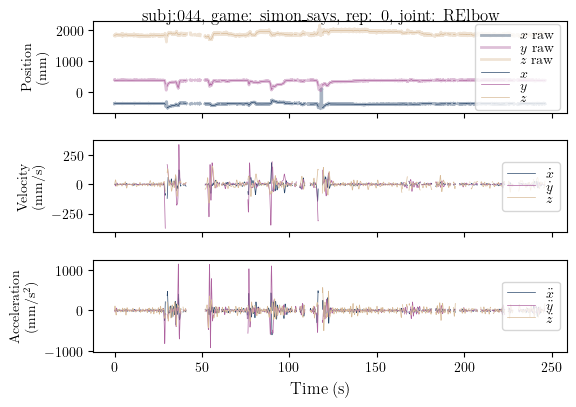

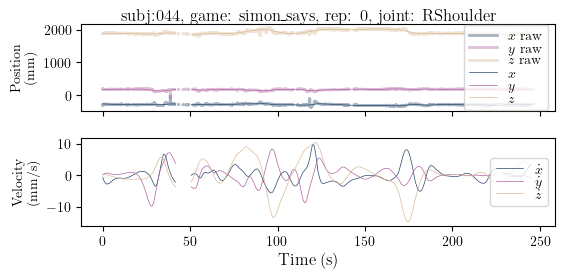

For Subj: 044:
R Arm bbt: -10.1698113207547; age: 7; norm convex hull: 0.04360354991433123; arm length: 433.5466050613857


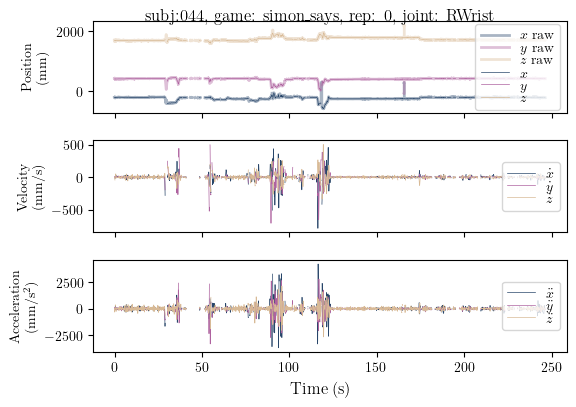

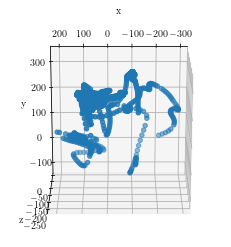

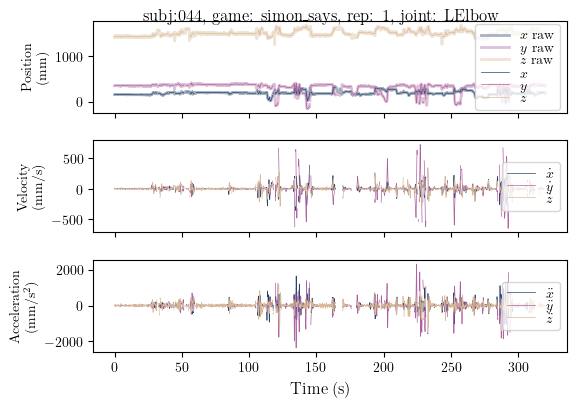

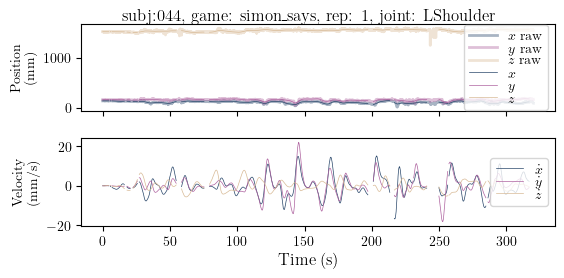

For Subj: 044:
L Arm bbt: -10.1698113207547; age: 7; norm convex hull: 0.40767530047331496; arm length: 415.20137935322


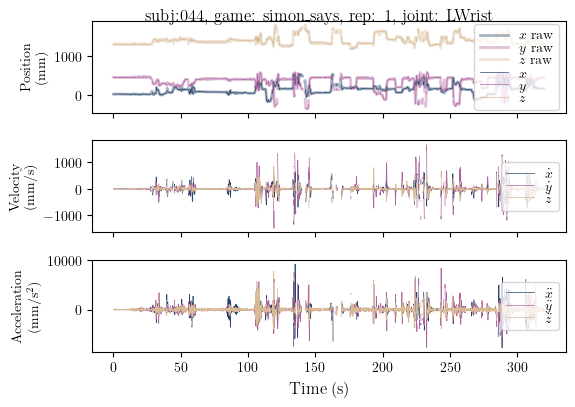

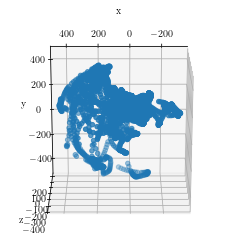

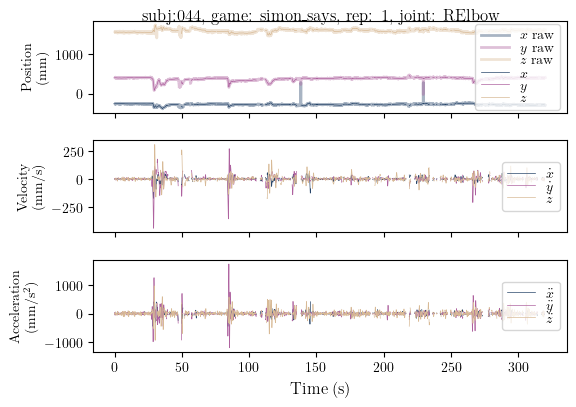

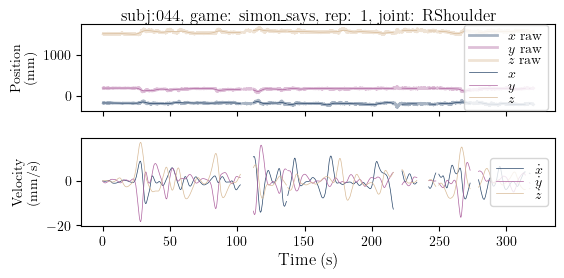

For Subj: 044:
R Arm bbt: -10.1698113207547; age: 7; norm convex hull: 0.038194663347218515; arm length: 432.5325809494768


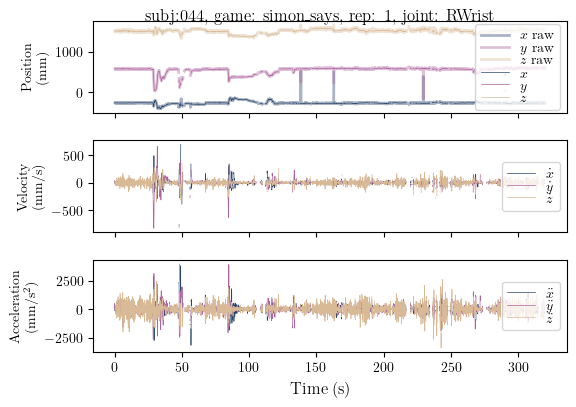

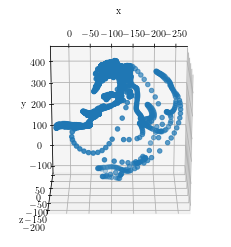

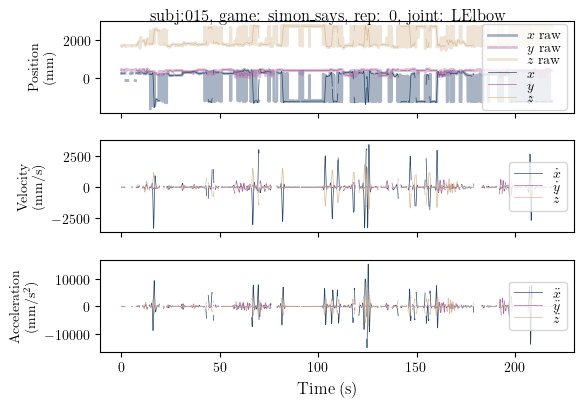

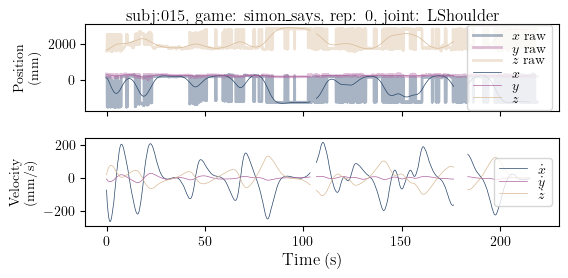

For Subj: 015:
L Arm bbt: 0.507462686567164; age: 5; norm convex hull: 1.3598421274031653; arm length: 514.3248702206399


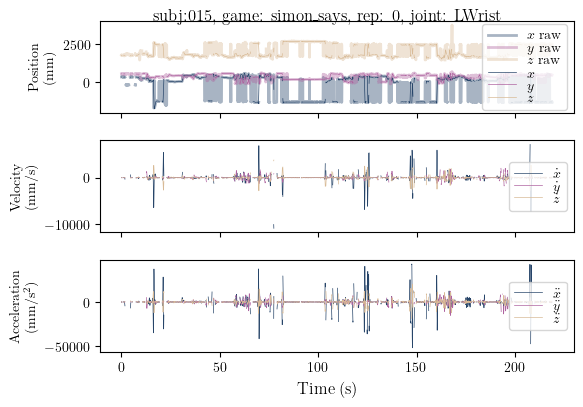

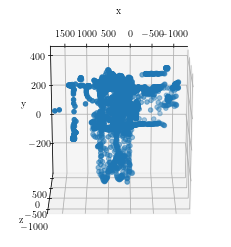

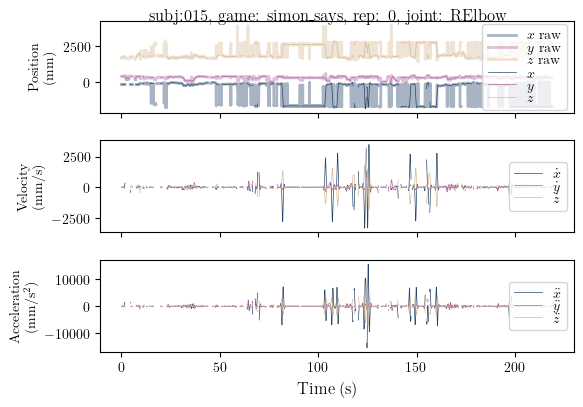

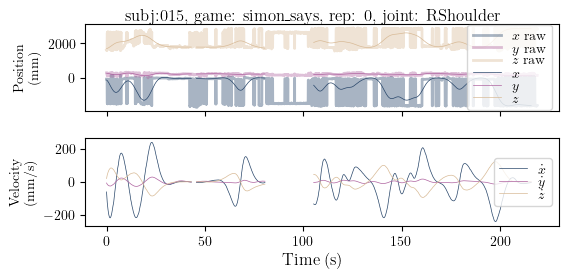

For Subj: 015:
R Arm bbt: 0.507462686567164; age: 5; norm convex hull: 2.1708867687461124; arm length: 438.3109973899752


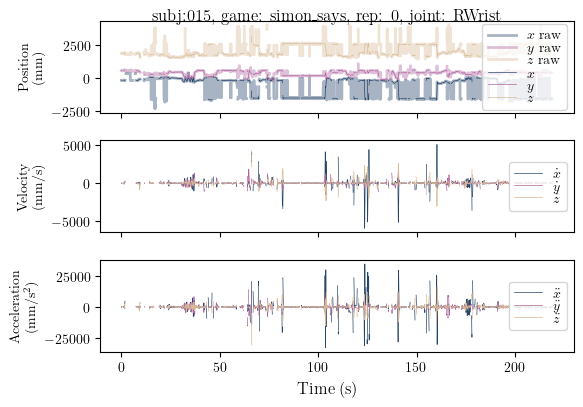

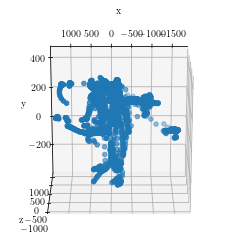

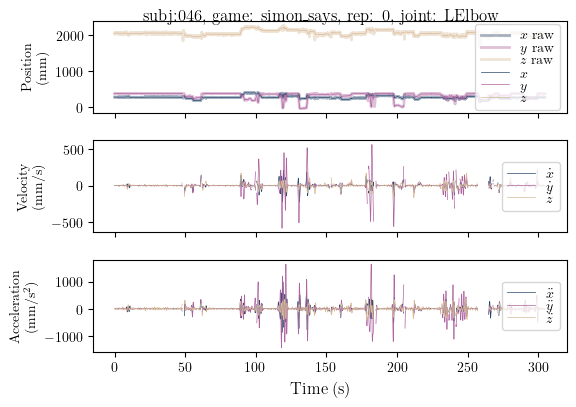

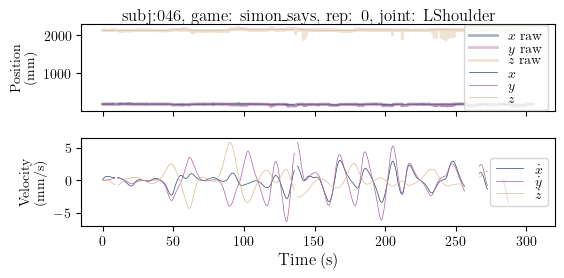

For Subj: 046:
L Arm bbt: -3.71276595744681; age: 18; norm convex hull: 0.3519102582879583; arm length: 409.95511770895746


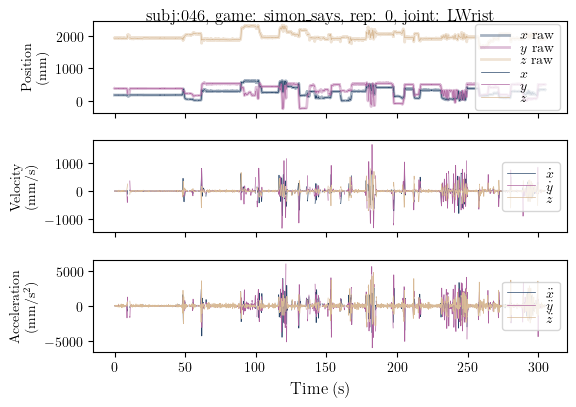

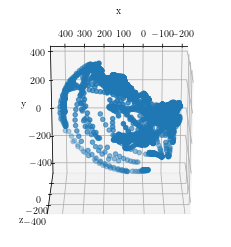

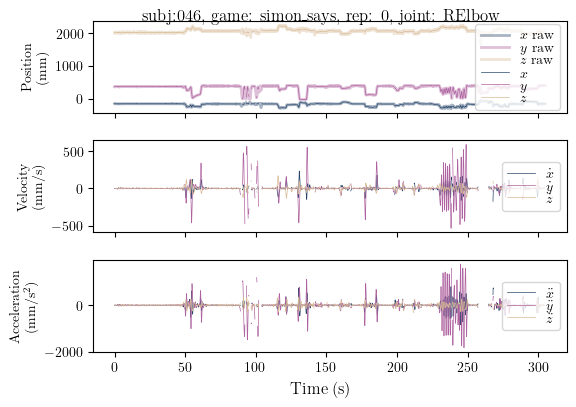

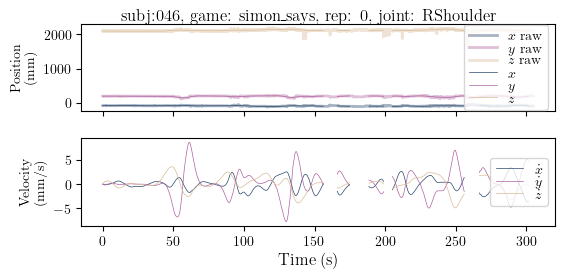

For Subj: 046:
R Arm bbt: -3.71276595744681; age: 18; norm convex hull: 0.33808647494988214; arm length: 414.99420970714425


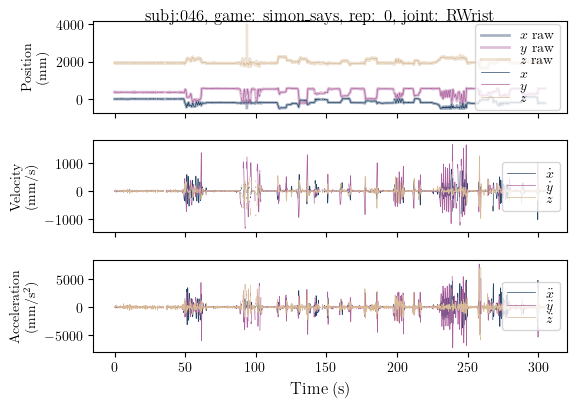

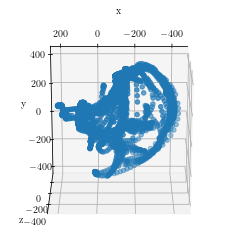

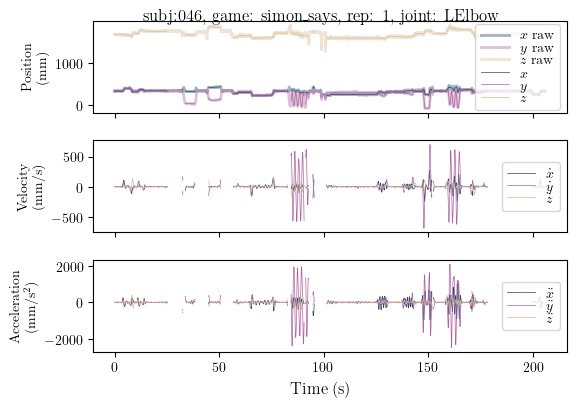

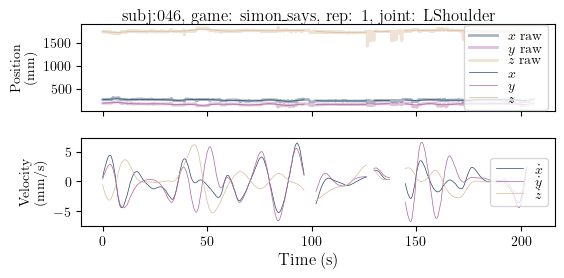

For Subj: 046:
L Arm bbt: -3.71276595744681; age: 18; norm convex hull: 0.31137164518426824; arm length: 407.15770518084486


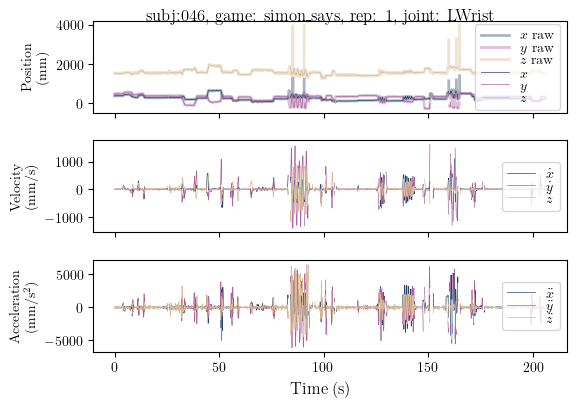

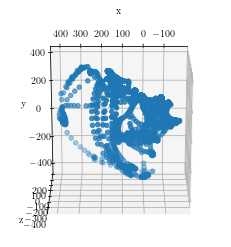

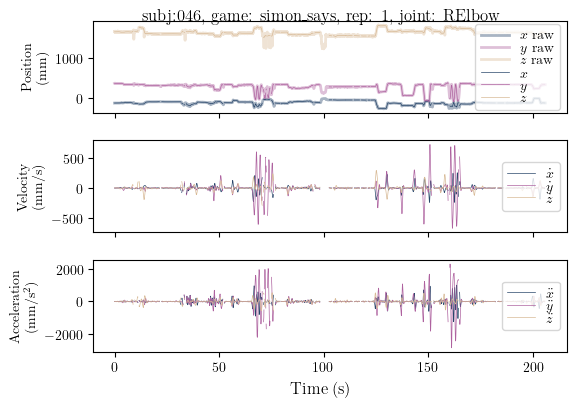

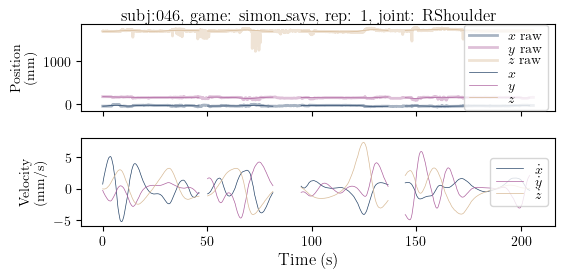

For Subj: 046:
R Arm bbt: -3.71276595744681; age: 18; norm convex hull: 0.3453976556918433; arm length: 401.0786972711402


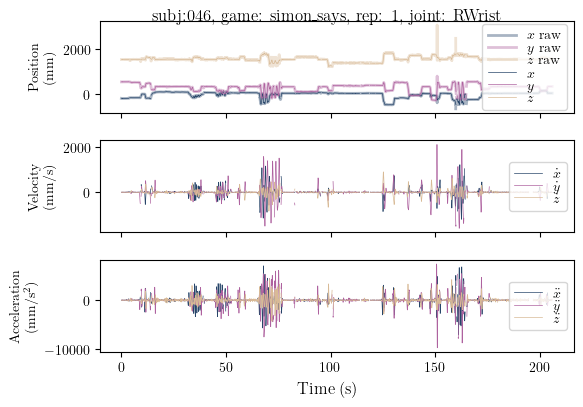

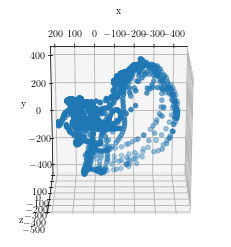

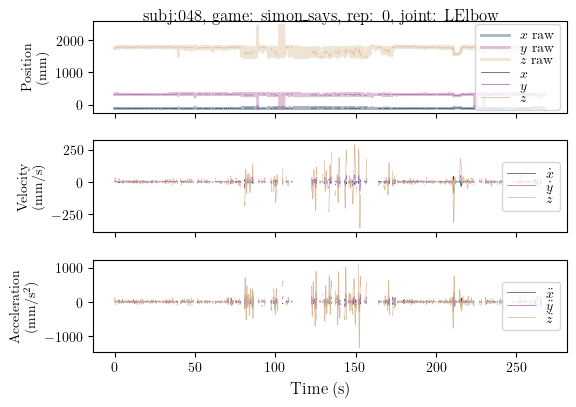

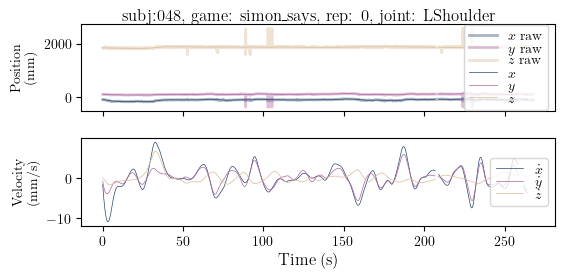

For Subj: 048:
L Arm bbt: -5.24137931034483; age: 15; norm convex hull: 0.006014305178982385; arm length: 438.3412219705791


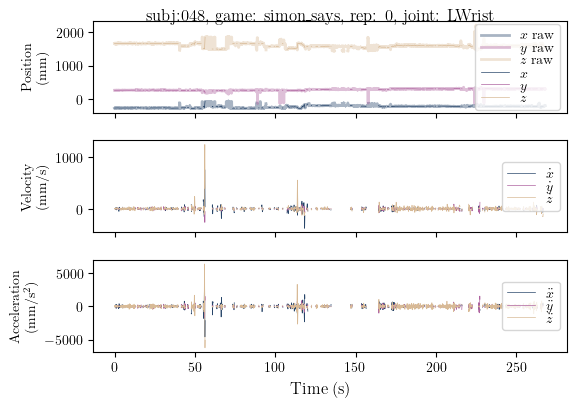

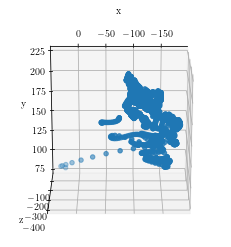

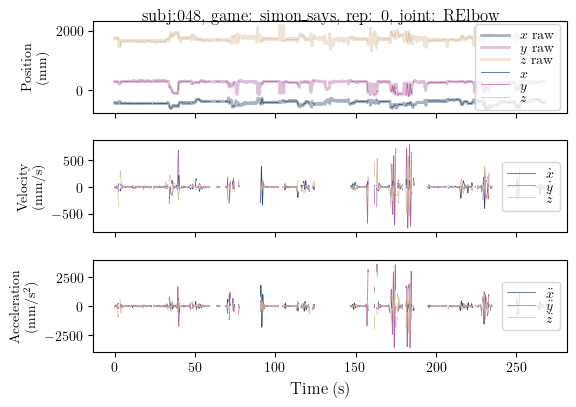

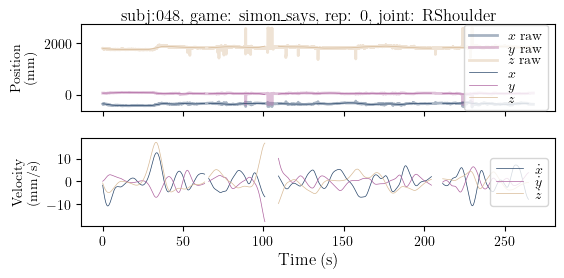

For Subj: 048:
R Arm bbt: -5.24137931034483; age: 15; norm convex hull: 0.2681728618722617; arm length: 462.24386648556924


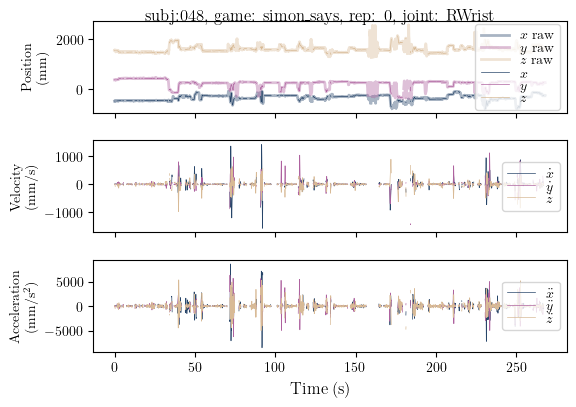

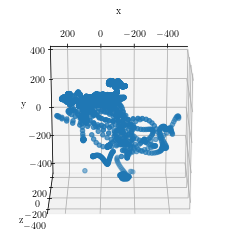

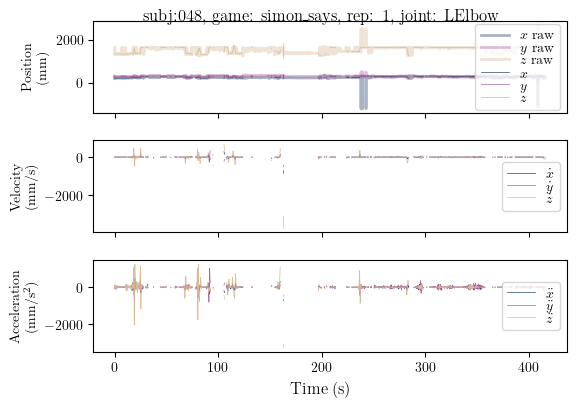

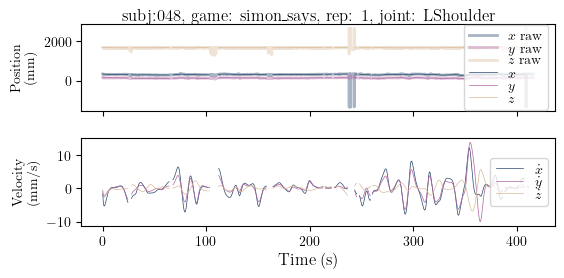

For Subj: 048:
L Arm bbt: -5.24137931034483; age: 15; norm convex hull: 0.06687026134839169; arm length: 244.12686826755268


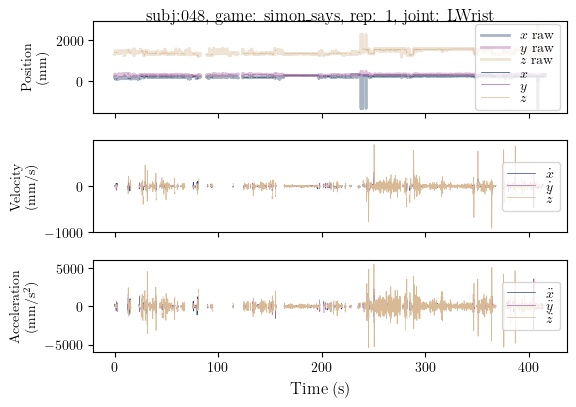

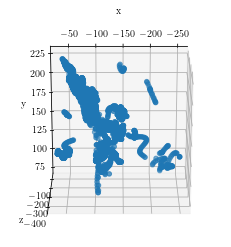

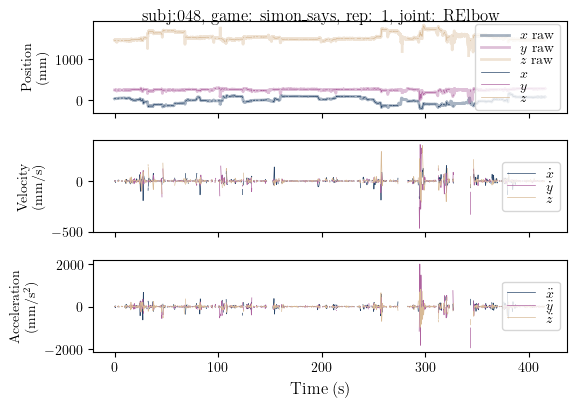

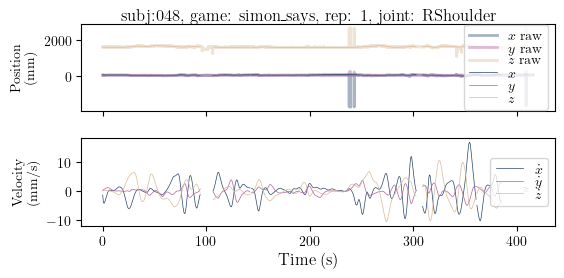

For Subj: 048:
R Arm bbt: -5.24137931034483; age: 15; norm convex hull: 0.24399226347370562; arm length: 444.2337803947318


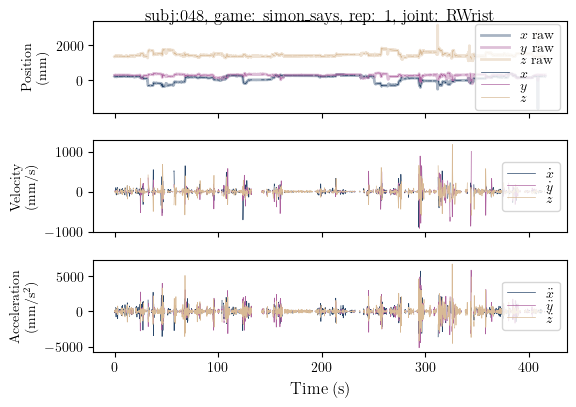

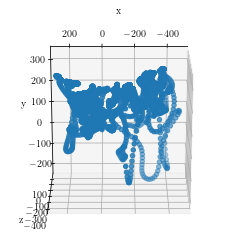

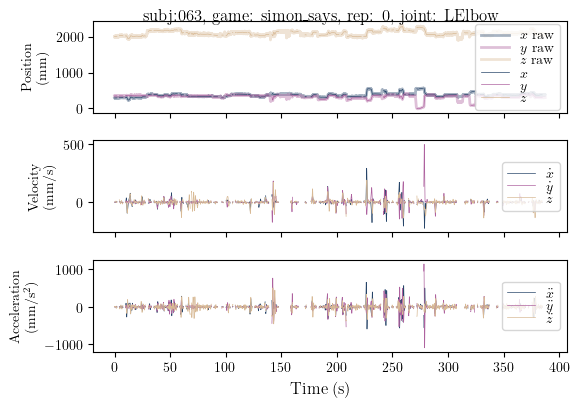

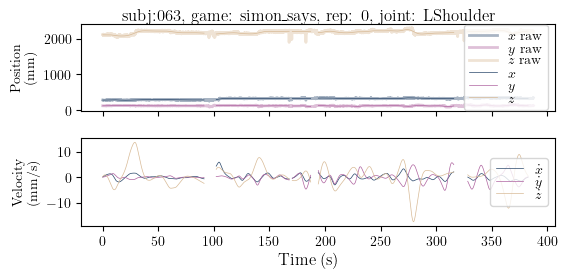

For Subj: 063:
L Arm bbt: -4.7816091954023; age: 14; norm convex hull: 0.19269079434805747; arm length: 486.20988138913276


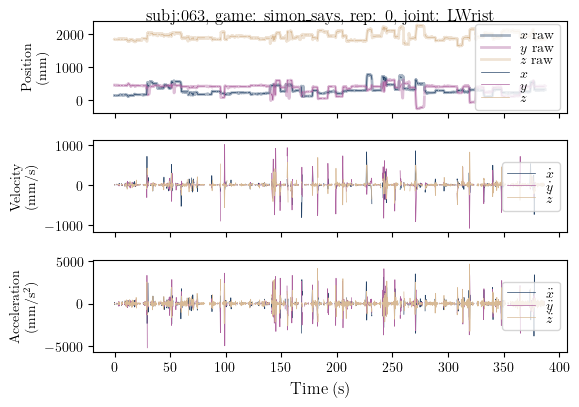

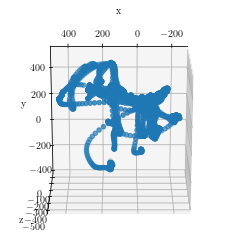

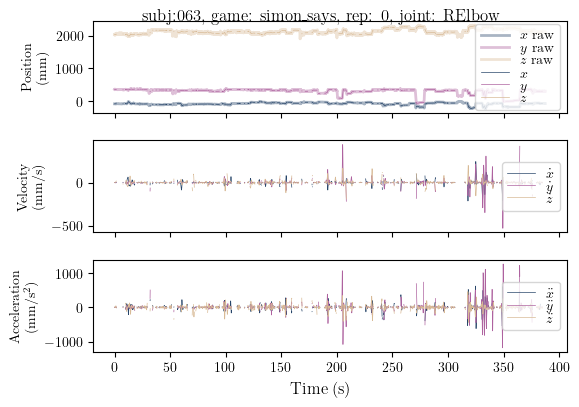

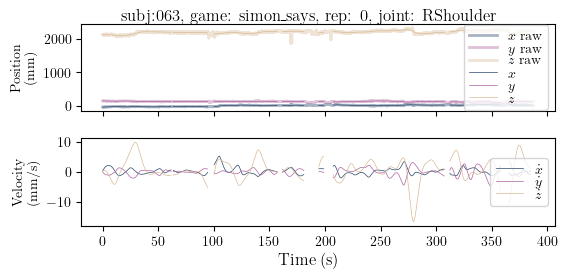

For Subj: 063:
R Arm bbt: -4.7816091954023; age: 14; norm convex hull: 0.21969797537278044; arm length: 475.585259805129


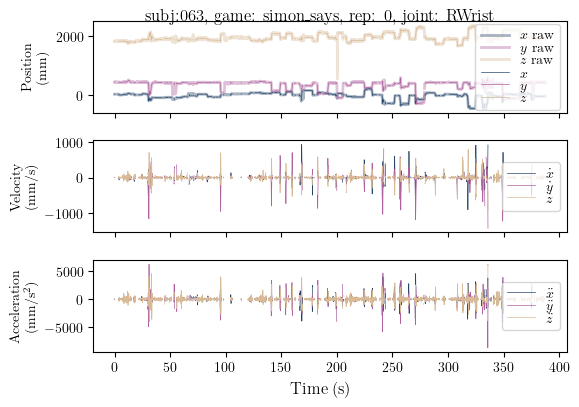

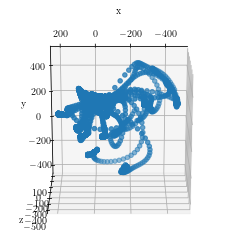

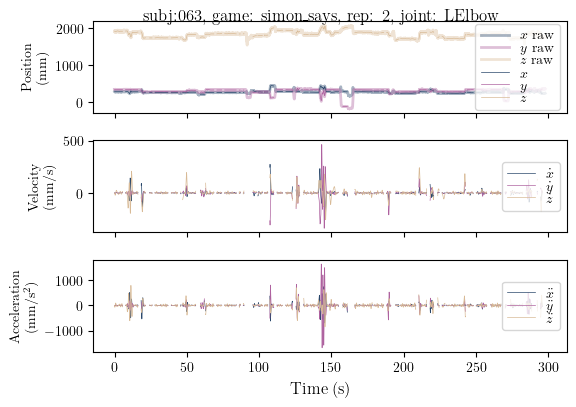

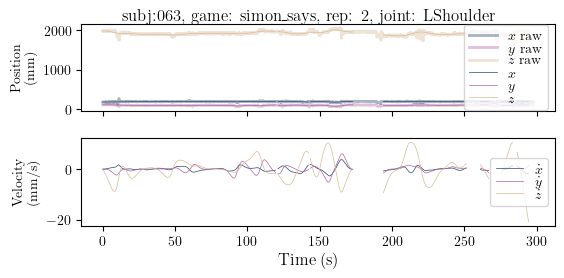

For Subj: 063:
L Arm bbt: -4.7816091954023; age: 14; norm convex hull: 0.19469191628628696; arm length: 467.3053211383536


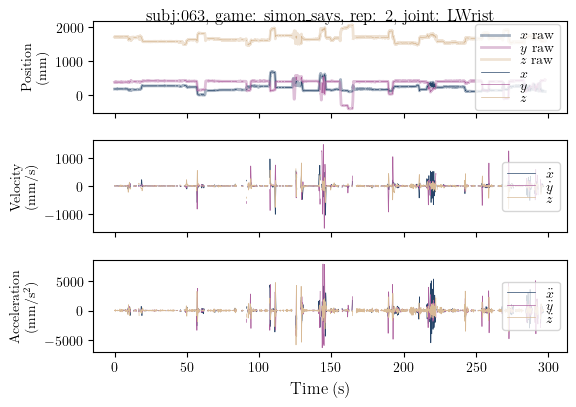

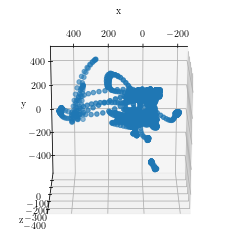

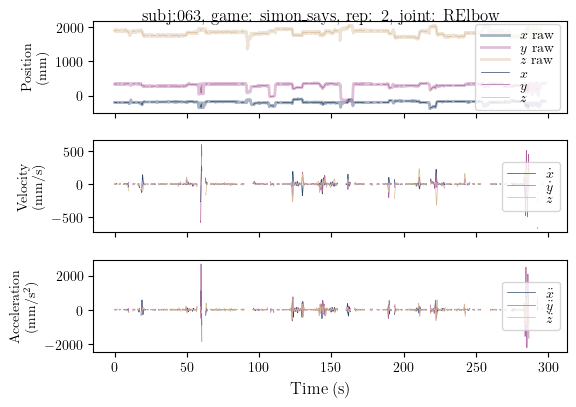

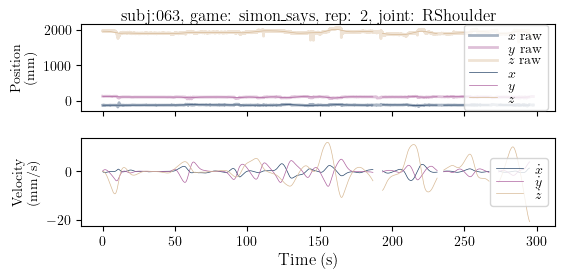

For Subj: 063:
R Arm bbt: -4.7816091954023; age: 14; norm convex hull: 0.2587257308761734; arm length: 473.77359030974833


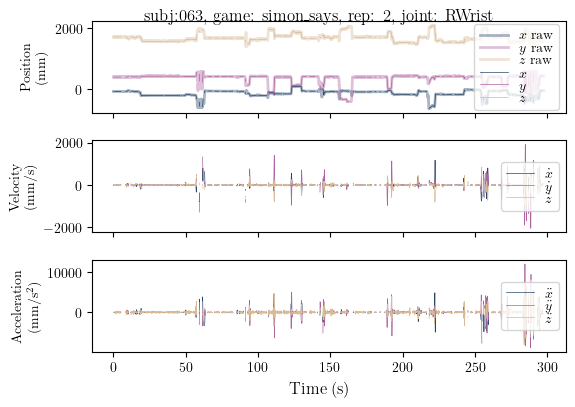

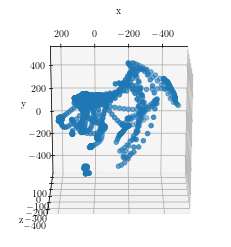

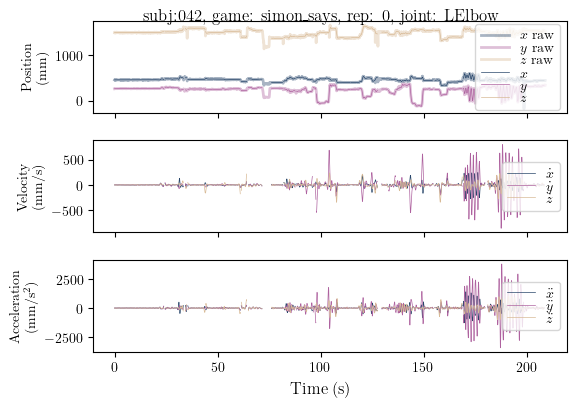

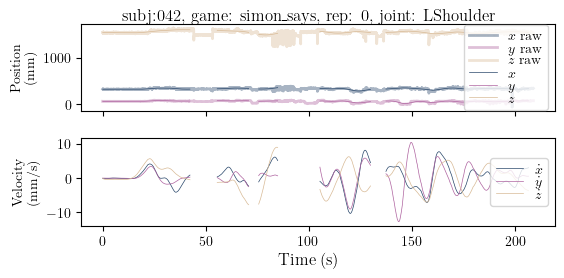

For Subj: 042:
L Arm bbt: -2.43617021276596; age: 19; norm convex hull: 0.32536665151916216; arm length: 467.3752559011207


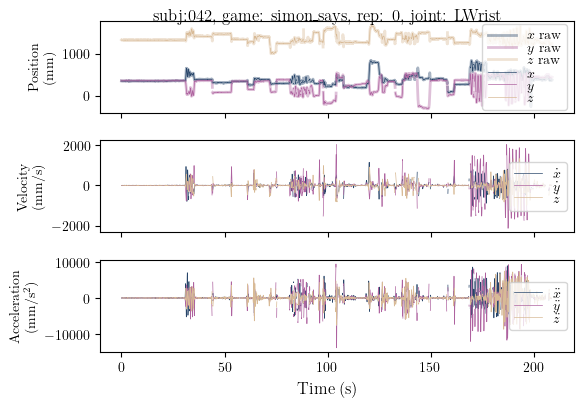

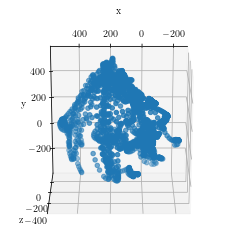

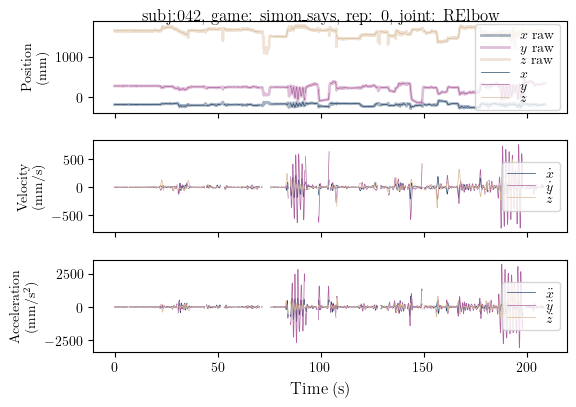

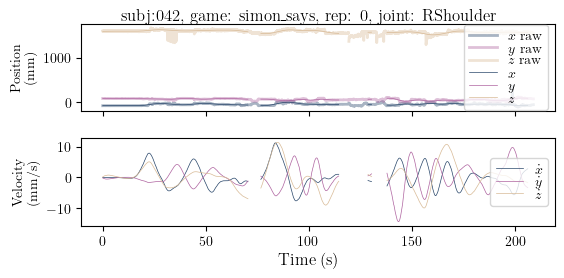

For Subj: 042:
R Arm bbt: -2.43617021276596; age: 19; norm convex hull: 0.35286249695561317; arm length: 441.4201992225204


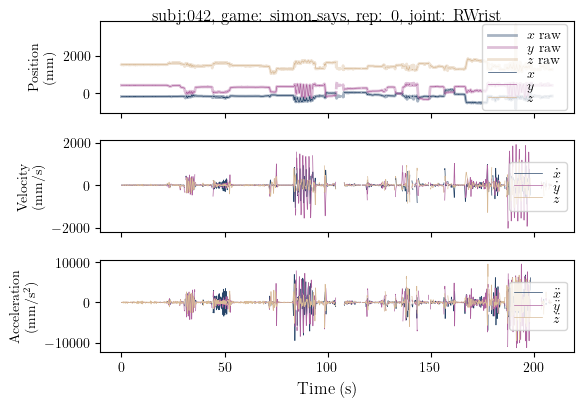

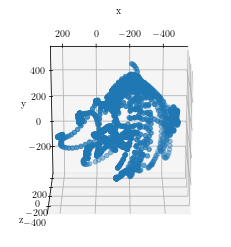

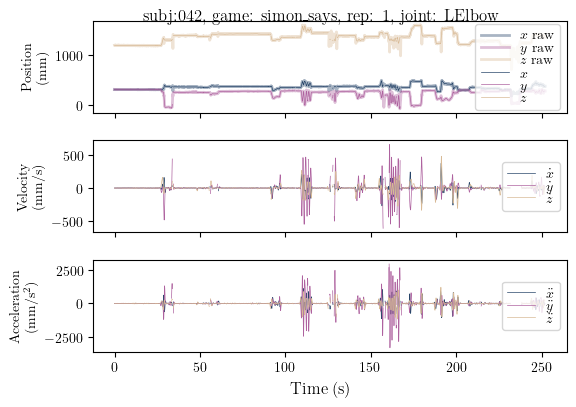

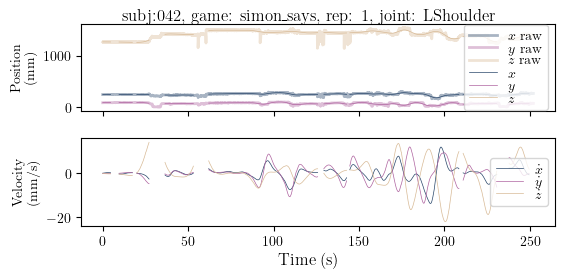

For Subj: 042:
L Arm bbt: -2.43617021276596; age: 19; norm convex hull: 0.35675595451710684; arm length: 459.5413124044794


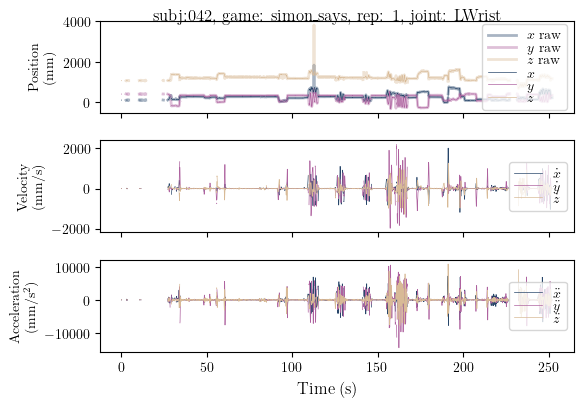

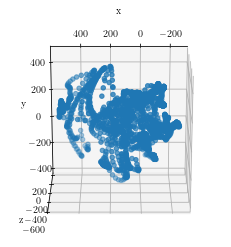

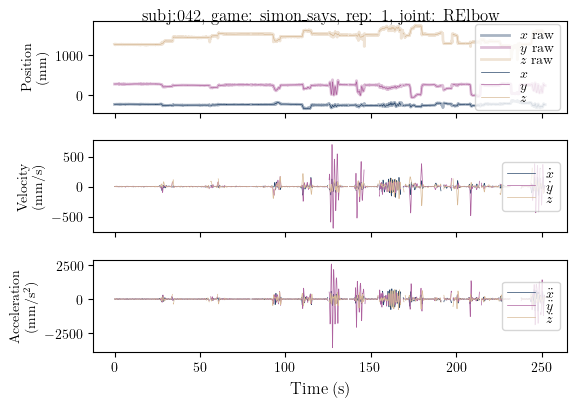

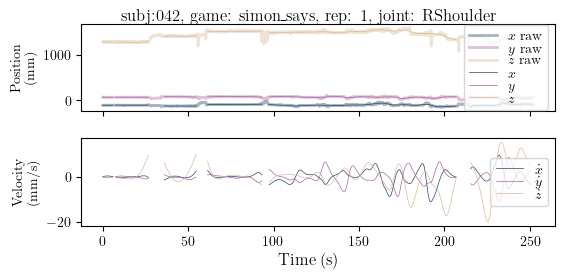

For Subj: 042:
R Arm bbt: -2.43617021276596; age: 19; norm convex hull: 0.3047383836906924; arm length: 447.1162555641443


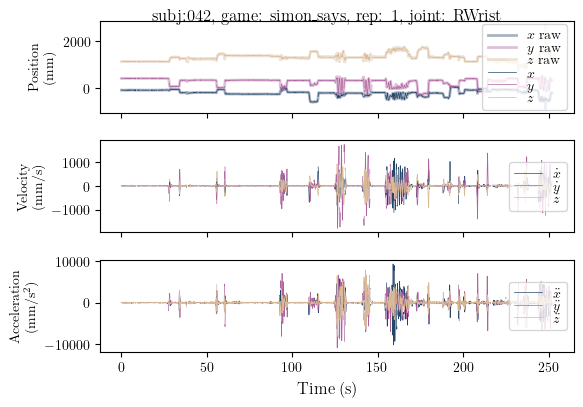

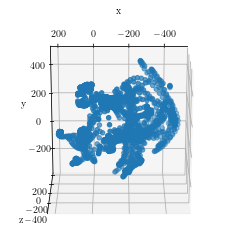

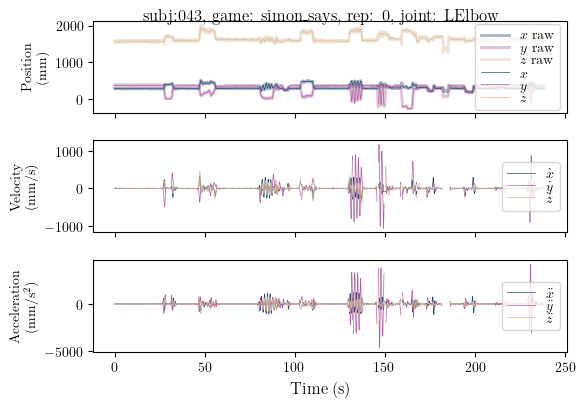

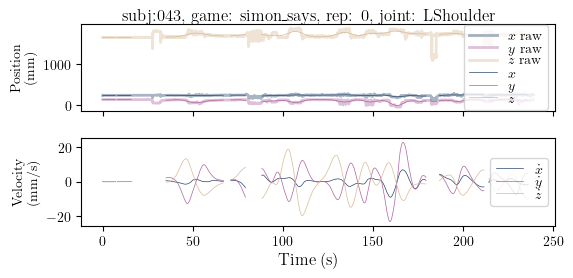

For Subj: 043:
L Arm bbt: -2.94252873563218; age: 14; norm convex hull: 0.26501643930934865; arm length: 505.1403842167582


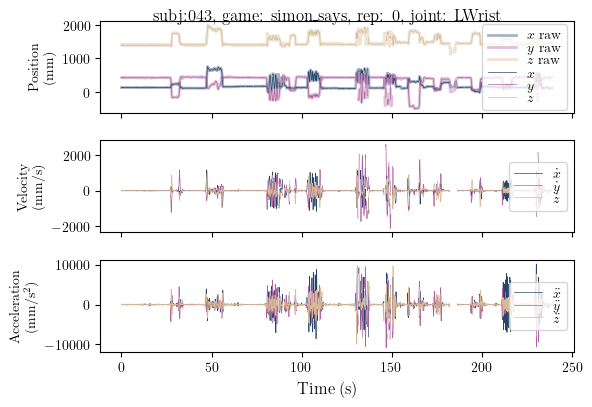

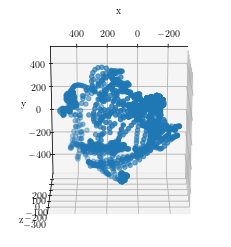

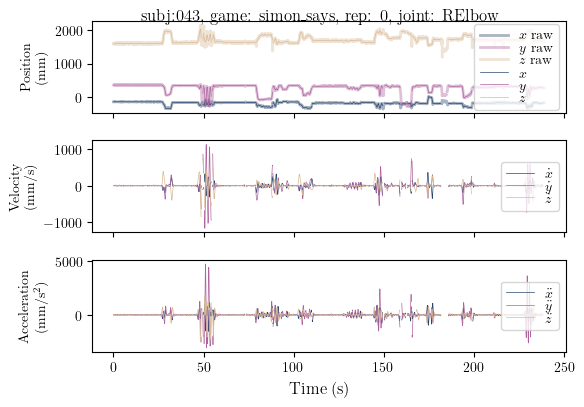

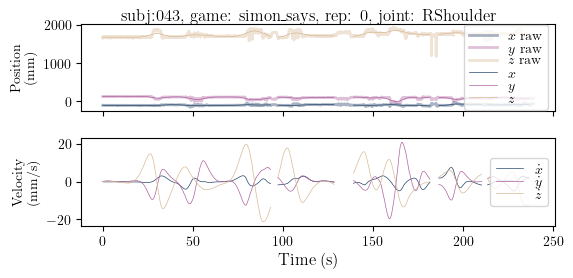

For Subj: 043:
R Arm bbt: -2.94252873563218; age: 14; norm convex hull: 0.5015549444290067; arm length: 489.17375125942726


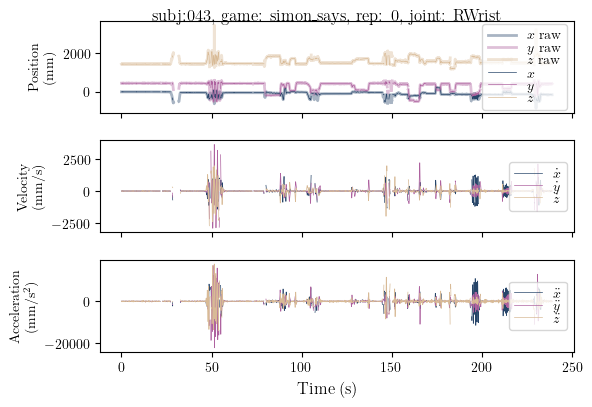

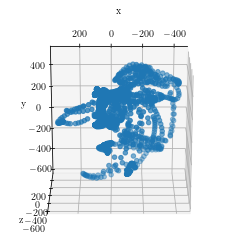

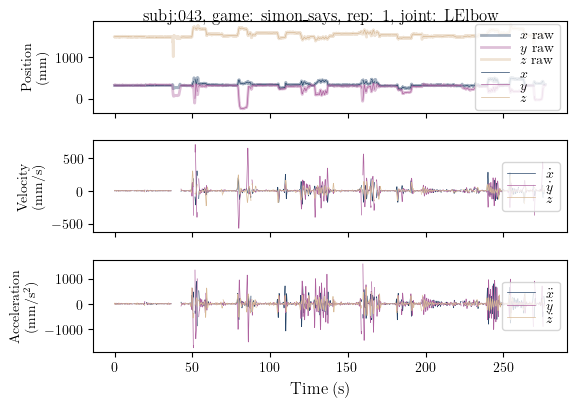

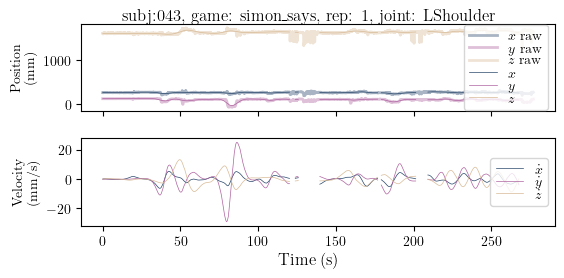

For Subj: 043:
L Arm bbt: -2.94252873563218; age: 14; norm convex hull: 0.2754152400395658; arm length: 470.3774450008302


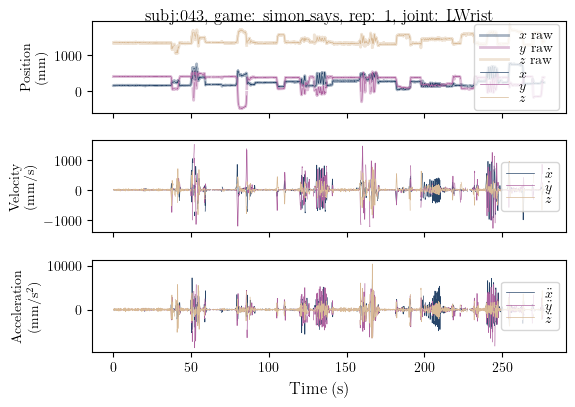

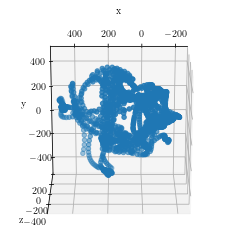

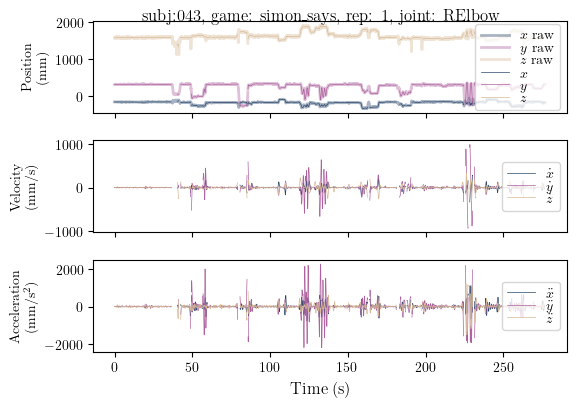

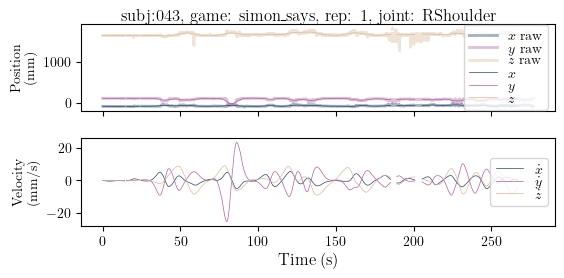

For Subj: 043:
R Arm bbt: -2.94252873563218; age: 14; norm convex hull: 0.37837535651746046; arm length: 482.3641724693414


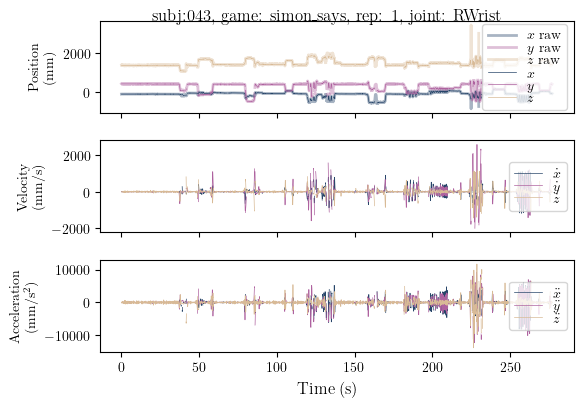

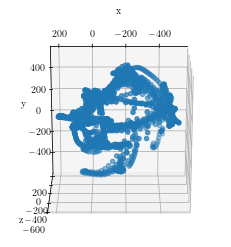

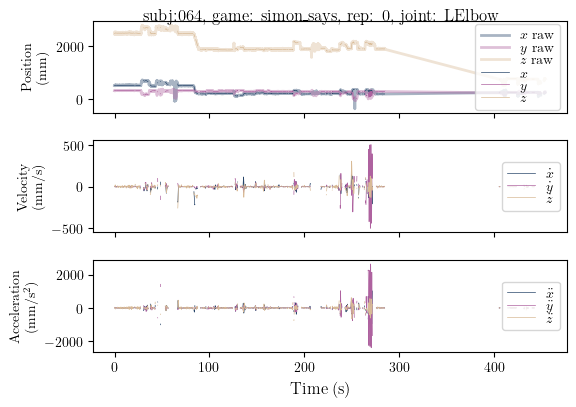

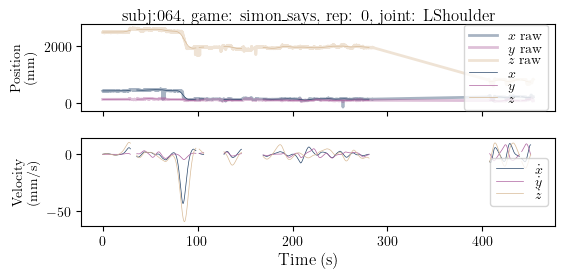

For Subj: 064:
L Arm bbt: -2.48192771084337; age: 13; norm convex hull: 0.22827815869982027; arm length: 445.9409534093825


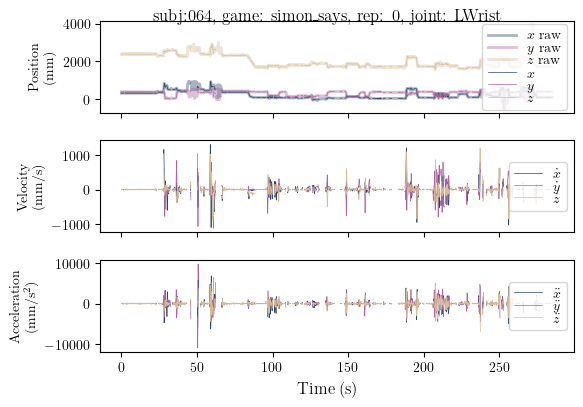

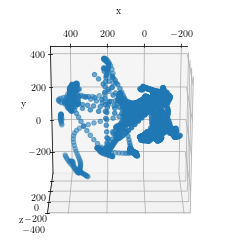

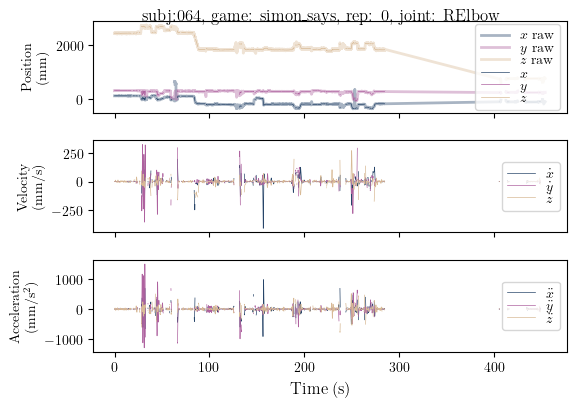

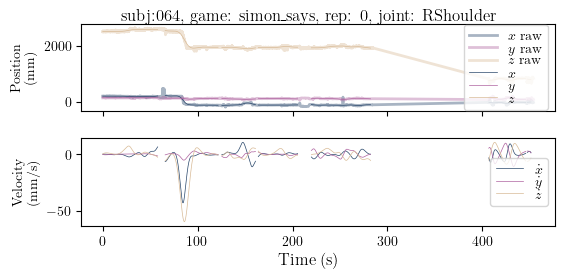

For Subj: 064:
R Arm bbt: -2.48192771084337; age: 13; norm convex hull: 0.2393022436434492; arm length: 428.25076146963954


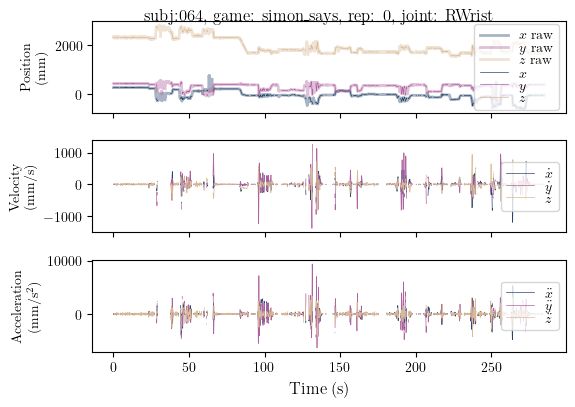

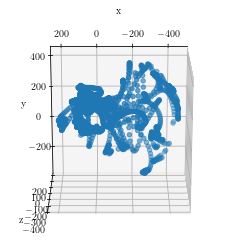

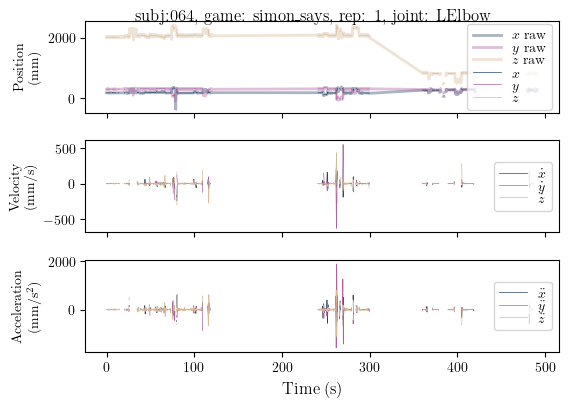

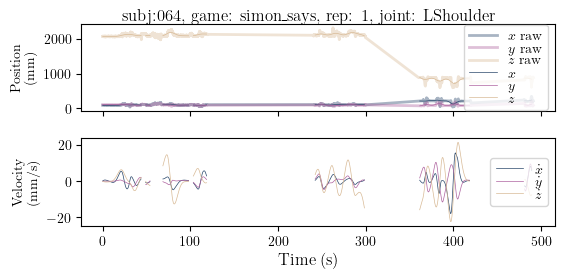

For Subj: 064:
L Arm bbt: -2.48192771084337; age: 13; norm convex hull: 0.27606946439940006; arm length: 431.71092849520517


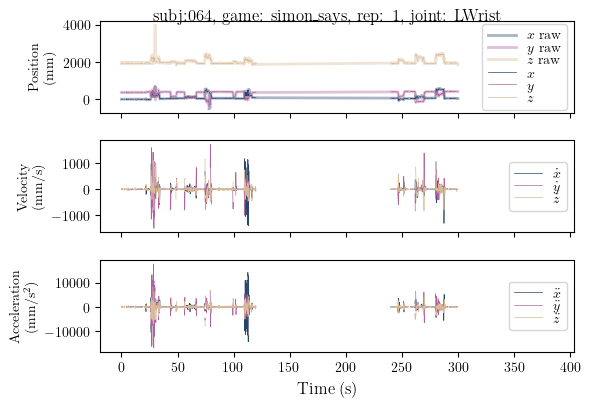

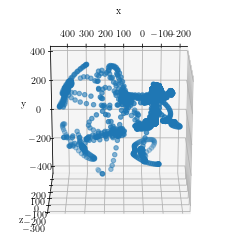

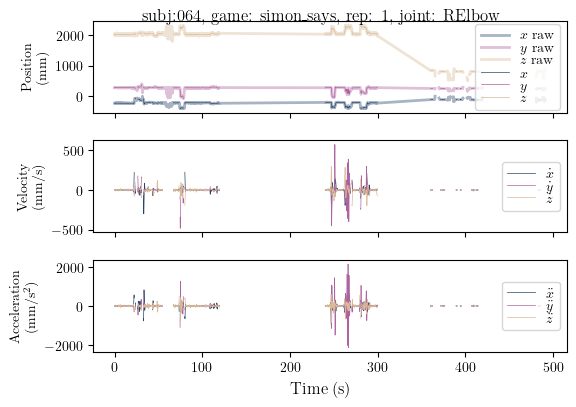

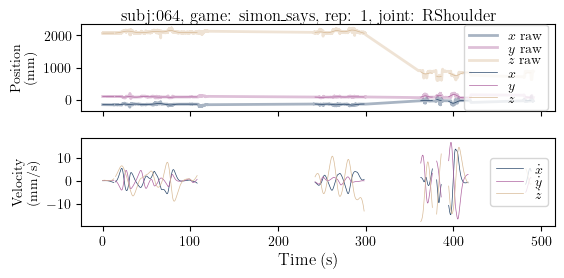

For Subj: 064:
R Arm bbt: -2.48192771084337; age: 13; norm convex hull: 0.3355148525983183; arm length: 437.359022498012


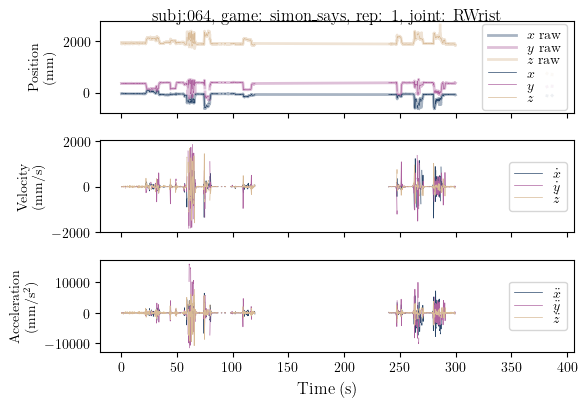

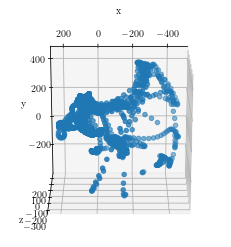

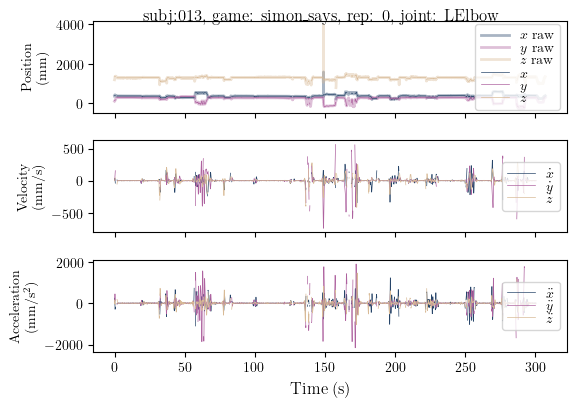

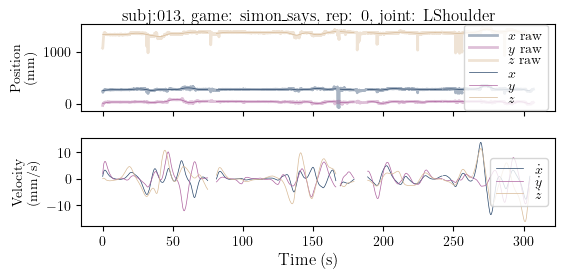

For Subj: 013:
L Arm bbt: -4.80681818181818; age: 62; norm convex hull: 0.2269765400433982; arm length: 527.715103560681


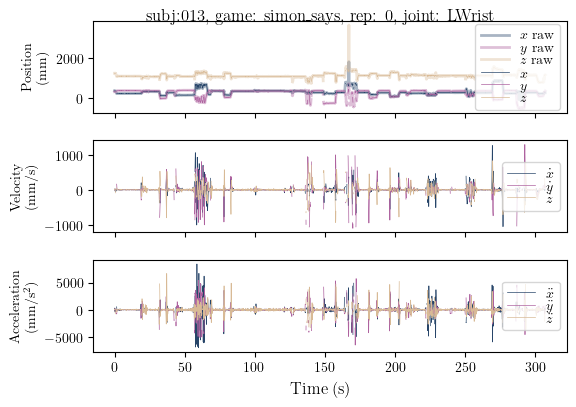

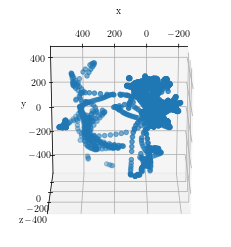

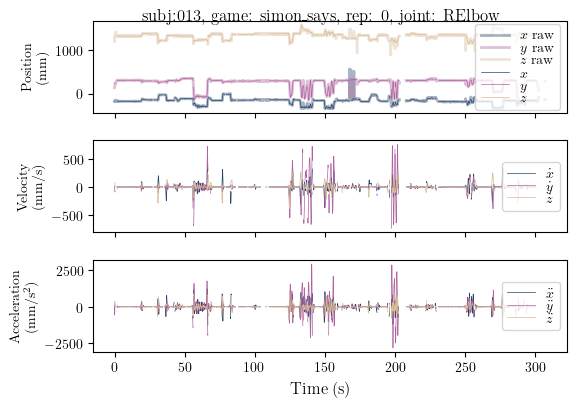

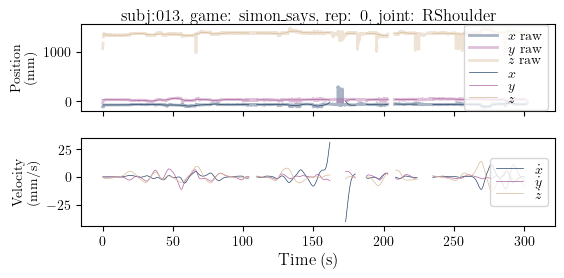

For Subj: 013:
R Arm bbt: -4.80681818181818; age: 62; norm convex hull: 0.26963139264506986; arm length: 541.7946921053771


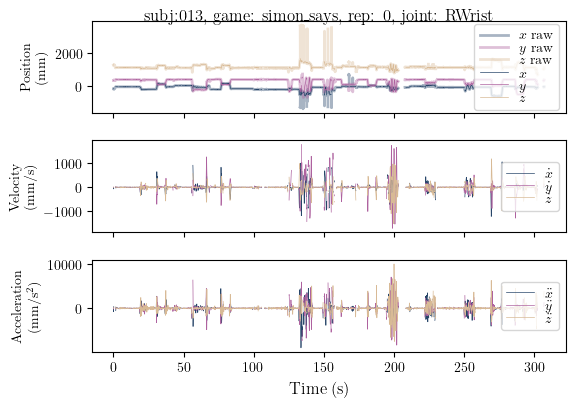

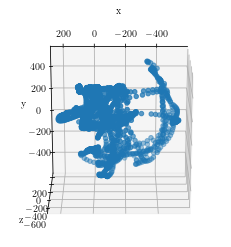

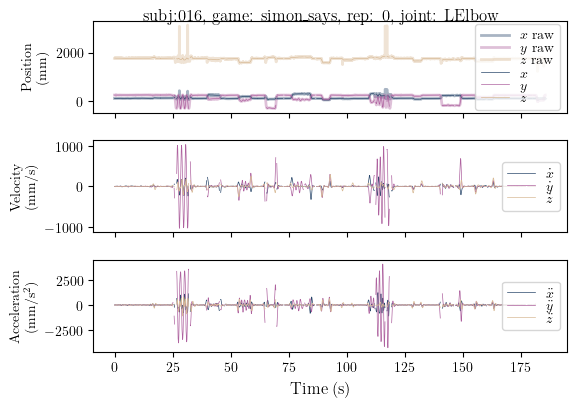

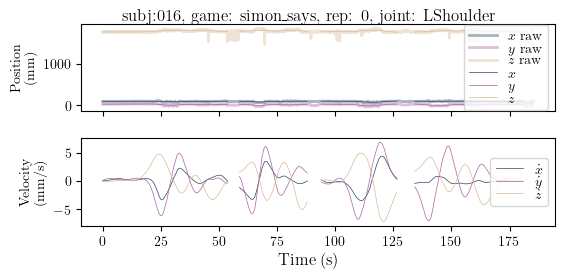

For Subj: 016:
L Arm bbt: -5.16216216216216; age: 30; norm convex hull: 0.3520900809134531; arm length: 445.9738633643719


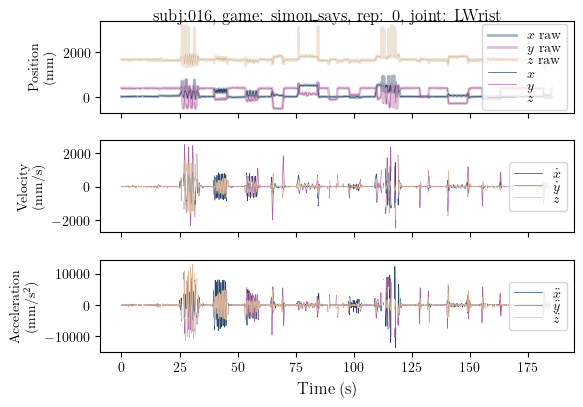

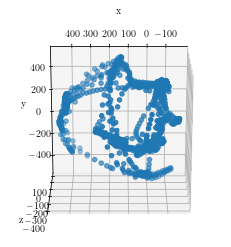

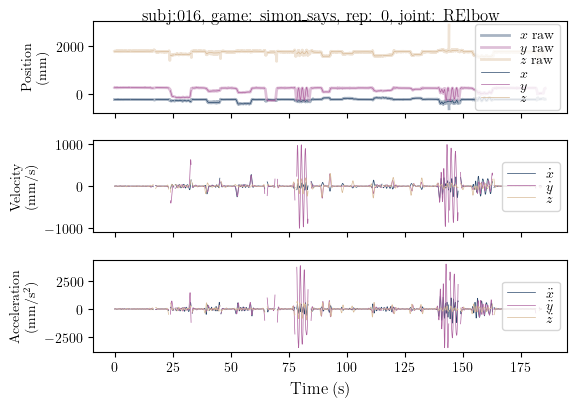

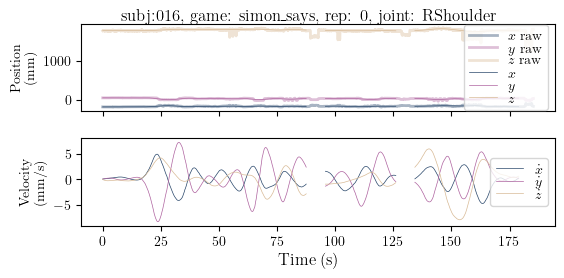

For Subj: 016:
R Arm bbt: -5.16216216216216; age: 30; norm convex hull: 0.290316570581659; arm length: 451.2504701133297


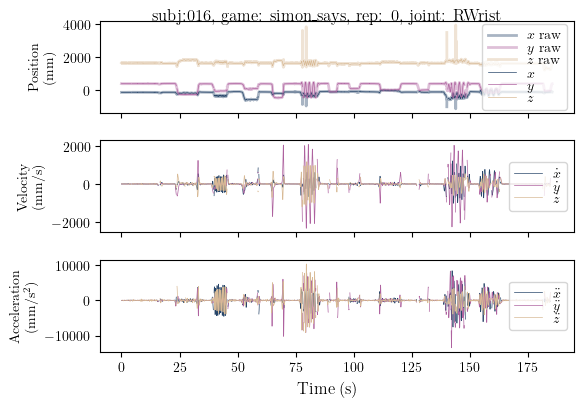

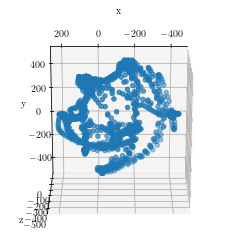

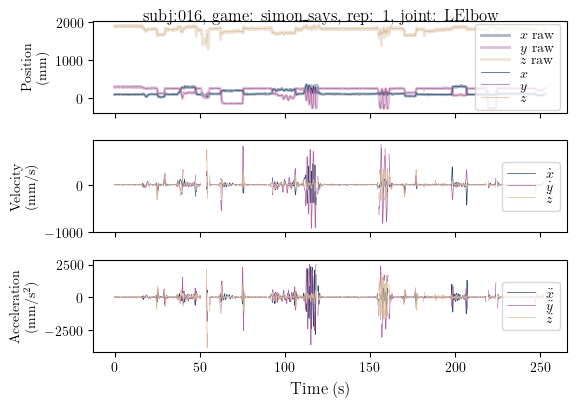

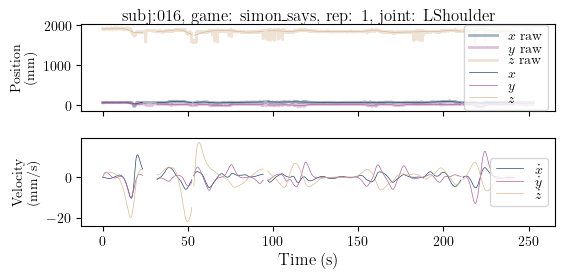

For Subj: 016:
L Arm bbt: -5.16216216216216; age: 30; norm convex hull: 0.39579496624113536; arm length: 443.01851858296754


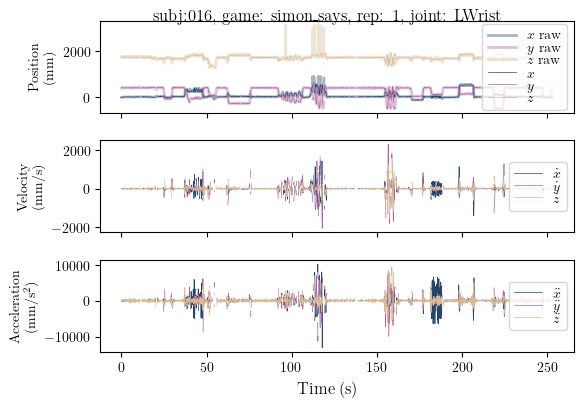

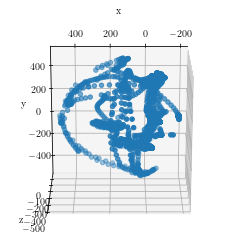

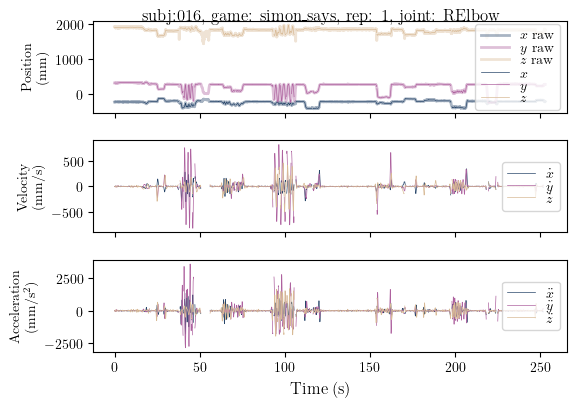

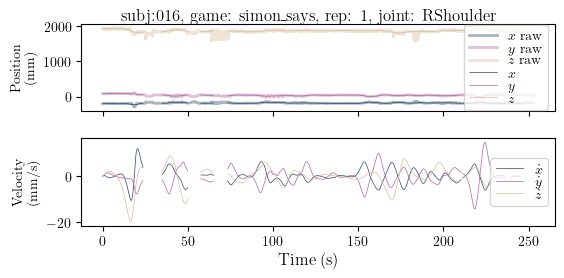

For Subj: 016:
R Arm bbt: -5.16216216216216; age: 30; norm convex hull: 0.28176579141388713; arm length: 454.0706840143625


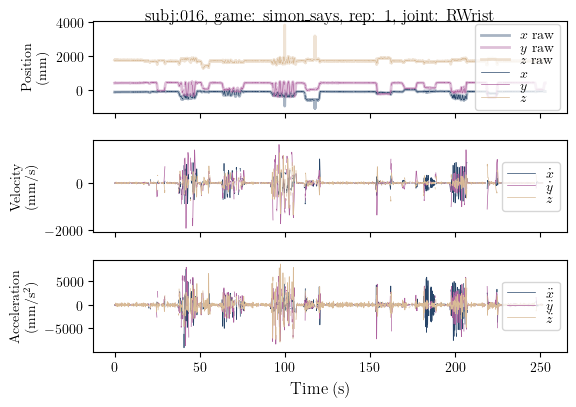

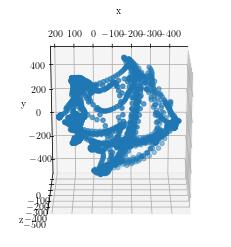

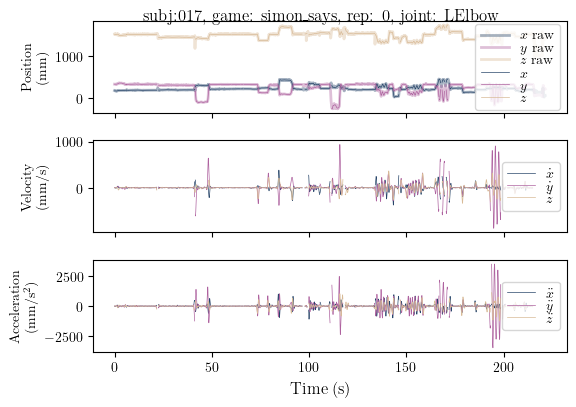

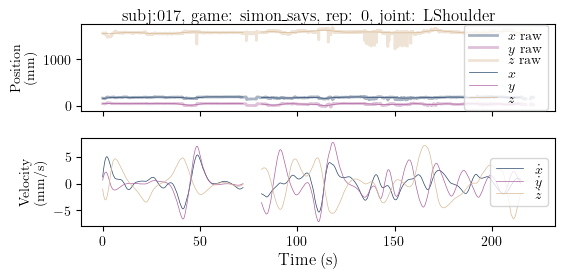

For Subj: 017:
L Arm bbt: -3.40540540540541; age: 34; norm convex hull: 0.33156990536220693; arm length: 512.0292778744259


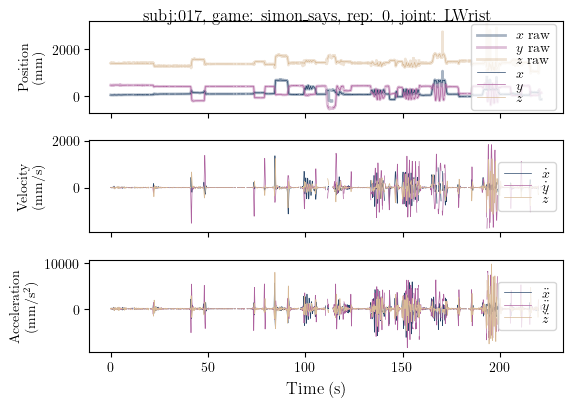

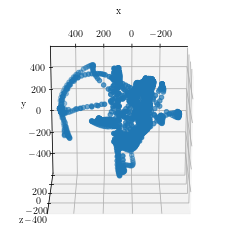

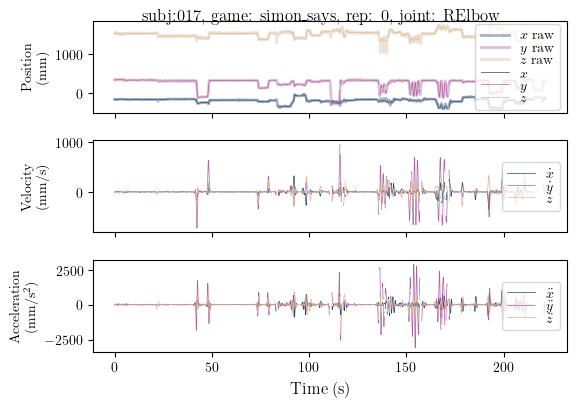

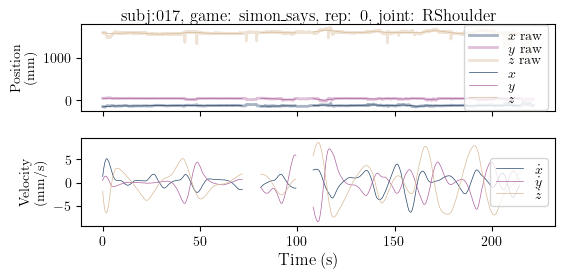

For Subj: 017:
R Arm bbt: -3.40540540540541; age: 34; norm convex hull: 0.3309771920115894; arm length: 529.8917944689156


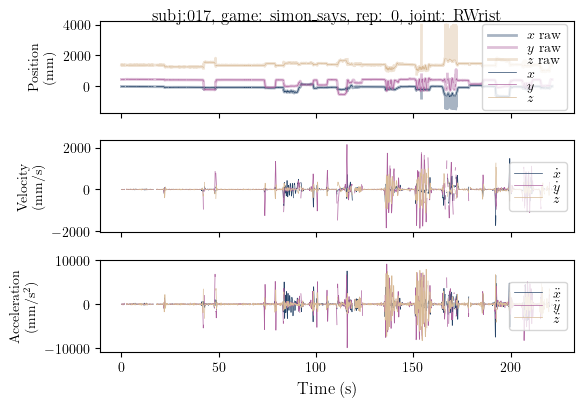

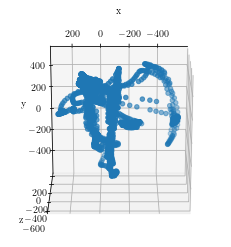

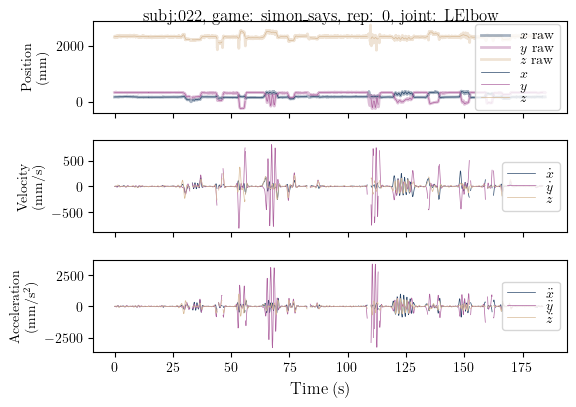

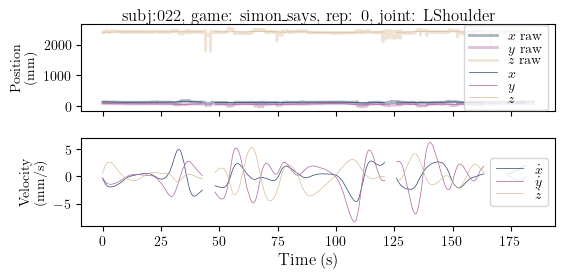

For Subj: 022:
L Arm bbt: -1.05681818181818; age: 64; norm convex hull: 0.3198185005094757; arm length: 520.8520575922842


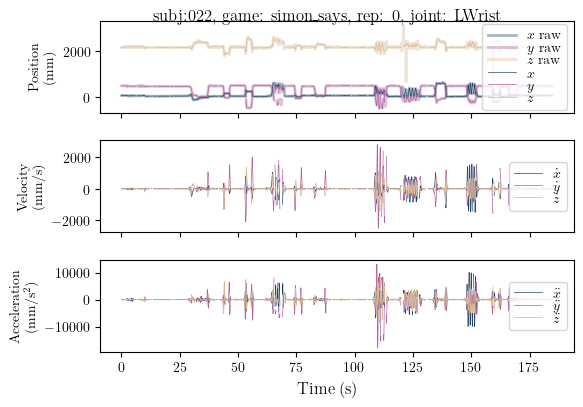

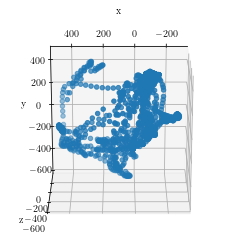

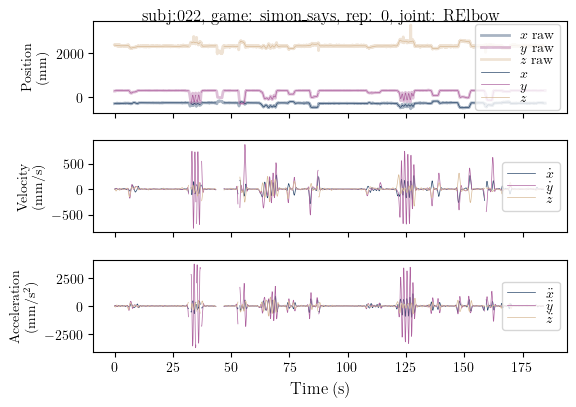

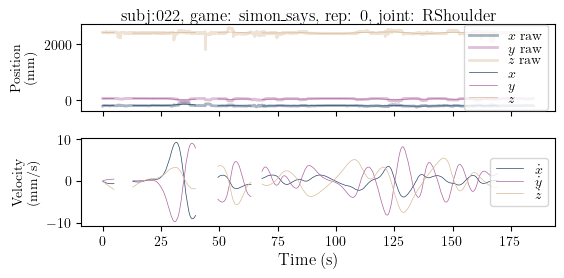

For Subj: 022:
R Arm bbt: -1.05681818181818; age: 64; norm convex hull: 0.5577831974167706; arm length: 536.6369627097422


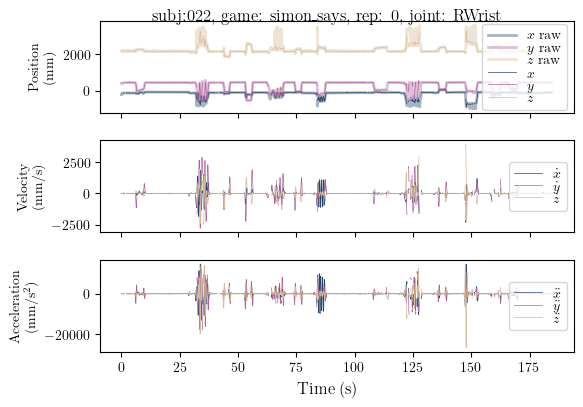

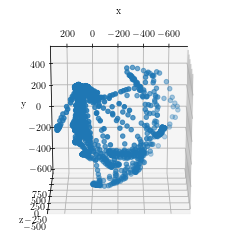

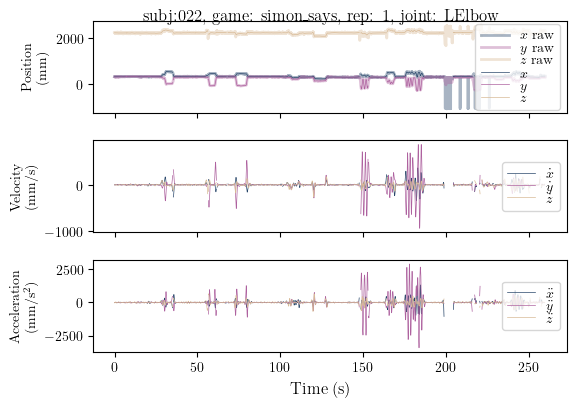

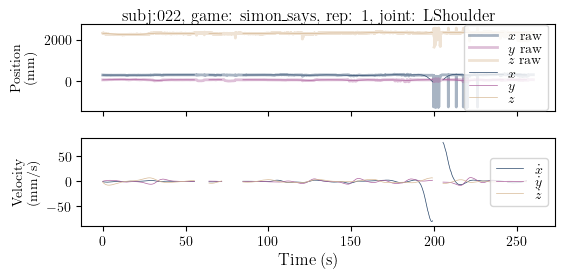

For Subj: 022:
L Arm bbt: -1.05681818181818; age: 64; norm convex hull: 0.26306693890710053; arm length: 530.2681196869472


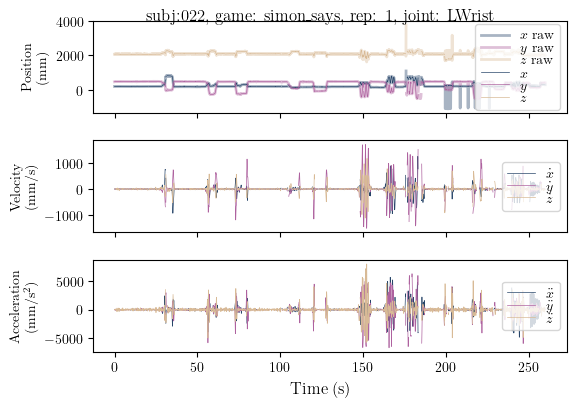

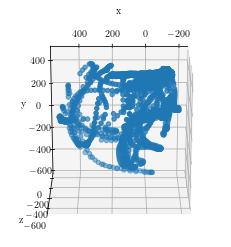

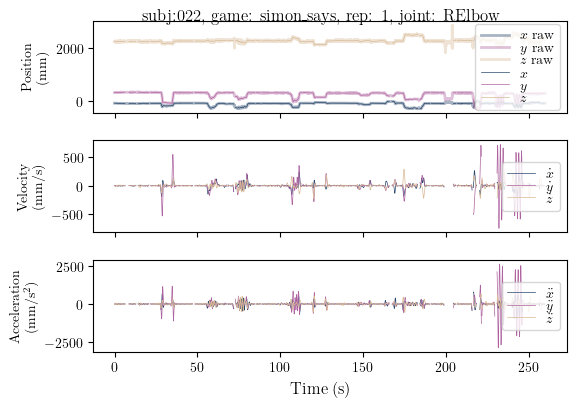

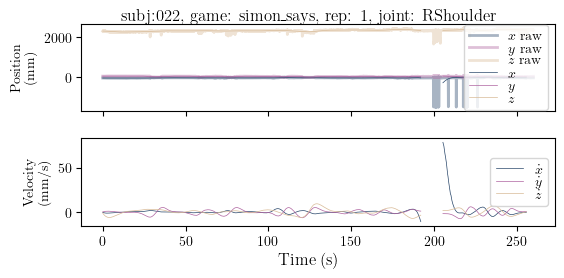

For Subj: 022:
R Arm bbt: -1.05681818181818; age: 64; norm convex hull: 0.5592783164527182; arm length: 517.0037636133102


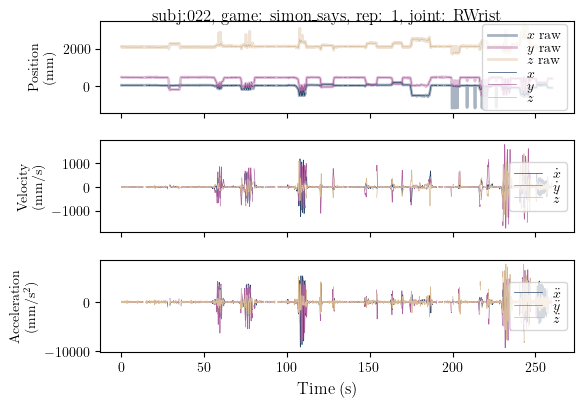

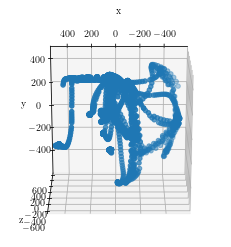

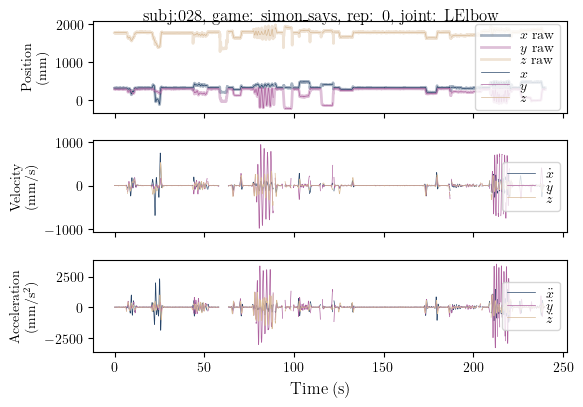

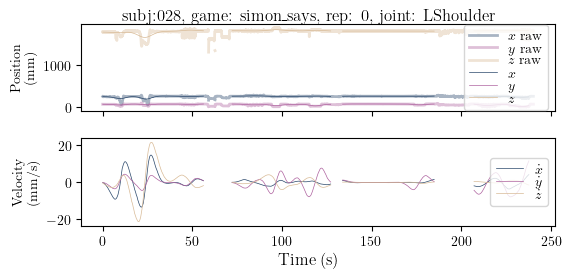

For Subj: 028:
L Arm bbt: -5.56; age: 49; norm convex hull: 0.5897802274881756; arm length: 454.26785701684173


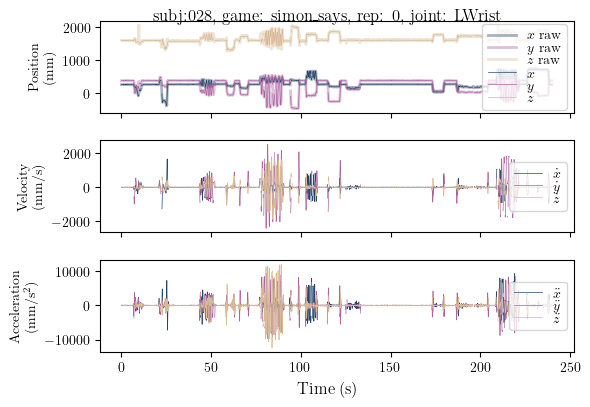

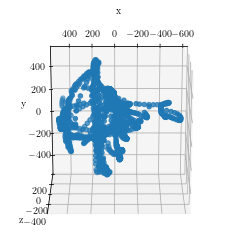

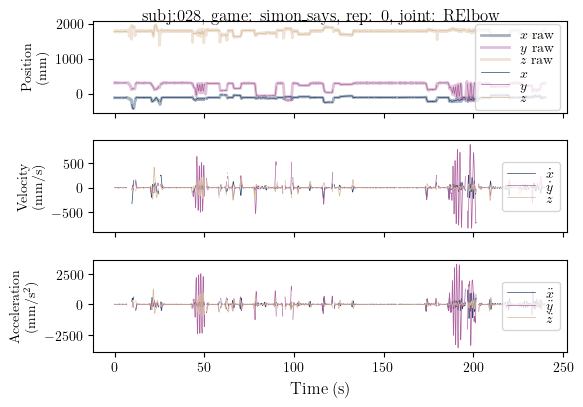

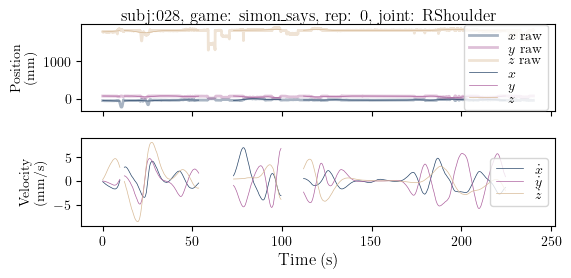

For Subj: 028:
R Arm bbt: -5.56; age: 49; norm convex hull: 0.31891544326832333; arm length: 443.00385600548464


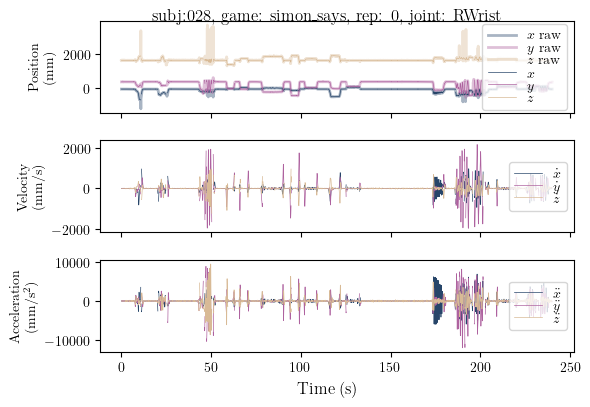

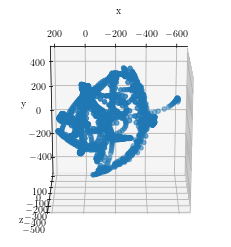

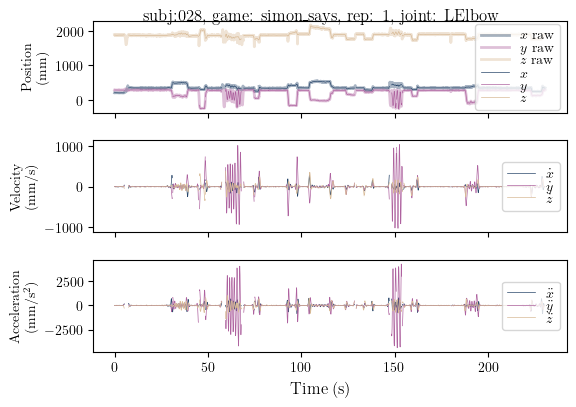

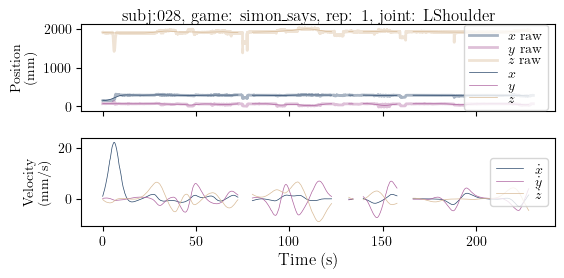

For Subj: 028:
L Arm bbt: -5.56; age: 49; norm convex hull: 0.38774974737232093; arm length: 465.210988552147


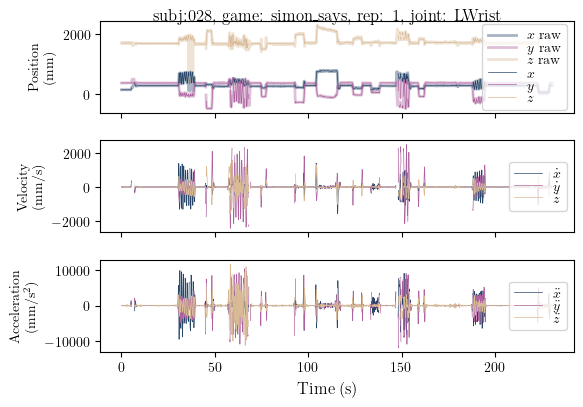

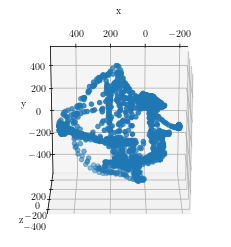

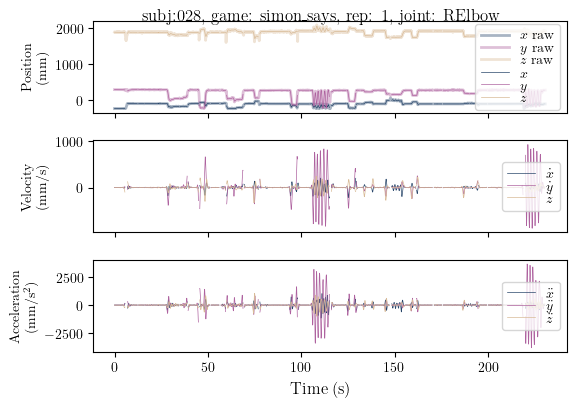

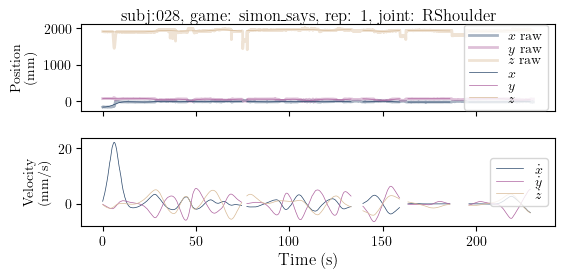

For Subj: 028:
R Arm bbt: -5.56; age: 49; norm convex hull: 0.3327448052028546; arm length: 441.54352850005444


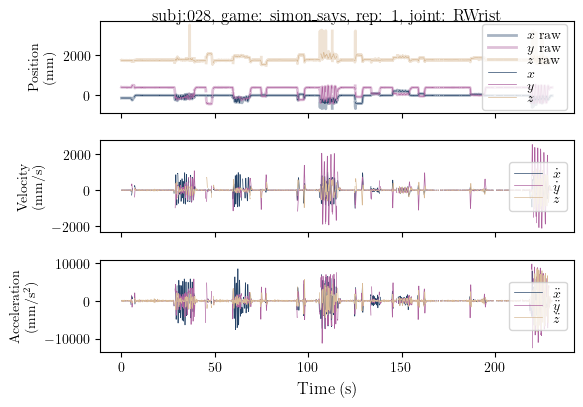

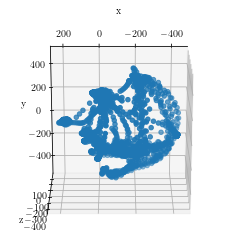

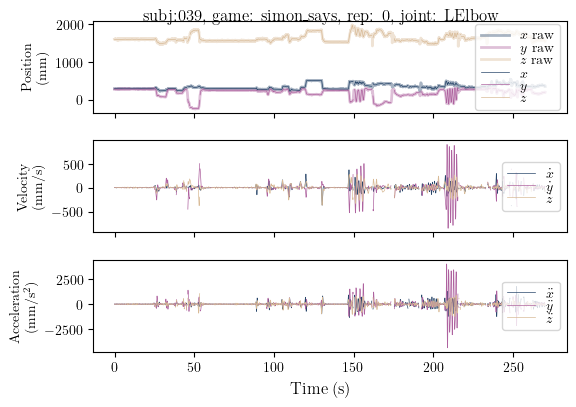

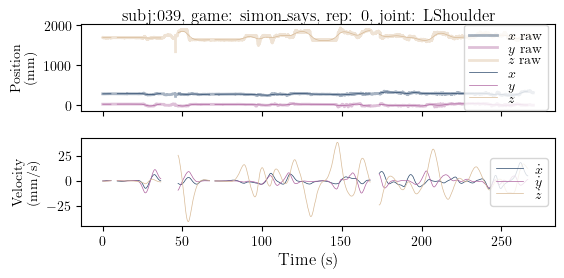

For Subj: 039:
L Arm bbt: -3.82666666666667; age: 48; norm convex hull: 0.3869094537566203; arm length: 474.2588168618764


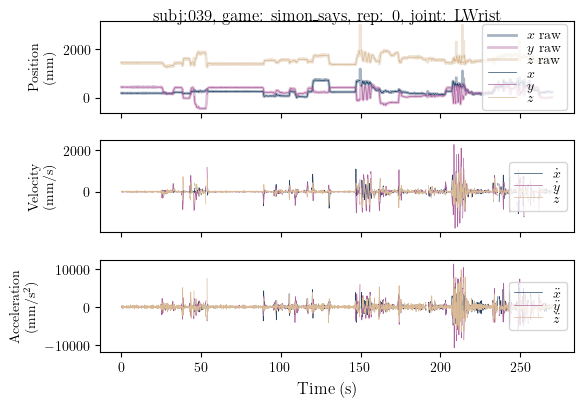

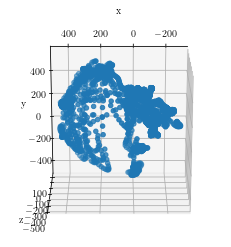

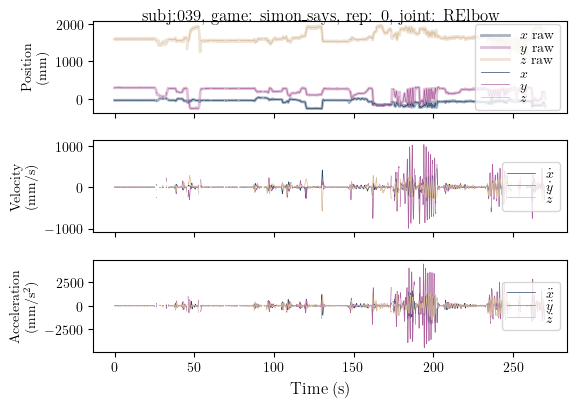

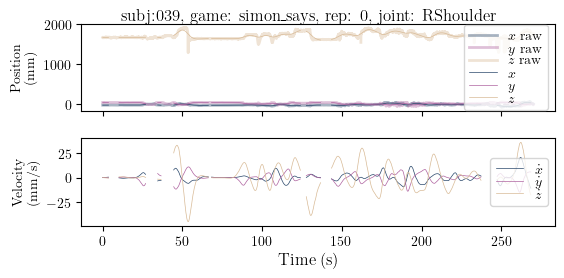

For Subj: 039:
R Arm bbt: -3.82666666666667; age: 48; norm convex hull: 0.4120369515845545; arm length: 467.3622171506169


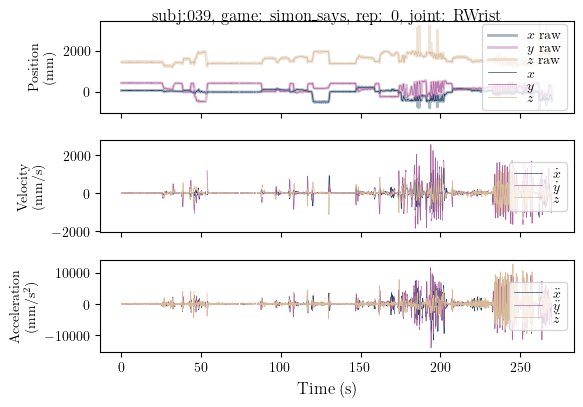

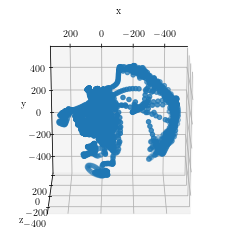

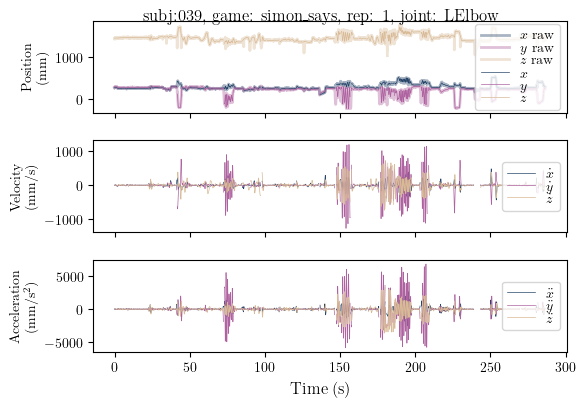

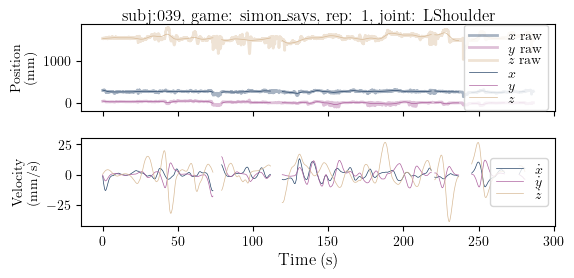

For Subj: 039:
L Arm bbt: -3.82666666666667; age: 48; norm convex hull: 0.4491888960373945; arm length: 488.7388054941538


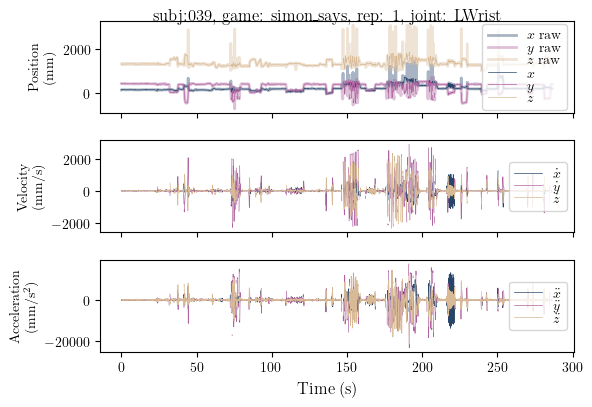

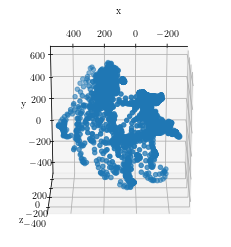

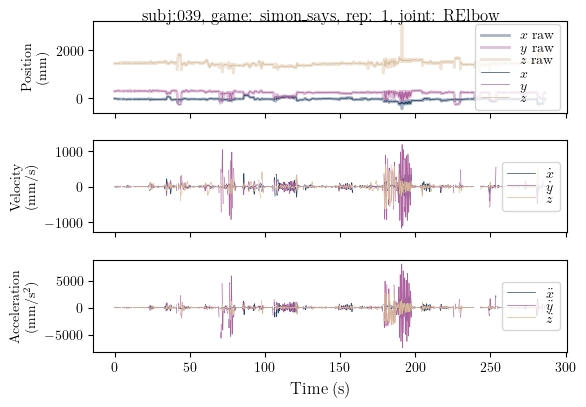

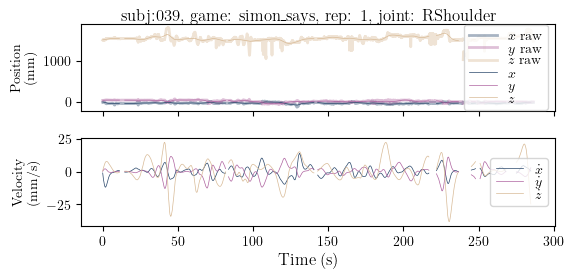

For Subj: 039:
R Arm bbt: -3.82666666666667; age: 48; norm convex hull: 0.5140716874686329; arm length: 469.6111977972175


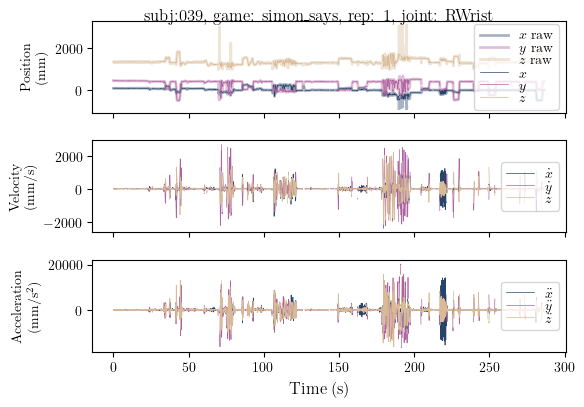

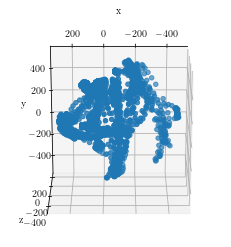

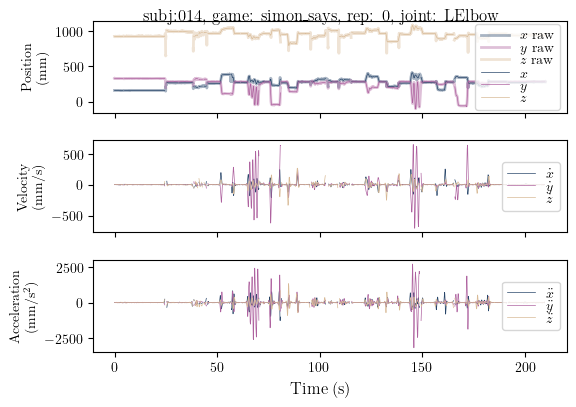

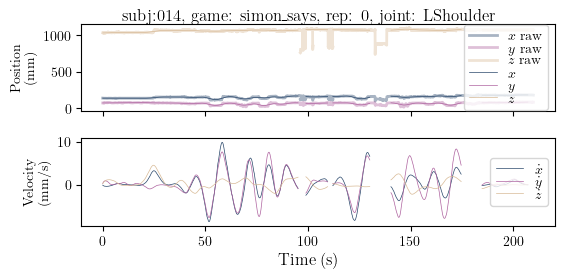

For Subj: 014:
L Arm bbt: -0.322222222222223; age: 31; norm convex hull: 43.6659405548881; arm length: 527.3314876001556


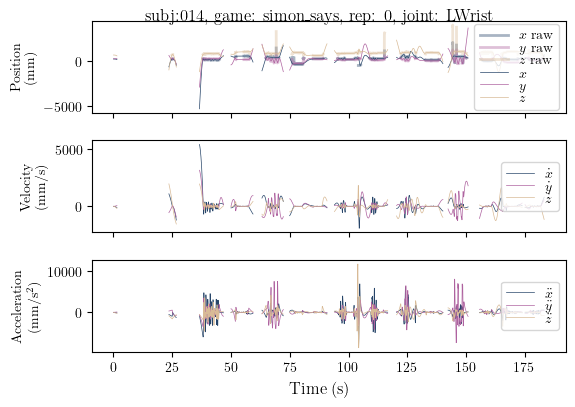

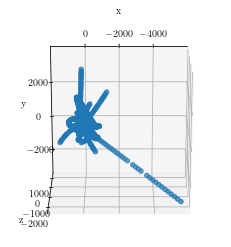

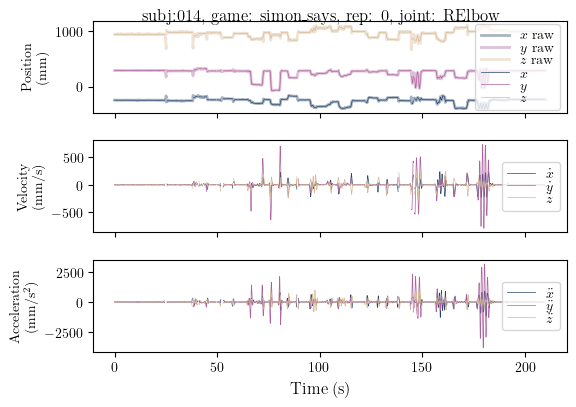

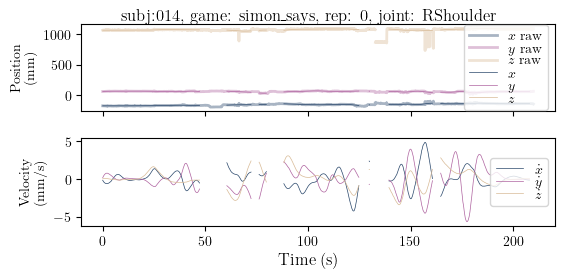

For Subj: 014:
R Arm bbt: -0.322222222222223; age: 31; norm convex hull: 154.5749187207959; arm length: 525.6126431800385


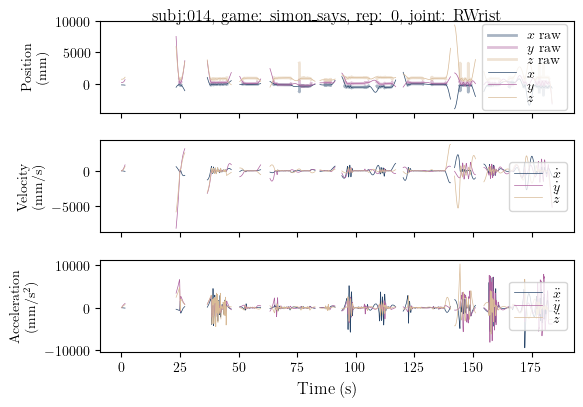

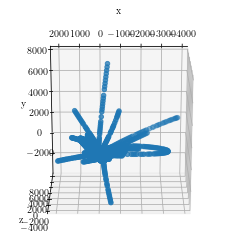

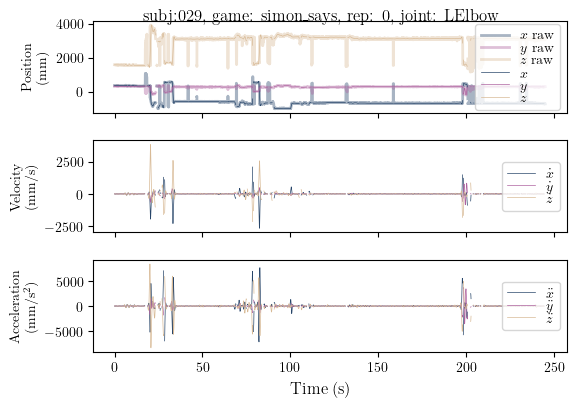

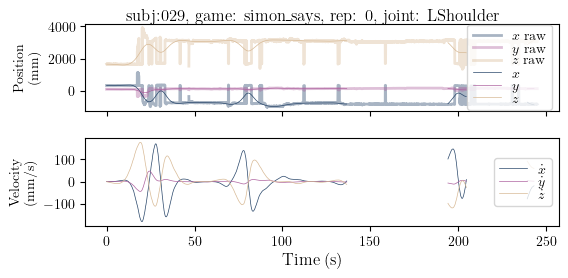

For Subj: 029:
L Arm bbt: 0.258426966292135; age: 57; norm convex hull: 1.4011314511173862; arm length: 585.6622267669875


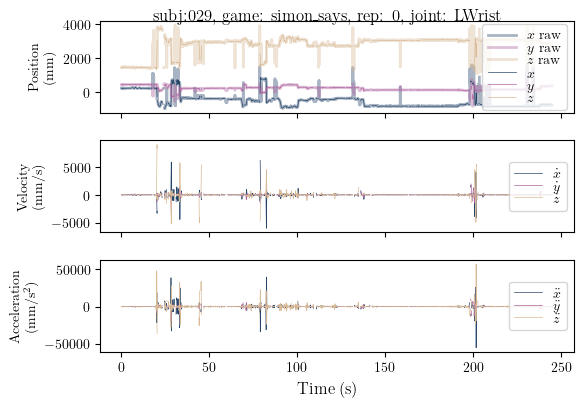

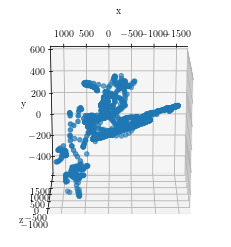

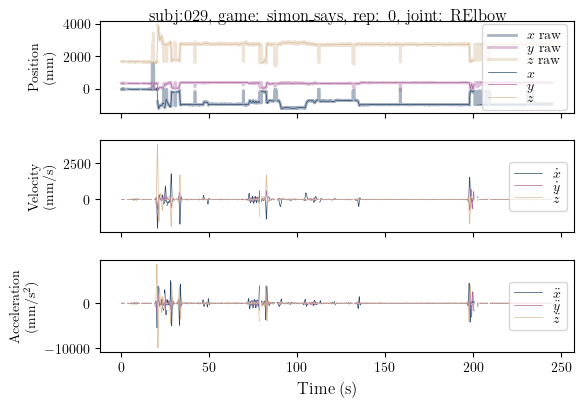

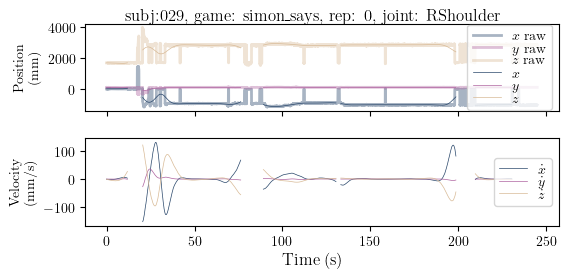

For Subj: 029:
R Arm bbt: 0.258426966292135; age: 57; norm convex hull: 0.5644571842260143; arm length: 563.5804809717358


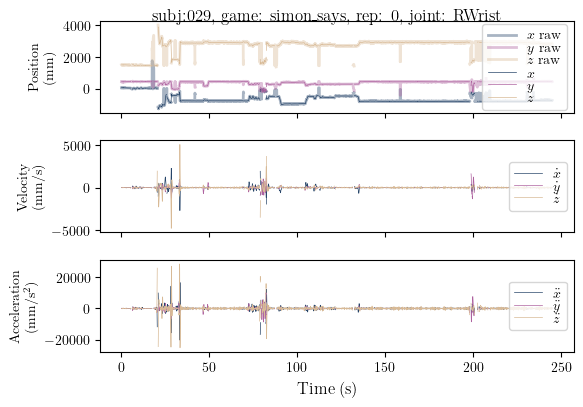

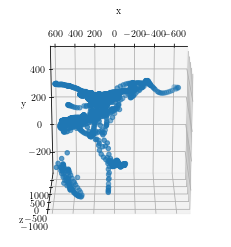

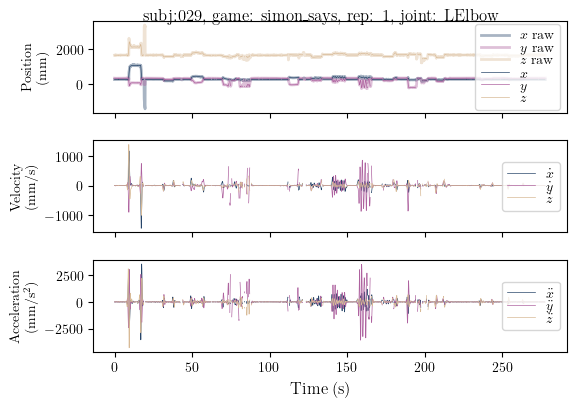

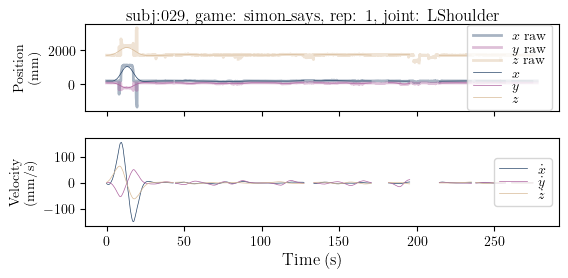

For Subj: 029:
L Arm bbt: 0.258426966292135; age: 57; norm convex hull: 0.5548834702076106; arm length: 459.2780349354231


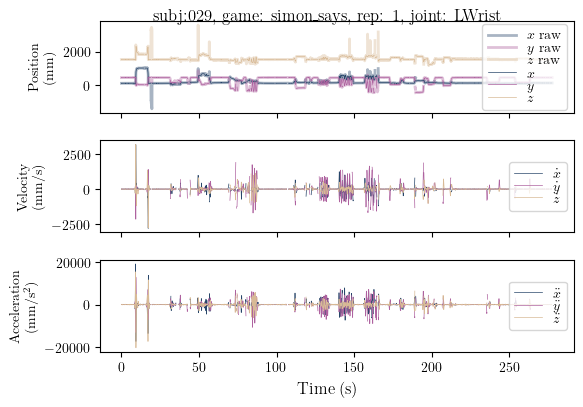

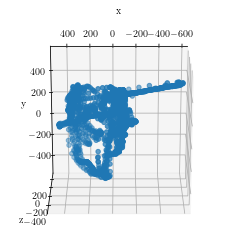

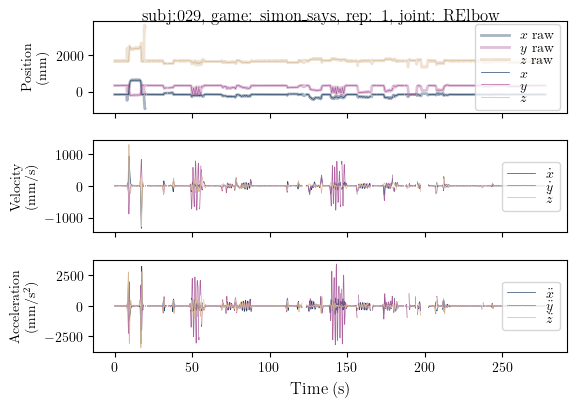

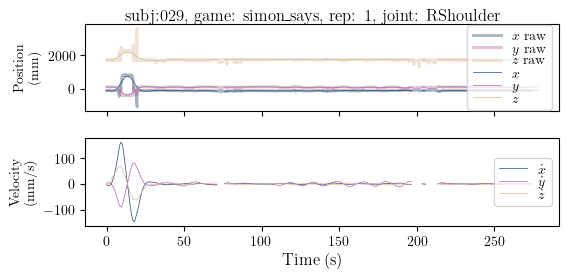

For Subj: 029:
R Arm bbt: 0.258426966292135; age: 57; norm convex hull: 0.6362645007241703; arm length: 457.4873173798153


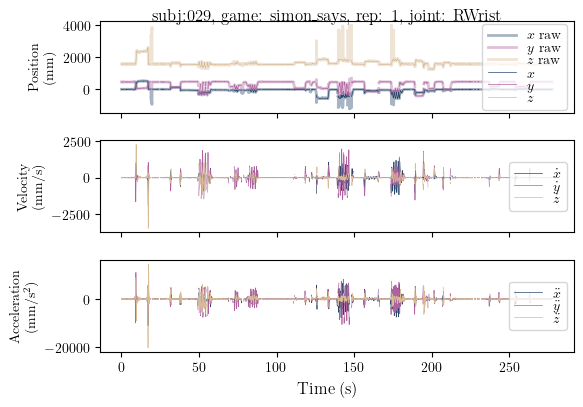

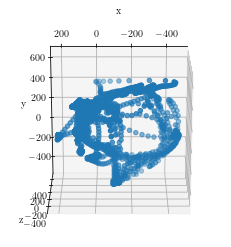

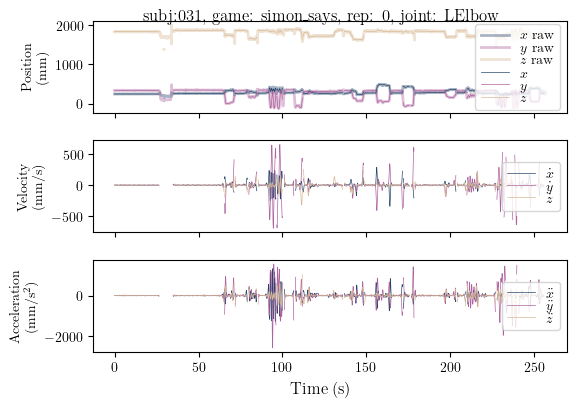

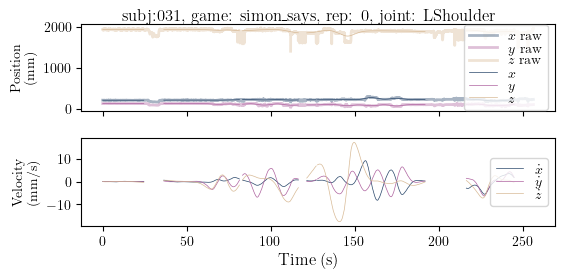

For Subj: 031:
L Arm bbt: -3.4927536231884; age: 60; norm convex hull: 0.3413687631186838; arm length: 434.46894215346975


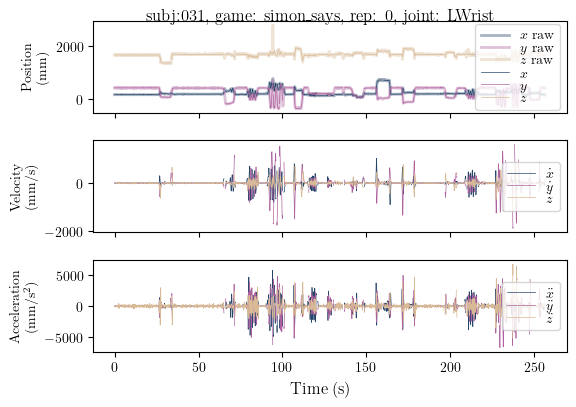

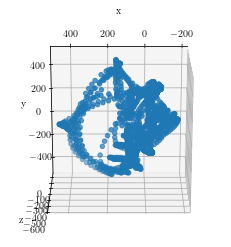

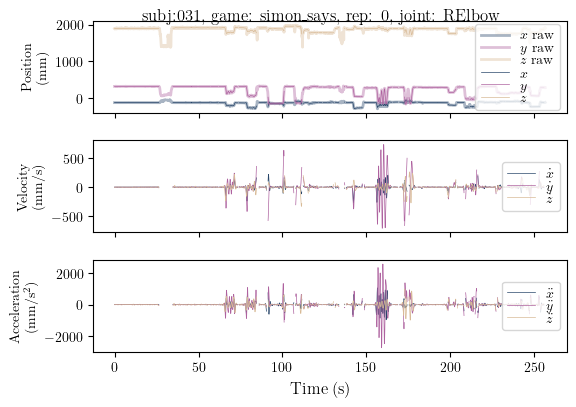

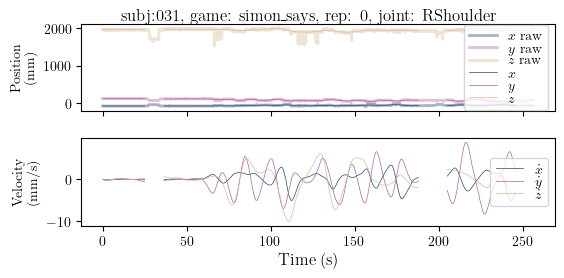

For Subj: 031:
R Arm bbt: -3.4927536231884; age: 60; norm convex hull: 0.3430074028618635; arm length: 431.5425484175697


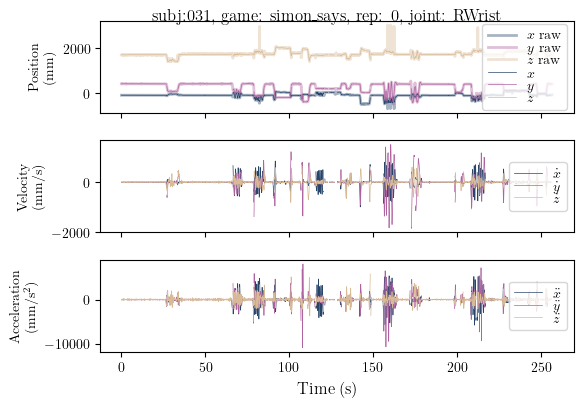

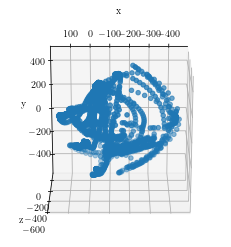

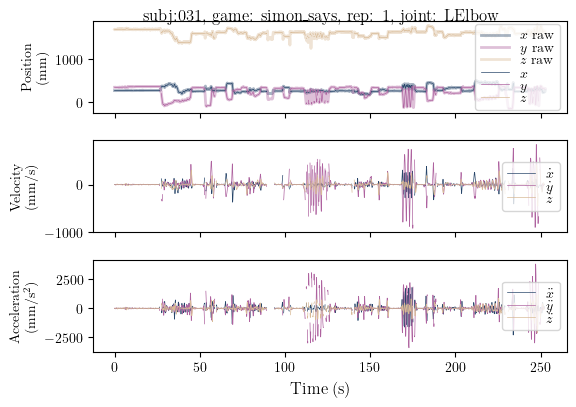

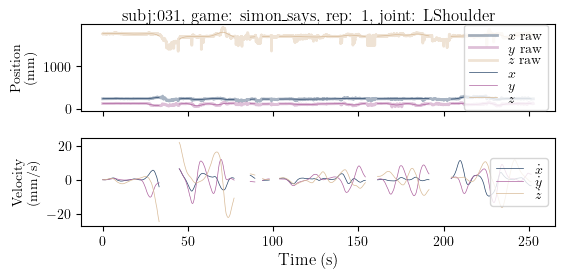

For Subj: 031:
L Arm bbt: -3.4927536231884; age: 60; norm convex hull: 0.3943589681846117; arm length: 443.5233384783906


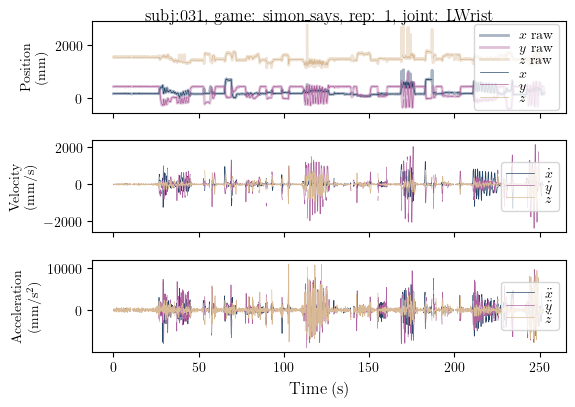

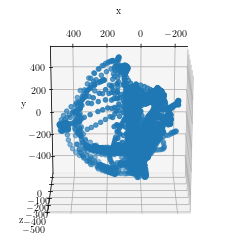

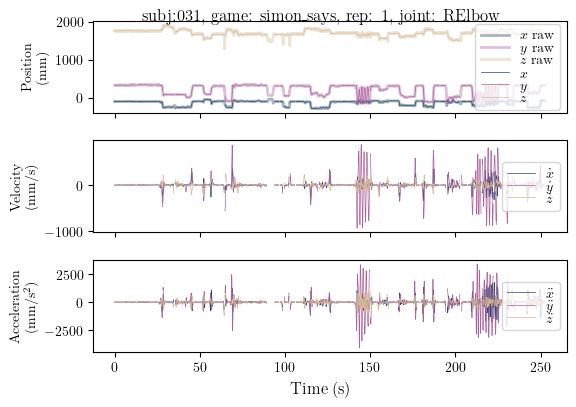

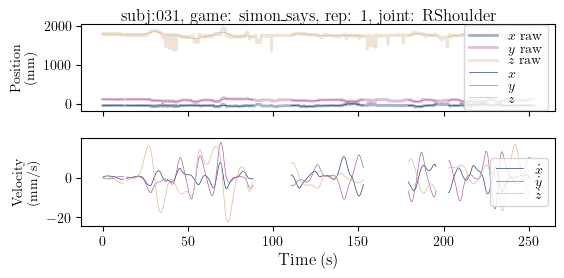

For Subj: 031:
R Arm bbt: -3.4927536231884; age: 60; norm convex hull: 0.3606320429534481; arm length: 446.33770946688236


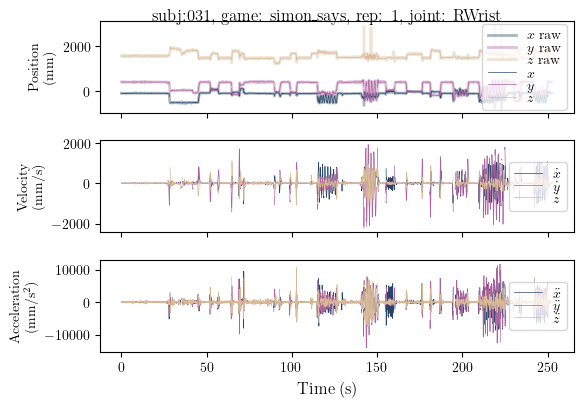

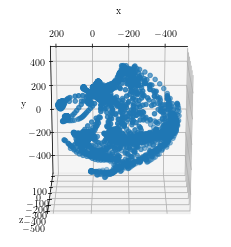

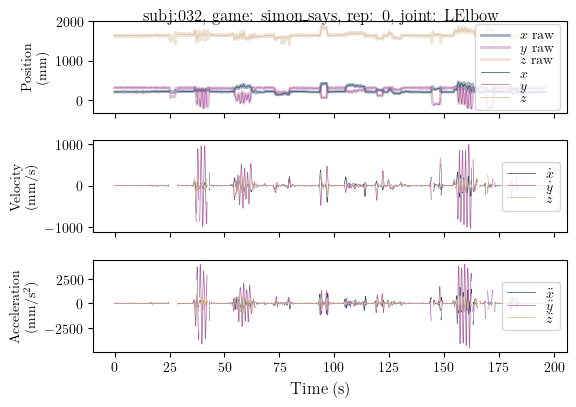

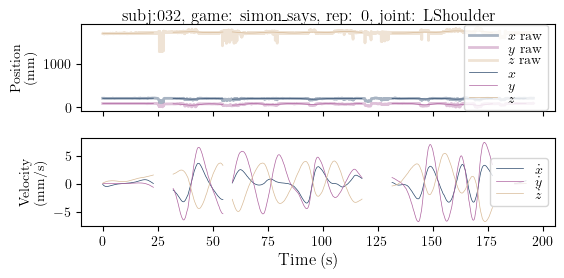

For Subj: 032:
L Arm bbt: -0.54054054054054; age: 29; norm convex hull: 0.43293100188552447; arm length: 432.8117288878783


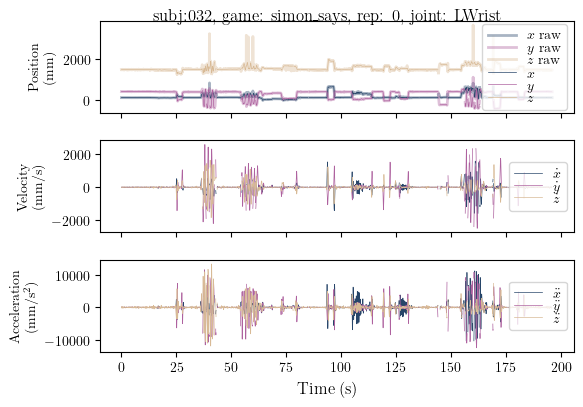

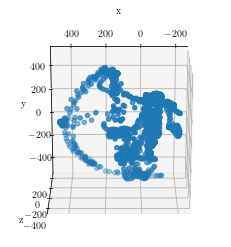

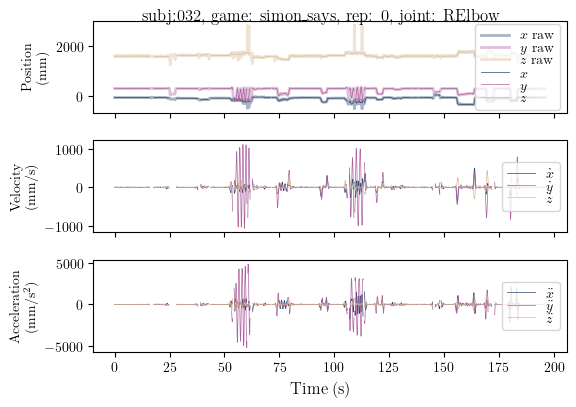

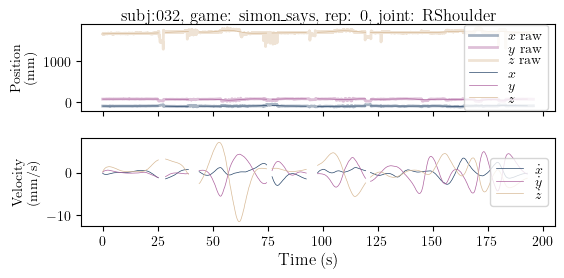

For Subj: 032:
R Arm bbt: -0.54054054054054; age: 29; norm convex hull: 0.39083867860073185; arm length: 461.04333909797276


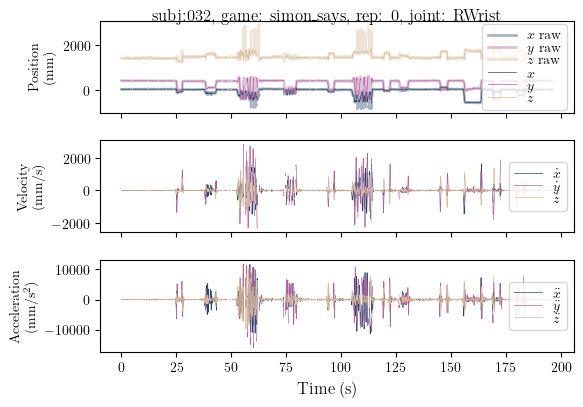

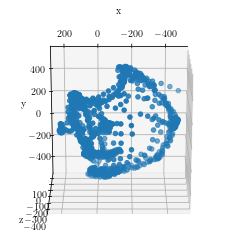

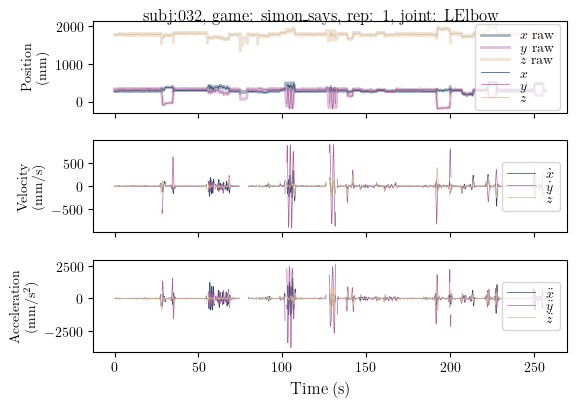

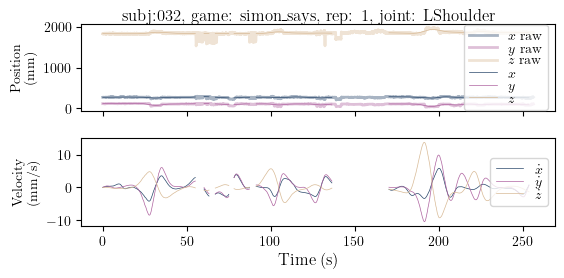

For Subj: 032:
L Arm bbt: -0.54054054054054; age: 29; norm convex hull: 0.409509989049437; arm length: 449.2824366643638


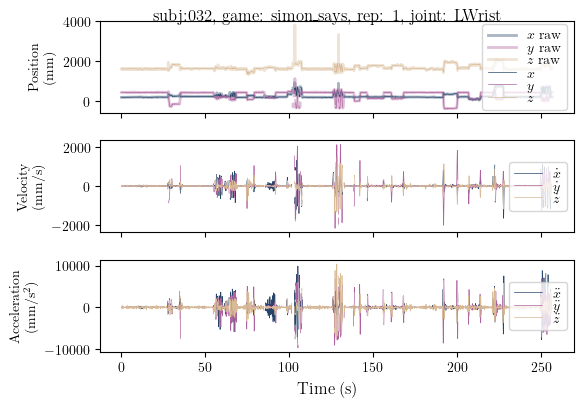

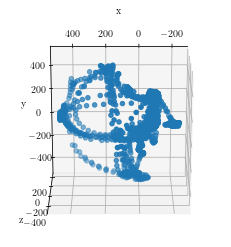

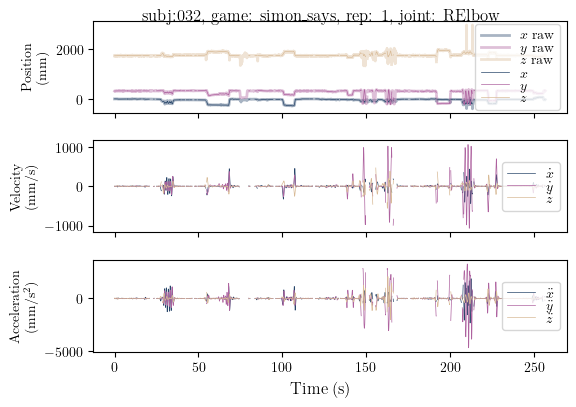

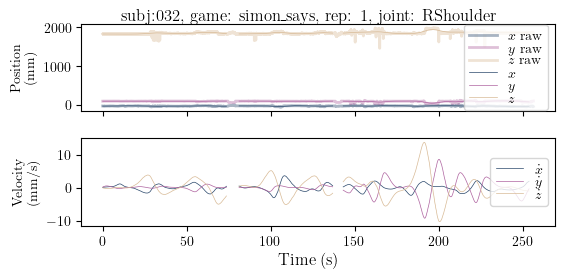

For Subj: 032:
R Arm bbt: -0.54054054054054; age: 29; norm convex hull: 0.4675745245996832; arm length: 450.2748995421128


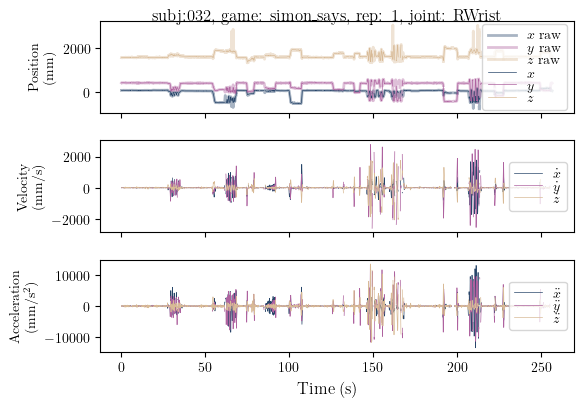

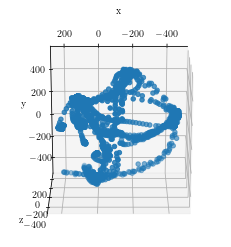

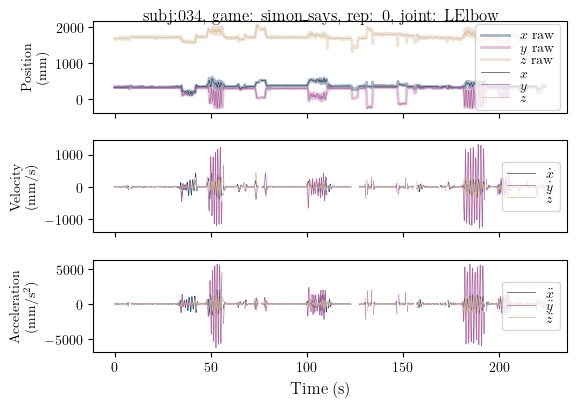

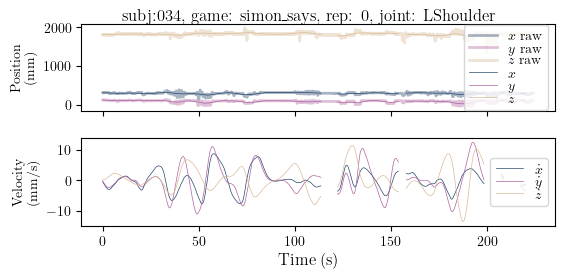

For Subj: 034:
L Arm bbt: 1.20652173913043; age: 46; norm convex hull: 0.6092571591502122; arm length: 487.0879276425193


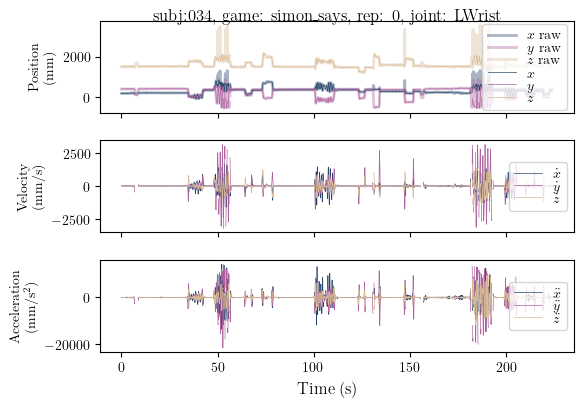

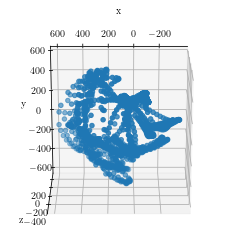

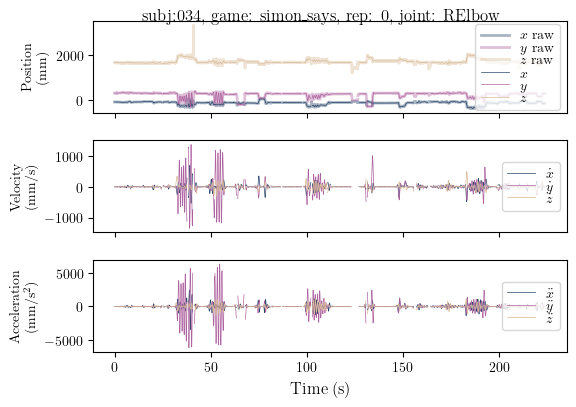

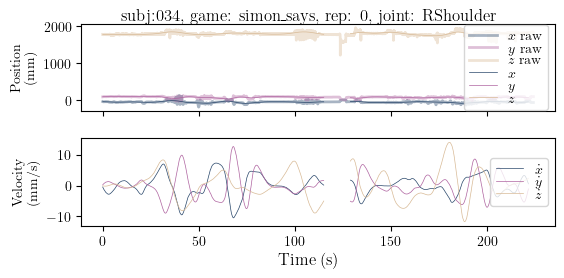

For Subj: 034:
R Arm bbt: 1.20652173913043; age: 46; norm convex hull: 0.5607333975568305; arm length: 488.0282128414716


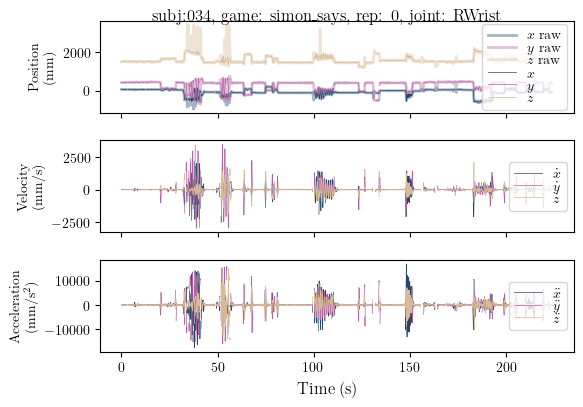

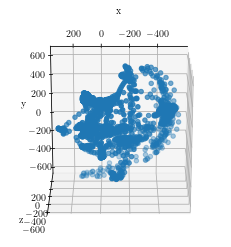

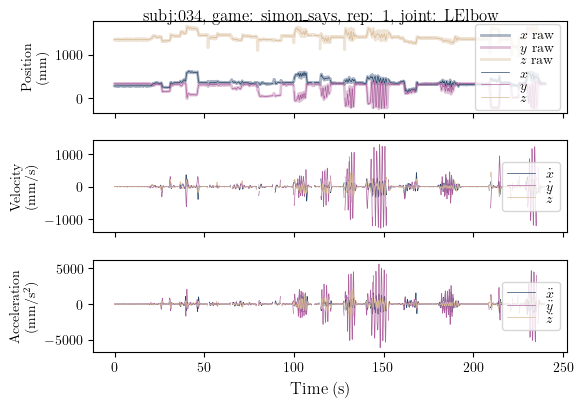

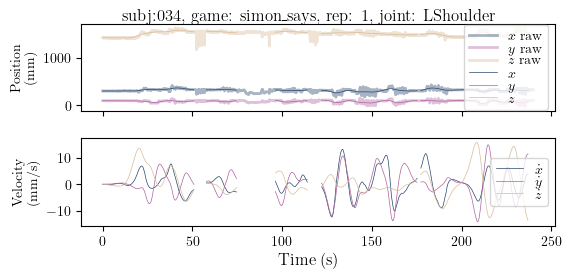

For Subj: 034:
L Arm bbt: 1.20652173913043; age: 46; norm convex hull: 0.4465374256562446; arm length: 489.56304363185706


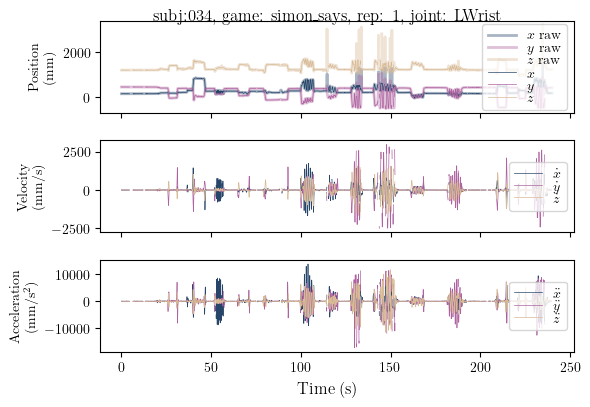

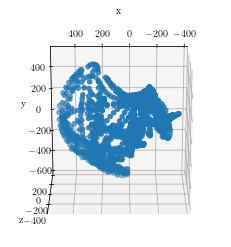

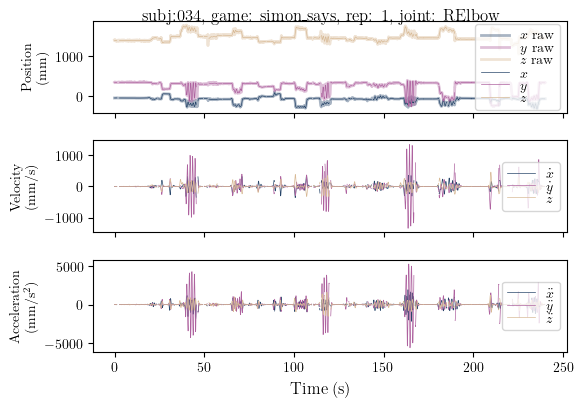

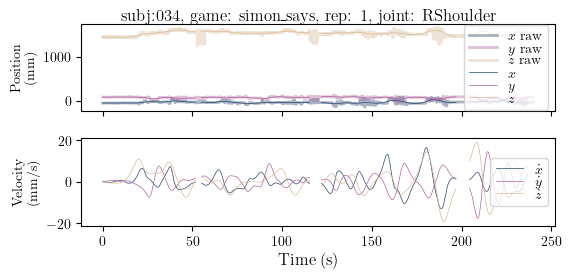

For Subj: 034:
R Arm bbt: 1.20652173913043; age: 46; norm convex hull: 0.4182717823820492; arm length: 484.0203978435311


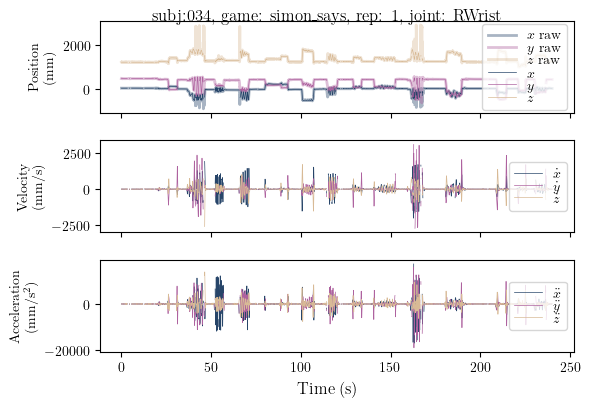

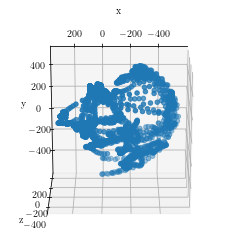

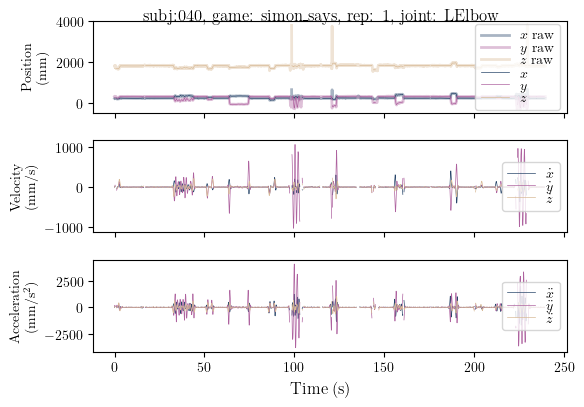

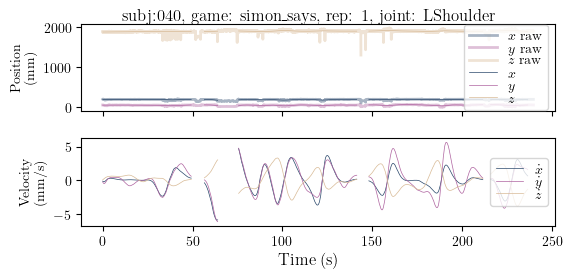

For Subj: 040:
L Arm bbt: 0.48314606741573; age: 56; norm convex hull: 0.18894647710871174; arm length: 527.9472629849548


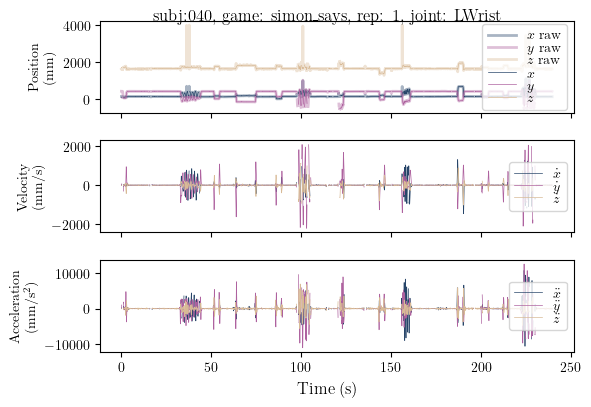

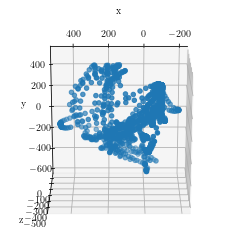

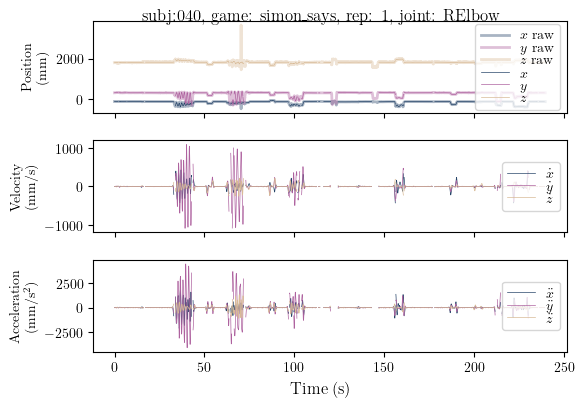

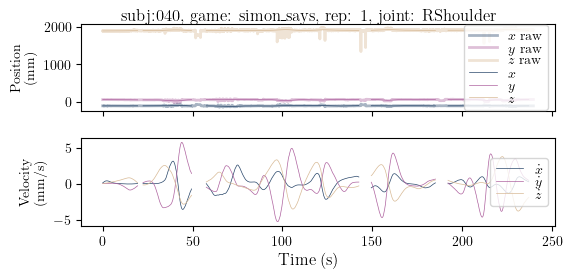

For Subj: 040:
R Arm bbt: 0.48314606741573; age: 56; norm convex hull: 0.2526224867875394; arm length: 510.22185819495115


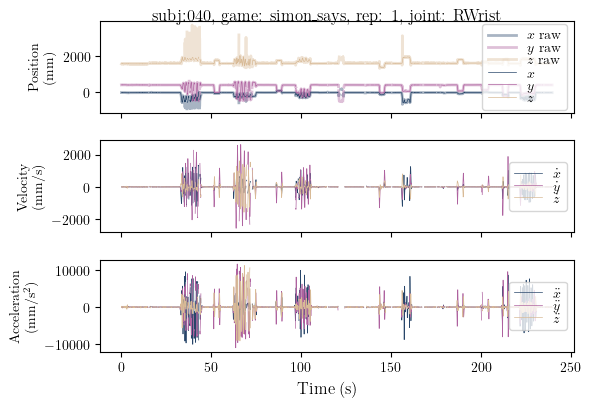

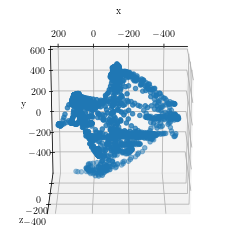

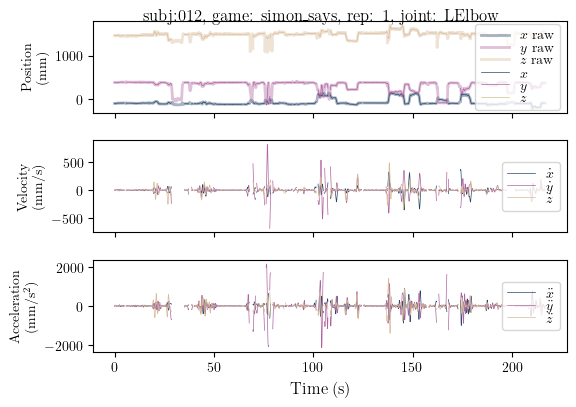

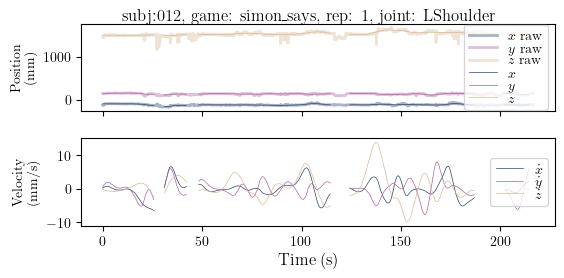

For Subj: 012:
L Arm bbt: -3.09859154929577; age: 75; norm convex hull: 0.26923291022400986; arm length: 477.40416809822113


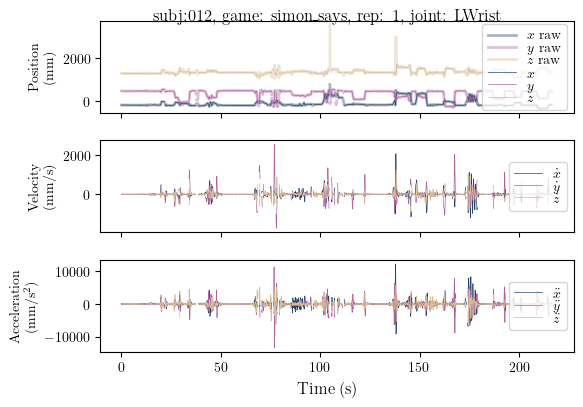

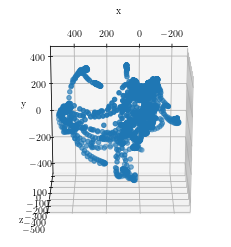

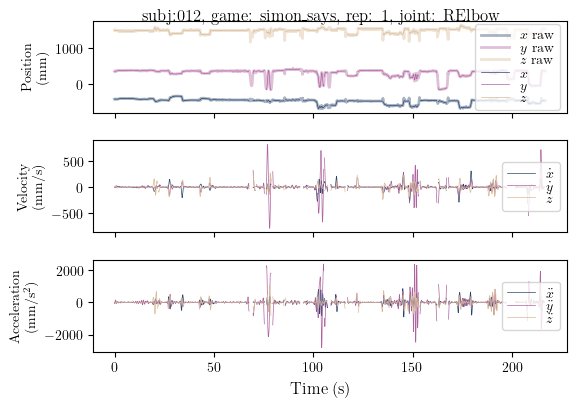

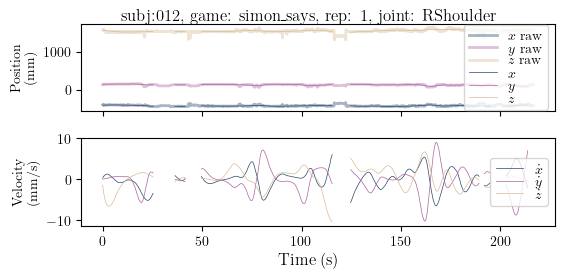

For Subj: 012:
R Arm bbt: -3.09859154929577; age: 75; norm convex hull: 0.23752075962556232; arm length: 500.4831253662453


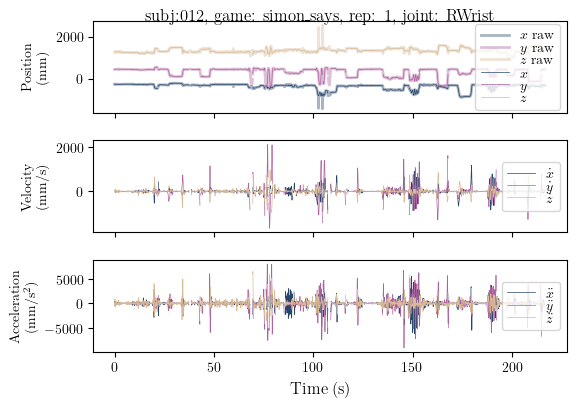

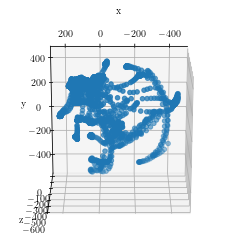

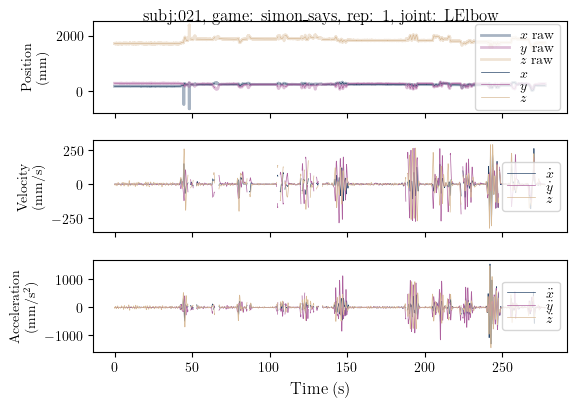

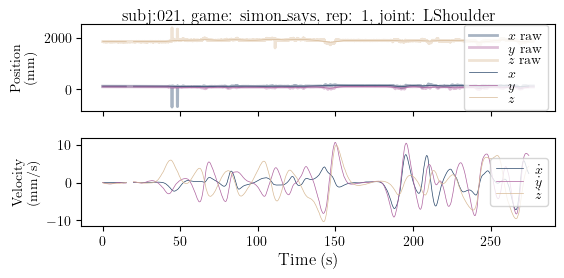

For Subj: 021:
L Arm bbt: -3.15492957746479; age: 69; norm convex hull: 0.059338031434641156; arm length: 435.7899008977464


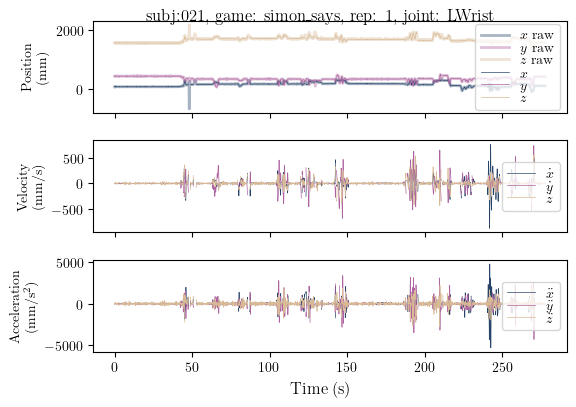

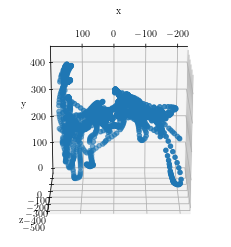

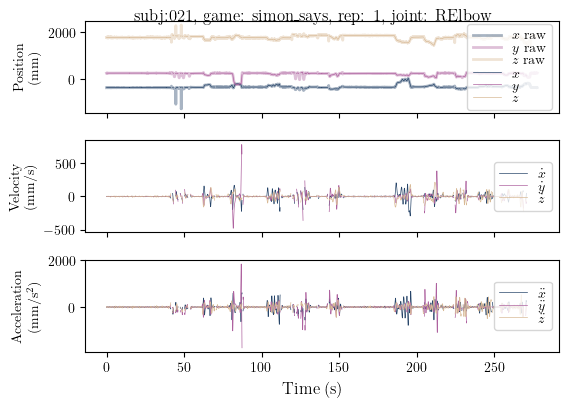

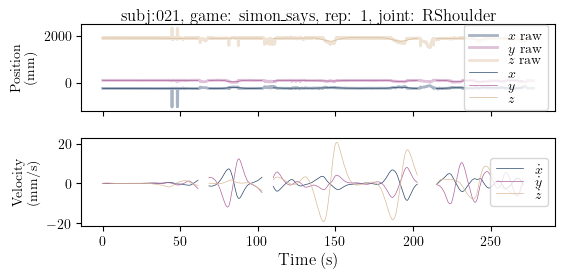

For Subj: 021:
R Arm bbt: -3.15492957746479; age: 69; norm convex hull: 0.3162208348411023; arm length: 430.3102892294509


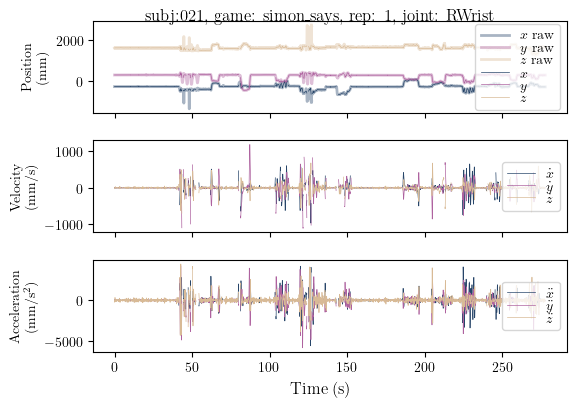

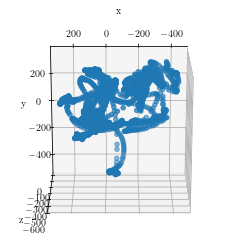

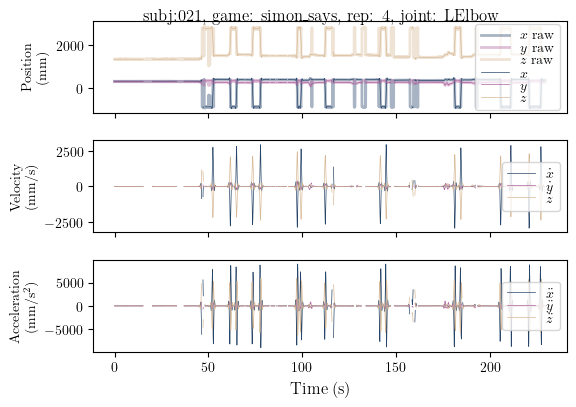

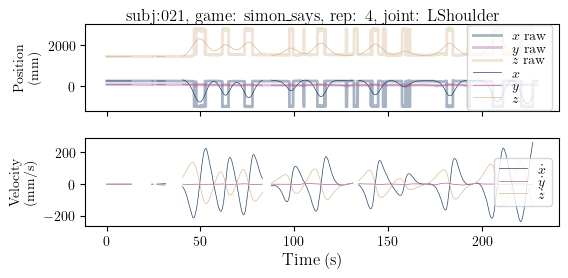

For Subj: 021:
L Arm bbt: -3.15492957746479; age: 69; norm convex hull: 0.07743012788724415; arm length: 652.6049791471439


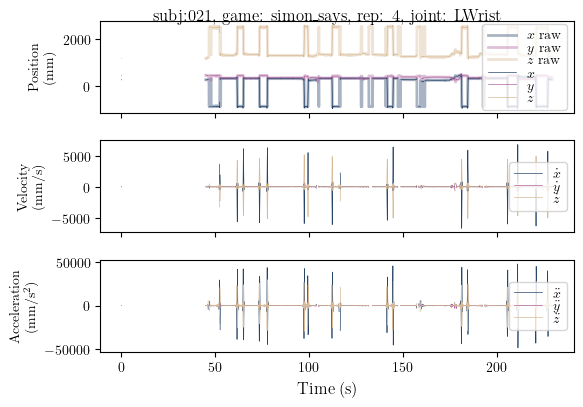

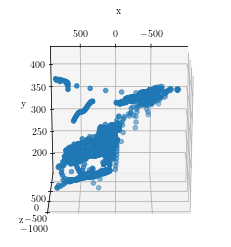

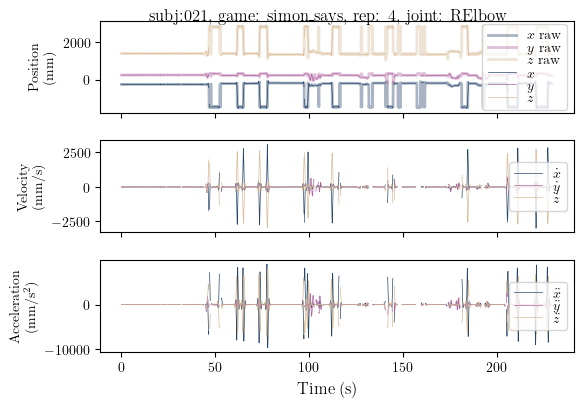

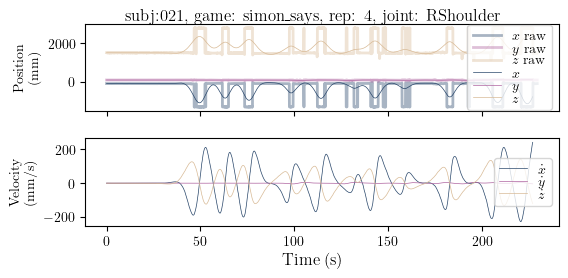

For Subj: 021:
R Arm bbt: -3.15492957746479; age: 69; norm convex hull: 0.3497027529386584; arm length: 496.03026367805484


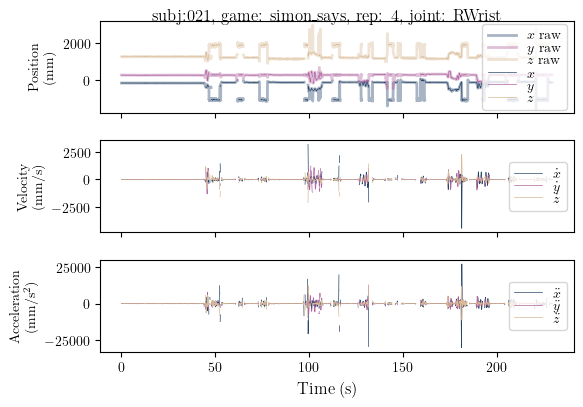

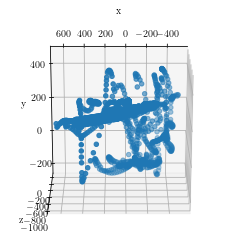

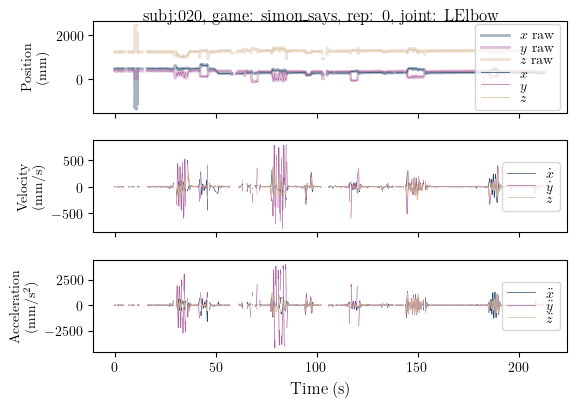

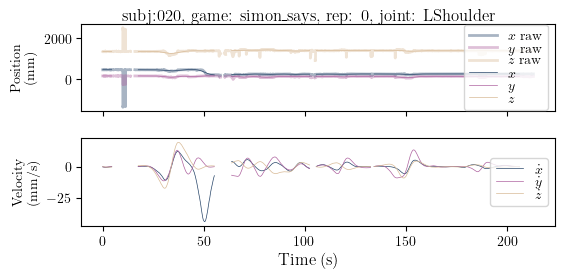

For Subj: 020:
L Arm bbt: -1.40845070422535; age: 81; norm convex hull: 0.6929171541677156; arm length: 488.39743363407524


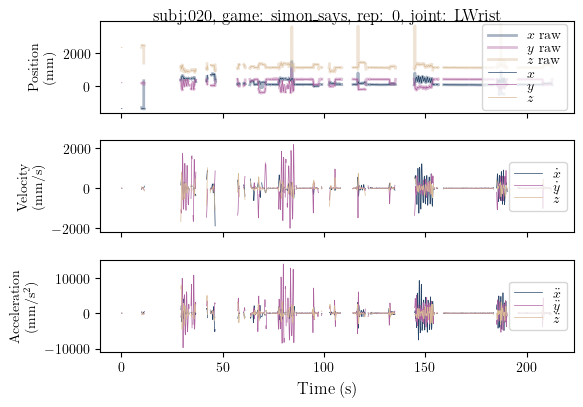

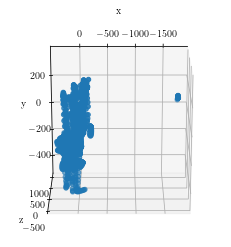

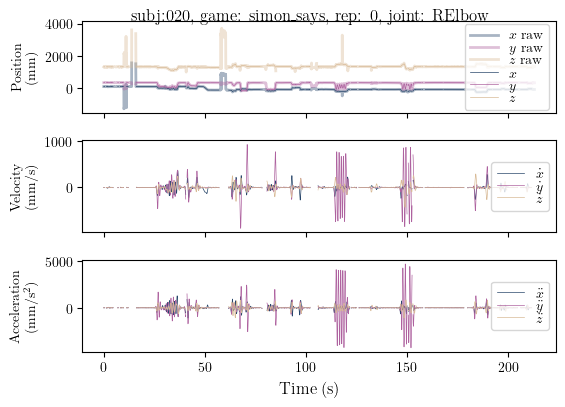

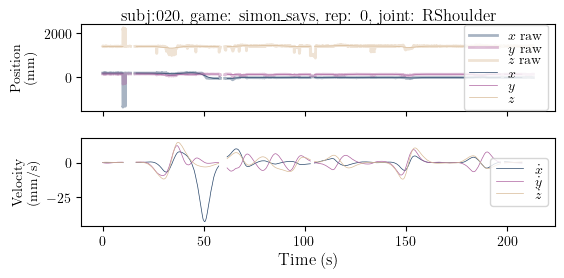

For Subj: 020:
R Arm bbt: -1.40845070422535; age: 81; norm convex hull: 0.30300864592967347; arm length: 461.42303309298904


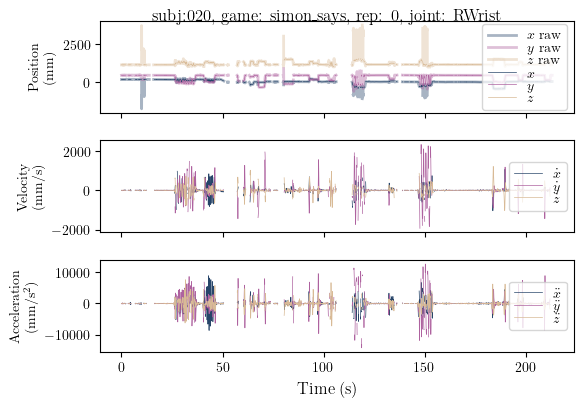

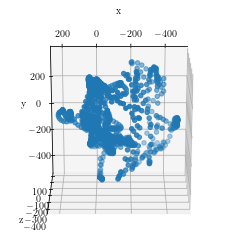

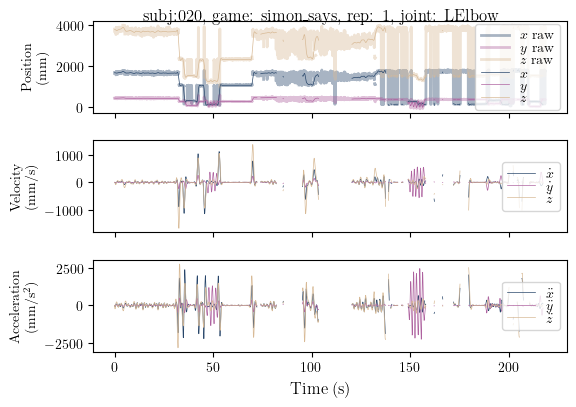

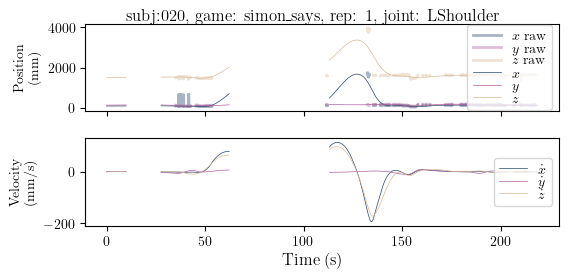

For Subj: 020:
L Arm bbt: -1.40845070422535; age: 81; norm convex hull: 0.306640008890253; arm length: 785.2490720098651


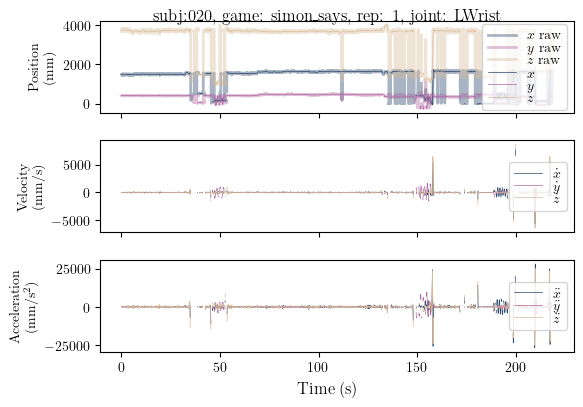

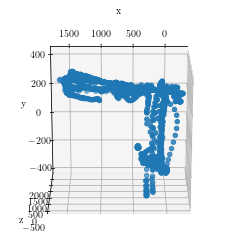

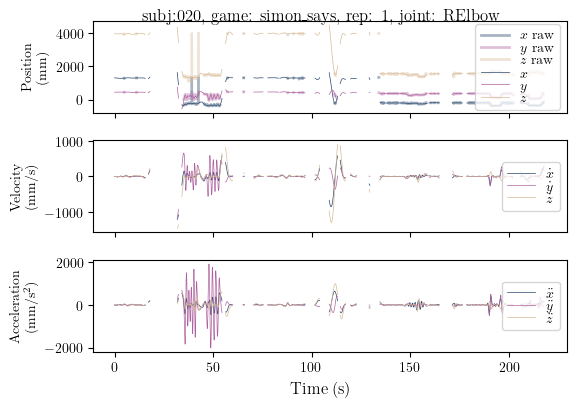

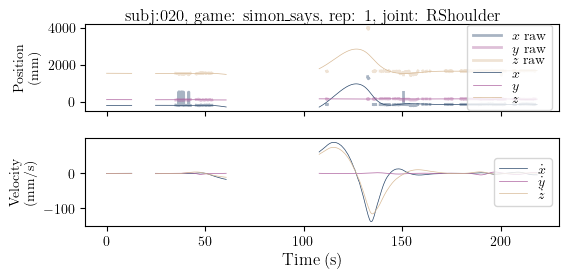

For Subj: 020:
R Arm bbt: -1.40845070422535; age: 81; norm convex hull: 1.061449318835207; arm length: 545.2957708471052


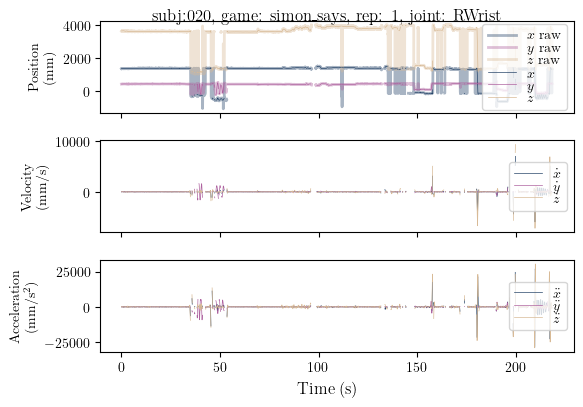

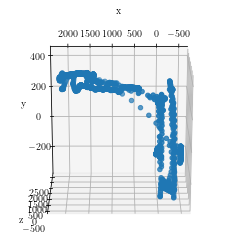

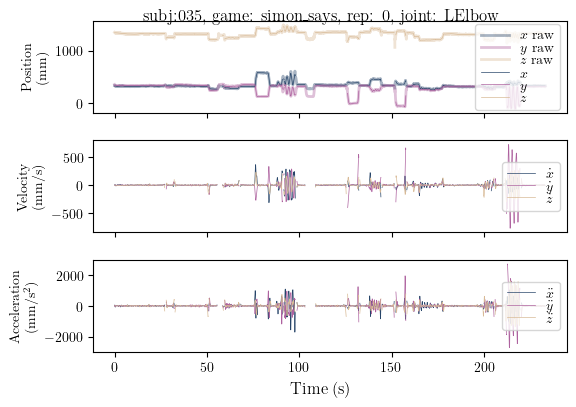

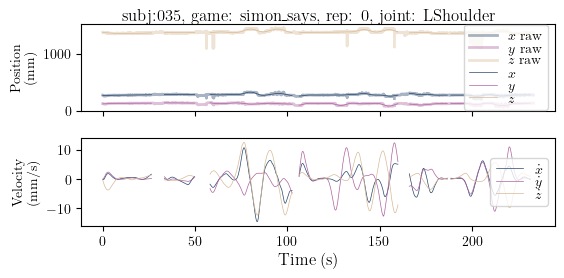

For Subj: 035:
L Arm bbt: -1.08571428571428; age: 70; norm convex hull: 0.28897771175192155; arm length: 392.22789645615876


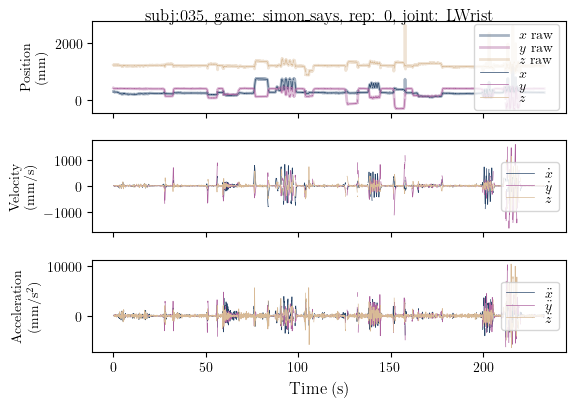

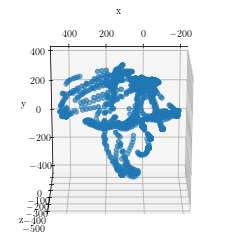

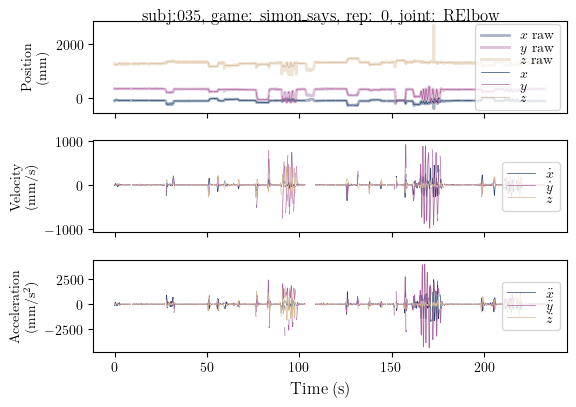

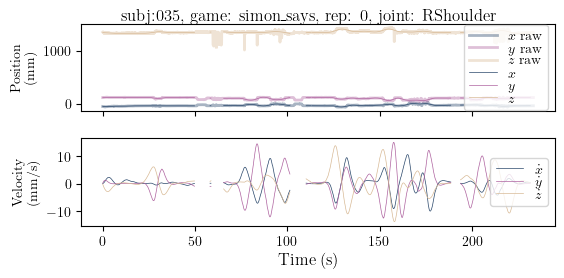

For Subj: 035:
R Arm bbt: -1.08571428571428; age: 70; norm convex hull: 0.4001857639462569; arm length: 424.70599619068776


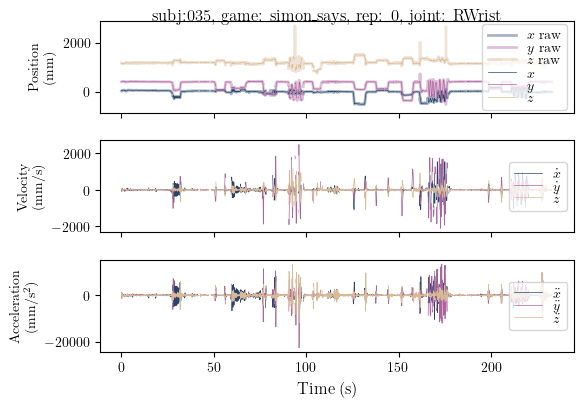

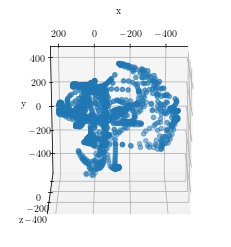

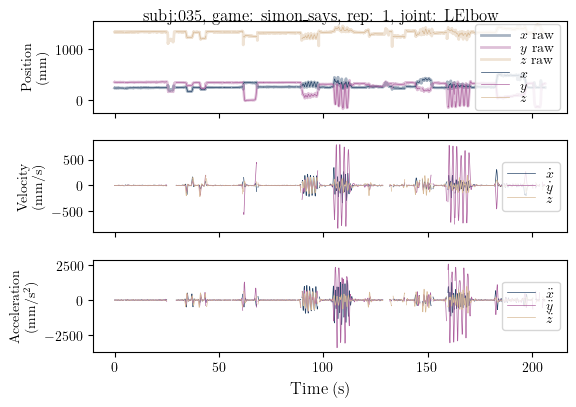

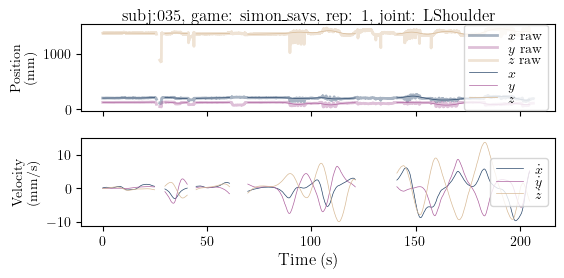

For Subj: 035:
L Arm bbt: -1.08571428571428; age: 70; norm convex hull: 0.31304311096593884; arm length: 399.0700869603318


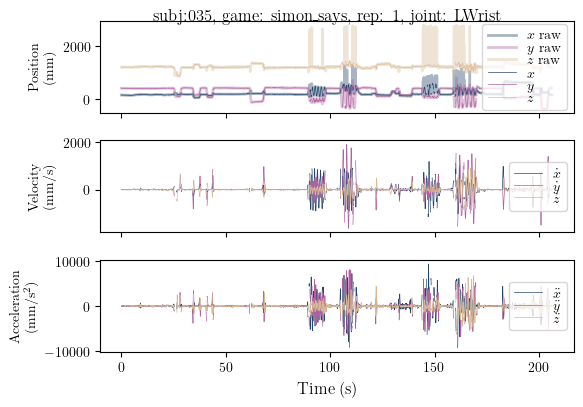

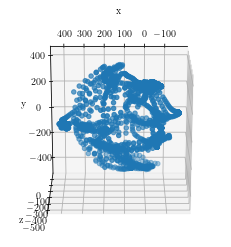

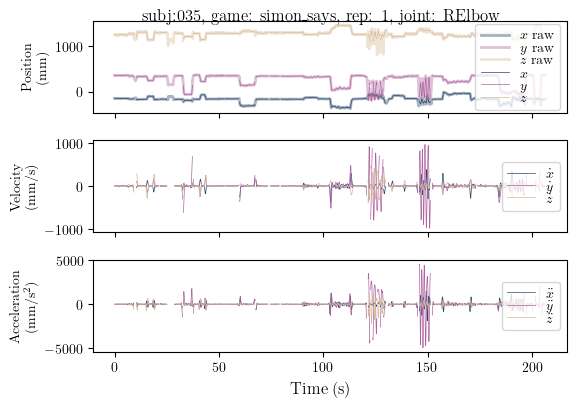

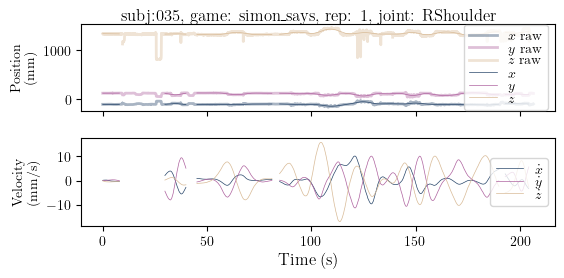

For Subj: 035:
R Arm bbt: -1.08571428571428; age: 70; norm convex hull: 0.38563609836115115; arm length: 438.73556337208015


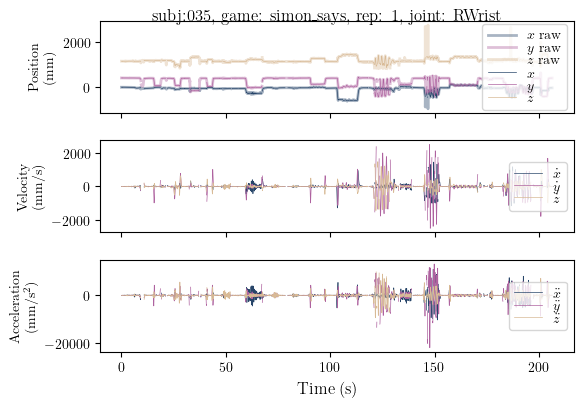

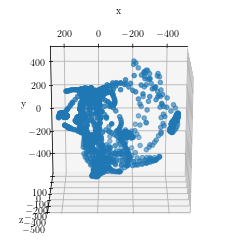

In [6]:
threshold=5
for subj in [f'0{id}' for id in train['record_id']]:
    for game_name in hdf5_file[subj]:
        if not game_name=='simon_says':
            continue
        games=hdf5_file[subj][game_name]
        for rep in games:
            game_rep=games[rep]
            if 'smooth' in game_rep:
                for joint in game_rep['smooth']:
                    # we only really want to filter by position variance
                    low_conf_values=arm_length.filter_by_variance(game_rep['covariance'][joint][:,:3,:3])
                    masked_data=np.ma.array(game_rep['smooth'][joint])
                    masked_data[low_conf_values]=np.ma.masked
                    plotting.plot_model_results(game_rep['time'], game_rep['raw'][joint], masked_data, title=f'subj:{subj}, game: {game_name}, rep: {rep}, joint: {joint}')
                    if 'Wrist' in joint:
                        side=joint[0]
                        shoulder_data=game_rep['smooth'][f'{side}Shoulder'][(~low_conf_values).nonzero()[0]][:,0:3]
                        wrist_data=game_rep['smooth'][f'{side}Wrist'][(~low_conf_values).nonzero()[0]][:,0:3]
                        ch=scipy.spatial.ConvexHull(wrist_data-shoulder_data)
                        arm_l = arm_length.arm_length(game_rep, side)
                        norm_ch = ch.volume/(4/3*np.pi*arm_l**3)
                        print(f'For Subj: {subj}:')
                        subj_norms=train[train["record_id"]==int(subj)]
                        print(f'{side} Arm bbt: {subj_norms["bbt.z_right"].values[0]}; age: {subj_norms["age"].values[0]}; norm convex hull: {norm_ch}; arm length: {arm_l}')
                        fig = plt.figure()
                        ax = plt.axes(projection='3d')
                        shoulder_raw=game_rep['smooth'][f'{side}Shoulder']
                        ax.scatter3D(masked_data[:,0]-shoulder_raw[:,0],masked_data[:,1]-shoulder_raw[:,1],masked_data[:,2]-shoulder_raw[:,2])
                        ax.set_xlabel('x')
                        ax.set_ylabel('y')
                        ax.set_zlabel('z')
                        ax.view_init(-70, 90)
                    plt.show()

Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring u

Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring u

Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring u

Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring u

Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring u

Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman


For Subj: 044:
L Arm bbt: -10.1698113207547; age: 7; norm convex hull: 0.4282476201929476; arm length: 411.6009659705479


Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman
Ignoring unknown font: Computer Modern Roman


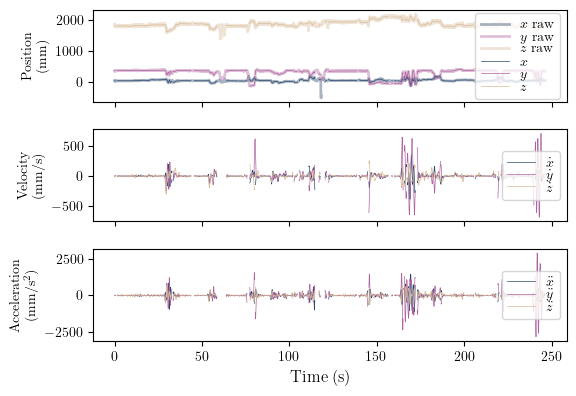

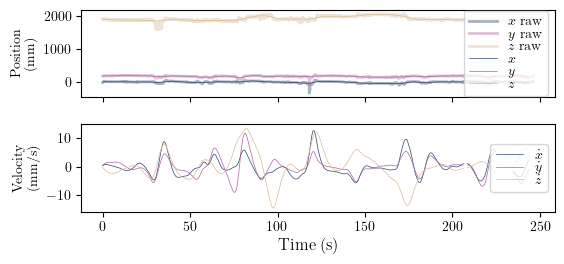

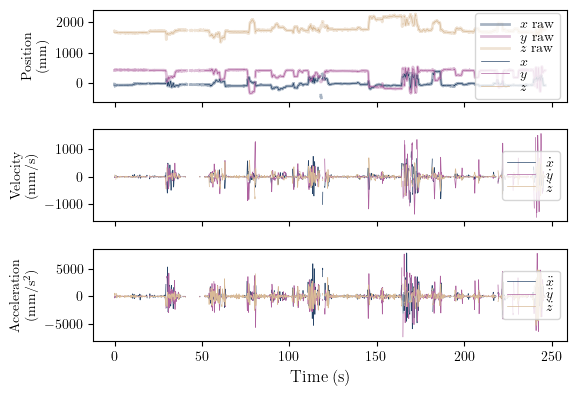

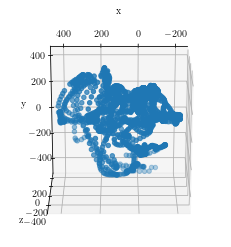

In [7]:
threshold=5
for subj in ['044']:
    for game_name in hdf5_file[subj]:
        if not game_name=='simon_says':
            continue
        games=hdf5_file[subj][game_name]
        for rep in ['0']:
            game_rep=games[rep]
            if 'smooth' in game_rep:
                for joint in ['LElbow','LShoulder','LWrist']:
                    # we only really want to filter by position variance
                    low_conf_values=arm_length.filter_by_variance(game_rep['covariance'][joint][:,:3,:3])
                    masked_data=np.ma.array(game_rep['smooth'][joint])
                    masked_data[low_conf_values]=np.ma.masked
                    plotting.plot_model_results(game_rep['time'], game_rep['raw'][joint], masked_data)
                    fn=f'{subj}-{game_name}-{rep}-{joint}'
                    plt.savefig(pathlib.Path.home()/f'Downloads/ss_plots/{fn}.pgf', format='pgf',bbox_inches="tight")
                    if 'Wrist' in joint:
                        side=joint[0]
                        shoulder_data=game_rep['smooth'][f'{side}Shoulder'][(~low_conf_values).nonzero()[0]][:,0:3]
                        wrist_data=game_rep['smooth'][f'{side}Wrist'][(~low_conf_values).nonzero()[0]][:,0:3]
                        ch=scipy.spatial.ConvexHull(wrist_data-shoulder_data)
                        arm_l = arm_length.arm_length(game_rep, side)
                        norm_ch = ch.volume/(4/3*np.pi*arm_l**3)
                        print(f'For Subj: {subj}:')
                        subj_norms=train[train["record_id"]==int(subj)]
                        print(f'{side} Arm bbt: {subj_norms["bbt.z_right"].values[0]}; age: {subj_norms["age"].values[0]}; norm convex hull: {norm_ch}; arm length: {arm_l}')
                        fig = plt.figure()
                        ax = plt.axes(projection='3d')
                        shoulder_raw=game_rep['smooth'][f'{side}Shoulder']
                        ax.scatter3D(masked_data[:,0]-shoulder_raw[:,0],masked_data[:,1]-shoulder_raw[:,1],masked_data[:,2]-shoulder_raw[:,2])
                        ax.set_xlabel('x')
                        ax.set_ylabel('y')
                        ax.set_zlabel('z')
                        ax.view_init(-70, 90)
                        plt.savefig(pathlib.Path.home()/f'Downloads/ss_plots/{fn}-3d.pgf', format='pgf',bbox_inches="tight")
